In [1]:
import wfdb
import os
import glob
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, find_peaks
from sklearn.decomposition import FastICA
from scipy.interpolate import RectBivariateSpline
from scipy import interpolate
from scipy.ndimage import gaussian_filter
from scipy.optimize import curve_fit
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import normalize
import matplotlib.animation as animation
import matplotlib.cm as cm
from IPython.display import HTML
# from google.colab import files
from pyclustering.cluster.gmeans import gmeans
from pyclustering.cluster.xmeans import xmeans
from pyclustering.cluster.center_initializer import kmeans_plusplus_initializer
from pyclustering.utils.metric import type_metric, distance_metric
from sklearn.svm import SVC
import itertools
import warnings
np.warnings = warnings

# ここから

In [2]:
# ガウス関数定義
def gaussian_2d(coord, A, x0, y0, sigma_x, sigma_y, theta, offset):
    x, y = coord #coord[:, 0], coord[:, 1]
    a = (np.cos(theta)**2) / (2*sigma_x**2) + (np.sin(theta)**2) / (2*sigma_y**2)
    b = -(np.sin(2*theta)) / (4*sigma_x**2) + (np.sin(2*theta)) / (4*sigma_y**2)
    c = (np.sin(theta)**2) / (2*sigma_x**2) + (np.cos(theta)**2) / (2*sigma_y**2)
    return A * np.exp(-(a*(x - x0)**2 + 2*b*(x - x0)*(y - y0) + c*(y - y0)**2)) + offset

In [3]:
def waveform_length(signal):
    return np.sum(np.abs(np.diff(signal, axis=0)), axis=0)

def ptp(signal):
    return np.ptp(signal, axis=0)

def arv(signal):
    return np.mean(np.abs(signal), axis=0)

def rms(signal):
    return np.sqrt(np.mean(signal**2, axis=0))

def zc(signal):
    s = np.sign(signal)
    s_prev = s[:-1]
    s_next = s[1:]
    sign_change = (s_prev * s_next) < 0
    return np.sum(sign_change, axis=0)

In [4]:
def get_centers_directions(emg_data, curve, feature_func, fs=2000, window_ms=25, threshold=0):
  # ---------- パラメータ設定 ----------
  emg_data = emg_data  # shape: (n_samples, n_channels)
  curve = curve  # 近似曲面
  feature_func = feature_func  # 特徴量抽出関数
  fs = fs  # サンプリング周波数
  window_ms = window_ms    # ウィンドウ幅 [ms]
  window_size = int(fs * (window_ms / 1000))  # サンプル数に変換
  threshold = threshold   # featureの最大 - 平均がこの値以上なら採用
  half_win = window_size // 2

  # ---------- 出力先 ----------
  valid_indices = []

  # ---------- 64チャネルすべてに対してピーク検出 ----------
  peak_mask = np.zeros(emg_data.shape[0], dtype=bool)

  for ch in range(64):
      rms_signal = np.sqrt(emg_data[:,ch]**2)
      peaks, _ = find_peaks(rms_signal, distance=50,
                        height=np.mean(rms_signal) + np.std(rms_signal))
      # peaks, _ = find_peaks(emg_data[:, ch], distance=window_size//2, height=np.std(emg_data[:,ch]) * 1)
      peak_mask[peaks] = True  # どこか1チャネルでもピークがあればTrue

  # ---------- 全体でのピーク位置で条件を評価 ----------
  for t in np.where(peak_mask)[0]:
      if t - half_win < 0 or t + half_win >= emg_data.shape[0]:
          continue  # ウィンドウが境界を超えるならスキップ

      snippet = emg_data[t - half_win : t + half_win, :]  # shape: [window_size, 64]
      feature_per_ch = feature_func(snippet)  # 各チャネルのfeature
      feature_mean = np.mean(feature_per_ch)
      feature_max = np.max(feature_per_ch)

      if feature_max - feature_mean >= threshold:
          valid_indices.append(t)

  print(f"検出されたピーク数（条件を満たすもの）: {len(valid_indices)}")

  # ----- MUAP波形の切り出し -----
  snippets = []
  valid_peaks = []
  for peak in valid_indices:
      if peak - window_size//2 >= 0 and peak + window_size//2 < emg_data.shape[0]:
          snippet = emg_data[peak - window_size//2 : peak + window_size//2, :]
          snippets.append(snippet)
          valid_peaks.append(peak)

  snippets = np.array(snippets)
  valid_peaks = np.array(valid_peaks)


  # ガウス関数定義
  def gaussian_2d(coord, A, x0, y0, sigma_x, sigma_y, theta, offset):
      x, y = coord #coord[:, 0], coord[:, 1]
      a = (np.cos(theta)**2) / (2*sigma_x**2) + (np.sin(theta)**2) / (2*sigma_y**2)
      b = -(np.sin(2*theta)) / (4*sigma_x**2) + (np.sin(2*theta)) / (4*sigma_y**2)
      c = (np.sin(theta)**2) / (2*sigma_x**2) + (np.cos(theta)**2) / (2*sigma_y**2)
      return A * np.exp(-(a*(x - x0)**2 + 2*b*(x - x0)*(y - y0) + c*(y - y0)**2)) + offset

  # 座標グリッド
  x = np.arange(8)
  y = np.arange(8)
  xv, yv = np.meshgrid(x, y)
  coords = np.vstack((xv.ravel(), yv.ravel()))



  centers = []
  directions = []
  theta_1s = []
  features = []
  for snippet in snippets[:]:
    segment = snippet
    #ピーク間振幅
    feature = feature_func(segment) #shape:(64,)
    map_2d = feature.reshape(8, 8)

    # フィッティング
    max_index = np.unravel_index(np.argmax(map_2d), map_2d.shape)
    initial = [np.max(feature)-np.min(feature), max_index[0], max_index[1], 1, 1, 0, np.min(feature)]
    bounds = ([0, 0, 0, 0.1, 0.1, -np.pi/2, -np.inf],
            [np.inf, 7, 7, 5, 5, np.pi/2, np.inf])
    popt, _ = curve_fit(curve, coords, feature, p0=initial, bounds=bounds, maxfev=10000)
    A, x0, y0, sigma_x, sigma_y, theta, offset = popt #パラメータ取得
    center = (x0, y0)
    if sigma_x > sigma_y:
        theta_1 = theta
        # print('σx > σy')
    else:
      if theta >= 0:
        theta_1 = theta - np.pi/2
      else:
        theta_1 = theta + np.pi/2
      # print('σy >= σx')
    direction = (np.cos(theta_1), np.sin(theta_1))

    centers.append(center)
    directions.append(direction)
    theta_1s.append(np.degrees(theta_1))

    feature = []
    feature.append(center[0])
    feature.append(center[1])
    feature.append(np.degrees(theta_1))
    features.append(feature)

  # print(centers)
  # print(directions)
  # print(theta_1s)
  # print(f'all centers:: ave:{np.mean(centers, axis=0)}, std:{np.std(centers, axis=0)}')
  # print(f'all theta_1:: ave:{np.mean(theta_1s, axis=0)}, std:{np.std(theta_1s, axis=0)}')

  return features

In [5]:
def clustering(features, k1=4):
    # 1. 特徴ベクトルを構築
    features = np.array(features)
    results_df = pd.DataFrame(data=features, columns=['center_x', 'center_y', 'theta_deg'])

    # --- 第1段階：中心座標でクラスタリング ---
    # 特徴量：center_x, center_y
    center_features = results_df[['center_x', 'center_y']].dropna()
    k1 = k1  # 中心クラスタ数（例）
    kmeans1 = KMeans(n_clusters=k1, random_state=0)
    center_labels = kmeans1.fit_predict(center_features)

    # 結果に追加
    results_df['direction_cluster'] = -1
    results_df.loc[center_features.index, 'direction_cluster'] = center_labels




    # クラスタごとに平均・標準偏差を集計
    cluster_stats = results_df.groupby('direction_cluster').agg({
        'center_x': ['mean', 'std'],
        'center_y': ['mean', 'std'],
        'theta_deg': ['mean', 'std'],
        'direction_cluster': 'count'
    })

    # 結果をまとめ直す
    summary_df = pd.DataFrame({
        'cluster': cluster_stats.index,
        'center_x_mean': cluster_stats[('center_x', 'mean')],
        'center_x_std': cluster_stats[('center_x', 'std')],
        'center_y_mean': cluster_stats[('center_y', 'mean')],
        'center_y_std': cluster_stats[('center_y', 'std')],
        'theta_deg_mean': cluster_stats[('theta_deg', 'mean')],
        'theta_deg_std': cluster_stats[('theta_deg', 'std')],
        # 'count': results_df['cluster'].value_counts().sort_index(),
        'count': cluster_stats[('direction_cluster', 'count')]
    }).reset_index(drop=True)

    # 結果表示
    summary_df

    return results_df, summary_df

In [6]:
def get_cluster_colors(n_clusters, cmap_name='tab20'):
    cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.
    return [cmap(i) for i in range(n_clusters)]

In [67]:
def plot_fiber(results_df, arrow_scale=0.5, show_arrow=True, clustered_colar=True):
  arrow_scale = arrow_scale
  
  n_clusters = results_df['direction_cluster'].nunique()
  if clustered_colar:  
    cluster_colors = get_cluster_colors(n_clusters)
  else:
    cluster_colors = ['blue'] * n_clusters

  # プロット準備
  plt.figure(figsize=(9, 6))
  for n, center_cluster in enumerate(sorted(results_df['direction_cluster'].unique())):
    sub_df = results_df[results_df['direction_cluster'] == center_cluster]
    color = cluster_colors[n]

    for _, row in sub_df.iterrows():
          x, y = row['center_x'], row['center_y']
          theta = row['theta_deg']
          dx, dy = np.cos(np.radians(theta)) * arrow_scale, np.sin(np.radians(theta)) * arrow_scale

          # 色で中心クラスタを、マーカーサイズで方向クラスタを示す
          if show_arrow:
            plt.arrow(x, y, dx, dy, head_width=0.15, color=color, alpha=0.8)
          plt.plot(x, y, 'o', color=color,
                  label=f"Center Cl {center_cluster}" if f"Center Cl {center_cluster}" not in plt.gca().get_legend_handles_labels()[1] else "")

  # ラベル・軸
  plt.xlabel("x")
  plt.ylabel("y")
  # plt.title("2-Stage Clustering of Muscle Fiber Direction")
  plt.grid(True)
  plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
  plt.axis('equal')
  plt.tight_layout()
  plt.xlim(0, 7)
  plt.ylim(0, 7)
  plt.xticks(np.arange(0, 8, 1))
  plt.yticks(np.arange(0, 8, 1))
  plt.show()

In [8]:
def get_virtual_bipolars(results_df, ied=2, arrow_scale=0.5, show_plot=True):
  #仮想双極電極の電極間距離（cm）
  a = ied

  n_clusters = results_df['direction_cluster'].nunique() #
  cluster_colors = get_cluster_colors(n_clusters) #

  virtual_bipolars = []
  labels = []
  center_direction = []
  n_virtual_bipolars_checker = []
  if show_plot:
    plt.figure(figsize=(9, 6)) # 
  for n, direction_cluster in enumerate(sorted(results_df['direction_cluster'].unique())):
    sub_df = results_df[results_df['direction_cluster'] == direction_cluster]
    # if sub_df['center_cluster'].count() >= 20 and sub_df['center_x'].std() < 1 and sub_df['center_y'].std() < 1 and sub_df['theta_deg'].std() < 20:
    X= sub_df[['center_x','center_y']].to_numpy()
    X = X - X.mean(axis=0)
    pca = PCA(n_components=1)
    pca.fit(X)
    # print(pca.components_[0])
    eigen_x = pca.components_[0][0]
    eigen_y = pca.components_[0][1]
    if eigen_x < 0:
      eigen_x = -eigen_x
      eigen_y = -eigen_y
    elif eigen_x == 0:
      eigen_y = abs(eigen_y)
    theta = np.degrees(np.arctan2(eigen_y, eigen_x))
    x, y = sub_df['center_x'].mean(), sub_df['center_y'].mean()

    dx, dy = np.cos(np.radians(theta)) * arrow_scale, np.sin(np.radians(theta)) * arrow_scale #
    # print(f'cluster:{direction_cluster}, x={x}, y={y}, θ={theta}')
    x1 = x - a/2*np.cos(np.radians(theta))
    y1 = y - a/2*np.sin(np.radians(theta))
    x2 = x + a/2*np.cos(np.radians(theta))
    y2 = y + a/2*np.sin(np.radians(theta))
    virtual_bipolars.append([x1, y1, x2, y2])
    labels.append(direction_cluster)
    center_direction.append([x, y, theta])
    n_virtual_bipolars_checker.append(True)
    if show_plot:
      # 色で中心クラスタを、マーカーサイズで方向クラスタを示す
      color = cluster_colors[n]
      plt.arrow(x, y, dx, dy, head_width=0.15, color=color, alpha=0.8)
      plt.plot(x, y, 'o', color=color,
                label=f"Center Cl {direction_cluster}" if f"Center Cl {direction_cluster}" not in plt.gca().get_legend_handles_labels()[1] else "")
  # if len(n_virtual_bipolars_checker) == 1:
  #   virtual_bipolars.append([0,0,0,0])
  #   labels.append(999)
  #   center_direction.append([0,0,0])
  if show_plot:
    plt.xlabel("x")
    plt.ylabel("y")
    # plt.title("2-Stage Clustering of Muscle Fiber Direction")
    plt.grid(True)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.axis('equal')
    plt.tight_layout()
    plt.xlim(0, 7)
    plt.ylim(0, 7)
    plt.xticks(np.arange(0, 8, 1))
    plt.yticks(np.arange(0, 8, 1))
    plt.show()

  return virtual_bipolars, labels, center_direction, len(n_virtual_bipolars_checker)

In [9]:
def extract_rms_features(windows):
    """
    各ウィンドウからチャネルごとのRMS特徴量を抽出
    入力: shape = (window_size, n_channels)
    出力: shape = (n_channels)
    """
    return np.sqrt(np.mean(np.square(windows), axis=0))

In [10]:
def get_virtual_emg(emg_data, virtual_bipolars):
  # --- データ読み込み ---
  emg_data = emg_data

  # === スライディングウィンドウ抽出 ===
  n_samples = emg_data.shape[0]
  segments = []
  time_stamps = []

  # 座標グリッド
  x = np.arange(8)
  y = np.arange(8)
  xv, yv = np.meshgrid(x, y)
  coords = np.vstack((xv.ravel(), yv.ravel()))
  # # パラメータ計算
  # f = RectBivariateSpline(x, y, map_2d)

  virtual_emg = []
  for i in range(n_samples):
    f = RectBivariateSpline(x, y, emg_data[i].reshape(8,8))
    z_list = []
    for bipolar in virtual_bipolars:
      x1=bipolar[0]
      y1=bipolar[1]
      x2=bipolar[2]
      y2=bipolar[3]
      z1 = f(x1, y1)
      z2 = f(x2, y2)
      z_diff = z1 - z2
      z_list.append(z_diff)
    virtual_emg.append(np.array(z_list).reshape(-1))
  virtual_emg = np.array(virtual_emg)

  # print(emg_data.shape)
  # print(virtual_emg.shape)

  return virtual_emg

In [11]:
def get_features(virtual_emg, labels, fs=2000, window_ms=50, stride_ms=20):
  # --- データ読み込み例（ここではダミーデータ） ---
  fs = fs  # サンプリング周波数
  window_ms = window_ms    # ウィンドウ幅 [ms]
  stride_ms = stride_ms    # スライド幅 [ms]
  window_size = int(fs * (window_ms / 1000))  # サンプル数に変換
  stride_size = int(fs * stride_ms / 1000)  # スライド数
  n_samples = virtual_emg.shape[0]
  X = []
  y = []
  for start in range(0, n_samples - window_size + 1, stride_size):
      end = start + window_size
      window_emg = virtual_emg[start:end, :]
      #特徴量抽出
      rms = extract_rms_features(window_emg) # shape: (virtual_bipolar_channels,)
      X.append(rms)
      y.append(labels)
  return X, y

In [12]:
#分類器
def SVC_classifier(X_session1, y_session1, X_session2, y_session2):

    X_train = np.array(X_session1).reshape(-1,1)
    y_train = np.array(y_session1).reshape(-1,1)
    X_test = np.array(X_session2).reshape(-1,1)
    y_test = np.array(y_session2).reshape(-1,1)

    # データ分割
    # X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # SVMモデル学習
    model = SVC(kernel='rbf', probability=True, random_state=0)
    model.fit(X_train, y_train)

    prob_matrix = model.predict_proba(X_test) # shape: (n_test_samples, n_train_classes)
    # === 各テストラベルごとに学習クラスへの平均確率を出力 ===
    class_labels = model.classes_  # 学習クラス（例: [0, 1, 2]）

    result = []

    for test_label in np.unique(y_test):
        idx = y_test.reshape(-1) == test_label
        mean_prob = np.mean(prob_matrix[idx], axis=0)  # 学習クラスへの平均確率
        result.append([test_label] + list(mean_prob))

    # # === 表形式で表示 ===
    # columns = ['Test Label'] + [f"P(Train={cls})" for cls in class_labels]
    # df_result = pd.DataFrame(result, columns=columns)
    # print(df_result)

    return result, y_train, y_test

In [13]:
def calc_diff(train_idx, test_idx, center_direction_session1, center_direction_session2):
    center_direction_session1 = center_direction_session1
    center_direction_session2 = center_direction_session2
    #計算
    center_x_train = np.array(center_direction_session1)[train_idx, 0]
    center_y_train = np.array(center_direction_session1)[train_idx, 1]
    theta_train = np.array(center_direction_session1)[train_idx, 2]
    center_x_test = np.array(center_direction_session2)[test_idx, 0]
    center_y_test = np.array(center_direction_session2)[test_idx, 1]
    theta_test = np.array(center_direction_session2)[test_idx, 2]
    center_x_diff = center_x_train - center_x_test
    center_y_diff = center_y_train - center_y_test
    theta_diff = theta_train - theta_test
    return center_x_diff, center_y_diff, theta_diff

In [14]:
def diff_analyzer(result, y_train, y_test, center_direction_session1, center_direction_session2):
  max_train_idx = []
  for i in range(np.array(result).shape[0]):
    j = np.argmax(np.array(result)[i,1:])
    max_train_idx.append(j)
  # print(max_train_idx)
  diff =[]
  for k in set(max_train_idx):
    if max_train_idx.count(k) >=2:
      idx = max_train_idx == k
      l = np.argmax(np.array(result)[idx, k+1], axis=0)
      max_test_idx = [i for i, j in enumerate(idx) if j == True]
      # print(f'result[{max_test_idx[l]},{k+1}], train:{np.unique(y_train)[k]}, test:{np.unique(y_test)[max_test_idx[l]]}')
      center_x_diff, center_y_diff, theta_diff = calc_diff(k, max_test_idx[l], center_direction_session1, center_direction_session2)
      # print(f'x_diff={center_x_diff}, y_diff={center_y_diff}, theta_diff={theta_diff}')
      diff.append({"train": np.unique(y_train)[k], "test": np.unique(y_test)[max_test_idx[l]], "x_diff": center_x_diff, "y_diff": center_y_diff, "theta_diff": theta_diff})
    else:
      # print(f'result[{max_train_idx.index(k)},{k+1}], train:{np.unique(y_train)[k]}, test:{np.unique(y_test)[max_train_idx.index(k)]}')
      center_x_diff, center_y_diff, theta_diff = calc_diff(k, max_train_idx.index(k), center_direction_session1, center_direction_session2)
      # print(f'x_diff={center_x_diff}, y_diff={center_y_diff}, theta_diff={theta_diff}')
      diff.append({"train": np.unique(y_train)[k], "test": np.unique(y_test)[max_train_idx.index(k)], "x_diff": center_x_diff, "y_diff": center_y_diff, "theta_diff": theta_diff})

  return diff

# 分析

## 各sessionで得られたvpolarの位置

In [15]:
n_subjects = 5 #20
n_sessions = 2

vpolars = []
for i in range(n_subjects):
    for j in range(n_sessions):
        lines = []
        gestures= open('pr_dataset/subject{:02}'.format(i+1) + '_session' + str(j+1) + '/label_maintenance.txt', 'r')
        line = gestures.read()
        for l in line.split(','):
            lines.append(l.strip())
        gestures.close()
        gesture = 0
        for k, line in enumerate(lines):
            if gesture == line:
                trial = 2
            else:
                trial = 1
            gesture = line
            record_name = 'pr_dataset/subject{:02}'.format(i+1) + '_session' + str(j+1) + '/maintenance_preprocess_sample'+str(k+1)
            # lists.append({'file_name': record_name, 'gesture': gesture, 'trial': trial, 'subject': i+1, 'session': j+1})
            print(record_name) # ファイル名
            try:
                record = wfdb.rdrecord(record_name)

                filtered_emg_ED = record.p_signal[:,:64] #Extensor Distal
                filtered_emg_EP = record.p_signal[:,64:128] #Extensor Proximal
                filtered_emg_FD = record.p_signal[:,128:192] #Flexor Distal
                filtered_emg_FP = record.p_signal[:,192:256] #Flexor Proximal

                electrode_places = [[filtered_emg_ED, 'ED'],
                                    [filtered_emg_EP, 'EP'],
                                    [filtered_emg_FD, 'FD'],
                                    [filtered_emg_FP, 'FP']]

                for electrode_place in electrode_places:
                    print(electrode_place[1]) #電極位置

                    try:
                        emg_data = electrode_place[0]
                        features = get_centers_directions(emg_data, gaussian_2d, ptp, window_ms=25, threshold=0)
                        results_df, summary_df = clustering(features)
                        virtual_bipolars, labels, center_direction, n_virtual_bipolars = get_virtual_bipolars(results_df, show_plot=False)
                        vpolars.append({'file_name': record_name, 'gesture': gesture, 'trial': trial, 'subject': i+1, 'session': j+1, 'electrode_place':electrode_place[1], 'emg_data': emg_data, 'virtual_bipolars': virtual_bipolars, 'labels': labels, 'center_direction': center_direction, 'n_virtual_bipolars': n_virtual_bipolars})
                    except RuntimeError:
                        vpolars.append({'file_name': record_name, 'gesture': gesture, 'trial': trial, 'subject': i+1, 'session': j+1, 'electrode_place':electrode_place[1], 'emg_data': [], 'virtual_bipolars': [], 'labels': [], 'center_direction': [], 'n_virtual_bipolars': 0})
            except FileNotFoundError:
                pass

pr_dataset/subject01_session1/maintenance_preprocess_sample1
ED
検出されたピーク数（条件を満たすもの）: 645


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 452


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 912


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 520


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample2
ED
検出されたピーク数（条件を満たすもの）: 683


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 478


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 953


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 589


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample3
ED
検出されたピーク数（条件を満たすもの）: 893
EP
検出されたピーク数（条件を満たすもの）: 515


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 968


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 827


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample4
ED
検出されたピーク数（条件を満たすもの）: 877


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 743


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 722


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 893


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample5
ED
検出されたピーク数（条件を満たすもの）: 1088


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1234


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1704
FP
検出されたピーク数（条件を満たすもの）: 1307


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample6
ED
検出されたピーク数（条件を満たすもの）: 1158


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1170
FD
検出されたピーク数（条件を満たすもの）: 1639


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1210


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample7
ED
検出されたピーク数（条件を満たすもの）: 1179


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1304


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 879


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 799


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample8
ED
検出されたピーク数（条件を満たすもの）: 1019


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1311
FD
検出されたピーク数（条件を満たすもの）: 859


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 648


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample9
ED
検出されたピーク数（条件を満たすもの）: 1373
EP
検出されたピーク数（条件を満たすもの）: 1039


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1362
FP
検出されたピーク数（条件を満たすもの）: 923


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample10
ED
検出されたピーク数（条件を満たすもの）: 1358
EP
検出されたピーク数（条件を満たすもの）: 1014


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1315


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 772


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample11
ED
検出されたピーク数（条件を満たすもの）: 876


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 853


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1036


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1107


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample12
ED
検出されたピーク数（条件を満たすもの）: 793


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 817


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1475


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1406
pr_dataset/subject01_session1/maintenance_preprocess_sample13
ED
検出されたピーク数（条件を満たすもの）: 1512


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1301


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1192


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 862


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample14
ED
検出されたピーク数（条件を満たすもの）: 1483


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1223


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1086


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 738


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample15
ED
検出されたピーク数（条件を満たすもの）: 754


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 619


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 972


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 606


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample16
ED
検出されたピーク数（条件を満たすもの）: 883


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 672


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1016


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 605


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample17
ED
検出されたピーク数（条件を満たすもの）: 1144


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1146


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 594


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 509


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample18
ED
検出されたピーク数（条件を満たすもの）: 1187


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1159


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 596


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 555


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample19
ED
検出されたピーク数（条件を満たすもの）: 688


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 784
FD
検出されたピーク数（条件を満たすもの）: 946


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 858


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample20
ED
検出されたピーク数（条件を満たすもの）: 449


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 599
FD
検出されたピーク数（条件を満たすもの）: 798
FP
検出されたピーク数（条件を満たすもの）: 603


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample21
ED
検出されたピーク数（条件を満たすもの）: 1191


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 817


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1094


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 946


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample22
ED
検出されたピーク数（条件を満たすもの）: 1155


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 771


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1116


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 988


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample23
ED
検出されたピーク数（条件を満たすもの）: 794


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 721


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 970


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 859


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample24
ED
検出されたピーク数（条件を満たすもの）: 920


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 746


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 919


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 811


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample25
ED
検出されたピーク数（条件を満たすもの）: 1165


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1109
FD
検出されたピーク数（条件を満たすもの）: 1411


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1254


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample26
ED
検出されたピーク数（条件を満たすもの）: 1154


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1158
FD
検出されたピーク数（条件を満たすもの）: 1360
FP
検出されたピーク数（条件を満たすもの）: 1210


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample27
ED
検出されたピーク数（条件を満たすもの）: 533


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 509


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1405


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 828


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample28
ED
検出されたピーク数（条件を満たすもの）: 586


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 456


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1578


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 939


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample29
ED
検出されたピーク数（条件を満たすもの）: 1490
EP
検出されたピーク数（条件を満たすもの）: 1241
FD
検出されたピーク数（条件を満たすもの）: 1419


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 773


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample30
ED
検出されたピーク数（条件を満たすもの）: 1541


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1301


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1515


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 807


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample31
ED
検出されたピーク数（条件を満たすもの）: 627


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 508


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1509


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 661


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample32
ED
検出されたピーク数（条件を満たすもの）: 742


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 527


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1341


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 491


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample33
ED
検出されたピーク数（条件を満たすもの）: 1077


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 827


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1230


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 565


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample34
ED
検出されたピーク数（条件を満たすもの）: 1098


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 849


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1264


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 500


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample35
ED
検出されたピーク数（条件を満たすもの）: 844


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 710


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1384


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 834


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample36
ED
検出されたピーク数（条件を満たすもの）: 638


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 570


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1209


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 668


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample37
ED
検出されたピーク数（条件を満たすもの）: 1054


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 811


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1339


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 564


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample38
ED
検出されたピーク数（条件を満たすもの）: 932
EP
検出されたピーク数（条件を満たすもの）: 821


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1410


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 580


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample39
ED
検出されたピーク数（条件を満たすもの）: 1291


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1006


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1535


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1527
pr_dataset/subject01_session1/maintenance_preprocess_sample40
ED
検出されたピーク数（条件を満たすもの）: 1186


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 925


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1383


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1498
pr_dataset/subject01_session1/maintenance_preprocess_sample41
ED
検出されたピーク数（条件を満たすもの）: 961


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1240
FD
検出されたピーク数（条件を満たすもの）: 497


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 360


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample42
ED
検出されたピーク数（条件を満たすもの）: 669


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 776


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1000


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 746


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample43
ED
検出されたピーク数（条件を満たすもの）: 716


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 831


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1036


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 685


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample44
ED
検出されたピーク数（条件を満たすもの）: 683


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 666


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 981


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 777


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample45
ED
検出されたピーク数（条件を満たすもの）: 1513
EP
検出されたピーク数（条件を満たすもの）: 1360
FD
検出されたピーク数（条件を満たすもの）: 882


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 840


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample46
ED
検出されたピーク数（条件を満たすもの）: 1538


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1333


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 818


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 877


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample47
ED
検出されたピーク数（条件を満たすもの）: 1156


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1170
FD
検出されたピーク数（条件を満たすもの）: 984


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 890


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample48
ED
検出されたピーク数（条件を満たすもの）: 1015


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1114
FD
検出されたピーク数（条件を満たすもの）: 880


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 857


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample49
ED
検出されたピーク数（条件を満たすもの）: 1323


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1158


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 732


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 721


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample50
ED
検出されたピーク数（条件を満たすもの）: 1263


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 992


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 715


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 631


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample51
ED
検出されたピーク数（条件を満たすもの）: 950
EP
検出されたピーク数（条件を満たすもの）: 814


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1160


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 813


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample52
ED
検出されたピーク数（条件を満たすもの）: 990


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 916


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1242


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 857


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample53
ED
検出されたピーク数（条件を満たすもの）: 1261


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1337
FD
検出されたピーク数（条件を満たすもの）: 1084


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1207


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample54
ED
検出されたピーク数（条件を満たすもの）: 1296


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1364
FD
検出されたピーク数（条件を満たすもの）: 1048


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1025


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample55
ED
検出されたピーク数（条件を満たすもの）: 1547
EP
検出されたピーク数（条件を満たすもの）: 1354
FD
検出されたピーク数（条件を満たすもの）: 1155


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1136


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample56
ED
検出されたピーク数（条件を満たすもの）: 1420
EP
検出されたピーク数（条件を満たすもの）: 1271


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 982


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1122


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample57
ED
検出されたピーク数（条件を満たすもの）: 1350


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1222
FD
検出されたピーク数（条件を満たすもの）: 969


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1071


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample58
ED
検出されたピーク数（条件を満たすもの）: 1300
EP
検出されたピーク数（条件を満たすもの）: 1202


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 892


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1020


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample59
ED
検出されたピーク数（条件を満たすもの）: 682


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 585


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1370


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 455


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample60
ED
検出されたピーク数（条件を満たすもの）: 748


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 580


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1302


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 439


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample61
ED
検出されたピーク数（条件を満たすもの）: 1309


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1300


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 827


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 791


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample62
ED
検出されたピーク数（条件を満たすもの）: 1357


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1287


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 873


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 850


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample63
ED
検出されたピーク数（条件を満たすもの）: 1053


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 910


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1181


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 918


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample64
ED
検出されたピーク数（条件を満たすもの）: 1192


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 973


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1331


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 858


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample65
ED
検出されたピーク数（条件を満たすもの）: 1041


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 923


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1101


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 843


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample66
ED
検出されたピーク数（条件を満たすもの）: 883


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 874
FD
検出されたピーク数（条件を満たすもの）: 1025


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 638


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample67
ED
検出されたピーク数（条件を満たすもの）: 1290
EP
検出されたピーク数（条件を満たすもの）: 1166


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 881


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 480


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session1/maintenance_preprocess_sample68
ED
検出されたピーク数（条件を満たすもの）: 1381
EP
検出されたピーク数（条件を満たすもの）: 1287
FD
検出されたピーク数（条件を満たすもの）: 877


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 583


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample1
ED
検出されたピーク数（条件を満たすもの）: 649


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 558


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 609


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 518


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample2
ED
検出されたピーク数（条件を満たすもの）: 648


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 507


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 607


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 504


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample3
ED
検出されたピーク数（条件を満たすもの）: 569


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 325


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 496


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 571


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample4
ED
検出されたピーク数（条件を満たすもの）: 659


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 419


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 474


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 637


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample5
ED
検出されたピーク数（条件を満たすもの）: 1067


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1003


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1368


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1080
pr_dataset/subject01_session2/maintenance_preprocess_sample6
ED
検出されたピーク数（条件を満たすもの）: 1109


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1208
FD
検出されたピーク数（条件を満たすもの）: 1496
FP
検出されたピーク数（条件を満たすもの）: 1235


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample7
ED
検出されたピーク数（条件を満たすもの）: 835


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1199


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 778


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 851


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample8
ED
検出されたピーク数（条件を満たすもの）: 852


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1224


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 580


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 622


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample9
ED
検出されたピーク数（条件を満たすもの）: 928


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1008


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1230
FP
検出されたピーク数（条件を満たすもの）: 915


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample10
ED
検出されたピーク数（条件を満たすもの）: 985


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 971


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1304


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 967


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample11
ED
検出されたピーク数（条件を満たすもの）: 603


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 645


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 860


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1035


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample12
ED
検出されたピーク数（条件を満たすもの）: 620


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 659


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1106


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1289


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample13
ED
検出されたピーク数（条件を満たすもの）: 1310


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1042


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 965


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 648


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample14
ED
検出されたピーク数（条件を満たすもの）: 1242


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1186


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 959


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 743


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample15
ED
検出されたピーク数（条件を満たすもの）: 512


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 396


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 826


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 632


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample16
ED
検出されたピーク数（条件を満たすもの）: 528


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 444


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 867


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 632


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample17
ED
検出されたピーク数（条件を満たすもの）: 1170


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1076


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 375


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 529


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample18
ED
検出されたピーク数（条件を満たすもの）: 1096
EP
検出されたピーク数（条件を満たすもの）: 1073


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 390


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 607


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample19
ED
検出されたピーク数（条件を満たすもの）: 328


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 492


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 670


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 743


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample20
ED
検出されたピーク数（条件を満たすもの）: 337


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 504


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 667


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 732


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample21
ED
検出されたピーク数（条件を満たすもの）: 1006


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 744


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 813


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 747


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample22
ED
検出されたピーク数（条件を満たすもの）: 930


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 654


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 798


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 745


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample23
ED
検出されたピーク数（条件を満たすもの）: 550


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 570


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 607


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 602


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample24
ED
検出されたピーク数（条件を満たすもの）: 763


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 671


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 644


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 701


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample25
ED
検出されたピーク数（条件を満たすもの）: 898


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 956


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 782


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 894


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample26
ED
検出されたピーク数（条件を満たすもの）: 1141


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1116


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 968
FP
検出されたピーク数（条件を満たすもの）: 1005


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample27
ED
検出されたピーク数（条件を満たすもの）: 516


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 449


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1153


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 782


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample28
ED
検出されたピーク数（条件を満たすもの）: 548


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 481


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1134


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 720


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample29
ED
検出されたピーク数（条件を満たすもの）: 1103


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 990


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 962


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 492


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample30
ED
検出されたピーク数（条件を満たすもの）: 858


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 733


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 839


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 409


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample31
ED
検出されたピーク数（条件を満たすもの）: 664


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 662


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1252


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 651


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample32
ED
検出されたピーク数（条件を満たすもの）: 579


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 595


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1054


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 608


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample33
ED
検出されたピーク数（条件を満たすもの）: 1106


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 936


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 855


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 518


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample34
ED
検出されたピーク数（条件を満たすもの）: 1095


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 855


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 861


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 538


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample35
ED
検出されたピーク数（条件を満たすもの）: 689


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 605


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1003


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 789


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample36
ED
検出されたピーク数（条件を満たすもの）: 478


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 507


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 938


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 732


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample37
ED
検出されたピーク数（条件を満たすもの）: 702


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 672


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 872


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 544


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample38
ED
検出されたピーク数（条件を満たすもの）: 631


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 673


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 856


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 465


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample39
ED
検出されたピーク数（条件を満たすもの）: 910


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 794


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1164


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1219


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample40
ED
検出されたピーク数（条件を満たすもの）: 871


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 885


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1167


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1212


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample41
ED
検出されたピーク数（条件を満たすもの）: 1130
EP
検出されたピーク数（条件を満たすもの）: 1361


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 313


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 444


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample42
ED
検出されたピーク数（条件を満たすもの）: 1005


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1316


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 315


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 432


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample43
ED
検出されたピーク数（条件を満たすもの）: 563


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 779


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 777


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 721


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample44
ED
検出されたピーク数（条件を満たすもの）: 620


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 865


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 876


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 742


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample45
ED
検出されたピーク数（条件を満たすもの）: 1325


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1346


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 696


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 720


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample46
ED
検出されたピーク数（条件を満たすもの）: 1356


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1402


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 823


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 790


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample47
ED
検出されたピーク数（条件を満たすもの）: 871


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1231
FD
検出されたピーク数（条件を満たすもの）: 919


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 936


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample48
ED
検出されたピーク数（条件を満たすもの）: 887


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1220


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 895


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 893


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample49
ED
検出されたピーク数（条件を満たすもの）: 687


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 841


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 773


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 666


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample50
ED
検出されたピーク数（条件を満たすもの）: 764


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 879


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 845
FP
検出されたピーク数（条件を満たすもの）: 703


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample51
ED
検出されたピーク数（条件を満たすもの）: 946


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1269


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 640


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 731


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample52
ED
検出されたピーク数（条件を満たすもの）: 922


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1142


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 621


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 778


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample53
ED
検出されたピーク数（条件を満たすもの）: 1025
EP
検出されたピーク数（条件を満たすもの）: 1281


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 929


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 804
pr_dataset/subject01_session2/maintenance_preprocess_sample54
ED
検出されたピーク数（条件を満たすもの）: 1137
EP
検出されたピーク数（条件を満たすもの）: 1398


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1013


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 850


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample55
ED
検出されたピーク数（条件を満たすもの）: 807


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 972
FD
検出されたピーク数（条件を満たすもの）: 554


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 649


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample56
ED
検出されたピーク数（条件を満たすもの）: 1109
EP
検出されたピーク数（条件を満たすもの）: 1404


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 839


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1025


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample57
ED
検出されたピーク数（条件を満たすもの）: 549


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 594


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 810


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 443


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample58
ED
検出されたピーク数（条件を満たすもの）: 621


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 540


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 793


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 489


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample59
ED
検出されたピーク数（条件を満たすもの）: 982


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1328


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 624


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 716


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample60
ED
検出されたピーク数（条件を満たすもの）: 961


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1342


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 704


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 735
pr_dataset/subject01_session2/maintenance_preprocess_sample61
ED
検出されたピーク数（条件を満たすもの）: 971


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 845


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 933


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 807


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample62
ED
検出されたピーク数（条件を満たすもの）: 1014


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 964


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 855


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 770


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample63
ED
検出されたピーク数（条件を満たすもの）: 812


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 778


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 674


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 700


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample64
ED
検出されたピーク数（条件を満たすもの）: 987


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 976
FD
検出されたピーク数（条件を満たすもの）: 971


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 966


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample65
ED
検出されたピーク数（条件を満たすもの）: 946


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1106


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 611


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 672


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject01_session2/maintenance_preprocess_sample66
ED
検出されたピーク数（条件を満たすもの）: 825


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 930


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 495


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 507


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample1
ED
検出されたピーク数（条件を満たすもの）: 1033


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 769


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1120


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 541


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample2
ED
検出されたピーク数（条件を満たすもの）: 997
EP
検出されたピーク数（条件を満たすもの）: 844


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1055


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 598


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample3
ED
検出されたピーク数（条件を満たすもの）: 753


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 360


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 600


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 810


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample4
ED
検出されたピーク数（条件を満たすもの）: 847


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 460


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 865


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 988


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample5
ED
検出されたピーク数（条件を満たすもの）: 1174


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 991


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1478


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1162


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample6
ED
検出されたピーク数（条件を満たすもの）: 1341
EP
検出されたピーク数（条件を満たすもの）: 1041


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1483


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1107


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample7
ED
検出されたピーク数（条件を満たすもの）: 790


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 745


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 922


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 242


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample8
ED
検出されたピーク数（条件を満たすもの）: 1107
EP
検出されたピーク数（条件を満たすもの）: 936


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1285


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 439


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample9
ED
検出されたピーク数（条件を満たすもの）: 1687
EP
検出されたピーク数（条件を満たすもの）: 1241


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1946


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1111


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample10
ED
検出されたピーク数（条件を満たすもの）: 1650
EP
検出されたピーク数（条件を満たすもの）: 1139


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1788


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1145


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample11
ED
検出されたピーク数（条件を満たすもの）: 966


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 646


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1609
FP
検出されたピーク数（条件を満たすもの）: 966


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample12
ED
検出されたピーク数（条件を満たすもの）: 1021


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 695


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1690


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1010


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample13
ED
検出されたピーク数（条件を満たすもの）: 1430


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1212


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1316
FP
検出されたピーク数（条件を満たすもの）: 635


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample14
ED
検出されたピーク数（条件を満たすもの）: 1662


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1435


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1461


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 701


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample15
ED
検出されたピーク数（条件を満たすもの）: 1166
EP
検出されたピーク数（条件を満たすもの）: 675
FD
検出されたピーク数（条件を満たすもの）: 1775


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 969


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample16
ED
検出されたピーク数（条件を満たすもの）: 1184
EP
検出されたピーク数（条件を満たすもの）: 645


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1805


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 935


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample17
ED
検出されたピーク数（条件を満たすもの）: 1435


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1055


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1037


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 518


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample18
ED
検出されたピーク数（条件を満たすもの）: 1532


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1142


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 931


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 448


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample19
ED
検出されたピーク数（条件を満たすもの）: 575


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 367


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1032
FP
検出されたピーク数（条件を満たすもの）: 464


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample20
ED
検出されたピーク数（条件を満たすもの）: 772


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 466


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1159


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 591


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample21
ED
検出されたピーク数（条件を満たすもの）: 1167


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 849


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1235


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1090


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample22
ED
検出されたピーク数（条件を満たすもの）: 1333
EP
検出されたピーク数（条件を満たすもの）: 1027


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1400
FP
検出されたピーク数（条件を満たすもの）: 938


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample23
ED
検出されたピーク数（条件を満たすもの）: 1053


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 702


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 963


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 599


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample24
ED
検出されたピーク数（条件を満たすもの）: 960


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 742


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 959


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 529


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample25
ED
検出されたピーク数（条件を満たすもの）: 1387
EP
検出されたピーク数（条件を満たすもの）: 867
FD
検出されたピーク数（条件を満たすもの）: 1318


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1106


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample26
ED
検出されたピーク数（条件を満たすもの）: 1424
EP
検出されたピーク数（条件を満たすもの）: 863
FD
検出されたピーク数（条件を満たすもの）: 1208


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1179


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample27
ED
検出されたピーク数（条件を満たすもの）: 617


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 317


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1415


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 559


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample28
ED
検出されたピーク数（条件を満たすもの）: 638


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 394


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1535


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1060


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample29
ED
検出されたピーク数（条件を満たすもの）: 1448


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1304


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 819


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 425


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample30
ED
検出されたピーク数（条件を満たすもの）: 764


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 466


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1183


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 574


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample31
ED
検出されたピーク数（条件を満たすもの）: 971


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 680


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1513


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 643


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample32
ED
検出されたピーク数（条件を満たすもの）: 1779


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1265


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1196


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 530


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample33
ED
検出されたピーク数（条件を満たすもの）: 1572


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1098


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 995


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 327


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample34
ED
検出されたピーク数（条件を満たすもの）: 821


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 604


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1037


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 342


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample35
ED
検出されたピーク数（条件を満たすもの）: 814


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 569


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1153


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 461


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample36
ED
検出されたピーク数（条件を満たすもの）: 1383


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1112


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1575


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 581
pr_dataset/subject02_session1/maintenance_preprocess_sample37
ED
検出されたピーク数（条件を満たすもの）: 1501


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1233


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1712


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 616


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample38
ED
検出されたピーク数（条件を満たすもの）: 1120


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 589


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1144


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 962


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample39
ED
検出されたピーク数（条件を満たすもの）: 1153


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 647


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1001


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1019


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample40
ED
検出されたピーク数（条件を満たすもの）: 1381


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1174


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 851


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 797


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample41
ED
検出されたピーク数（条件を満たすもの）: 1629
EP
検出されたピーク数（条件を満たすもの）: 1499


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 854


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 774


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample42
ED
検出されたピーク数（条件を満たすもの）: 963
EP
検出されたピーク数（条件を満たすもの）: 666


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 926


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 832


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample43
ED
検出されたピーク数（条件を満たすもの）: 992


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 602


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 976


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 801


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample44
ED
検出されたピーク数（条件を満たすもの）: 1634


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1244


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 875
FP
検出されたピーク数（条件を満たすもの）: 603


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample45
ED
検出されたピーク数（条件を満たすもの）: 1827


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1335


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 907


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 685


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample46
ED
検出されたピーク数（条件を満たすもの）: 1439
EP
検出されたピーク数（条件を満たすもの）: 1307


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1421


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 995


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample47
ED
検出されたピーク数（条件を満たすもの）: 1423
EP
検出されたピーク数（条件を満たすもの）: 1387


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1465


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1100


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample48
ED
検出されたピーク数（条件を満たすもの）: 1237


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 962
FD
検出されたピーク数（条件を満たすもの）: 786


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 805


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample49
ED
検出されたピーク数（条件を満たすもの）: 1333


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1061


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 847


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 808


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample50
ED
検出されたピーク数（条件を満たすもの）: 1415
EP
検出されたピーク数（条件を満たすもの）: 1057


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1340


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 947


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample51
ED
検出されたピーク数（条件を満たすもの）: 1491


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1135
FD
検出されたピーク数（条件を満たすもの）: 1289


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 881


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample52
ED
検出されたピーク数（条件を満たすもの）: 1472
EP
検出されたピーク数（条件を満たすもの）: 1044


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1477


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1245


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample53
ED
検出されたピーク数（条件を満たすもの）: 1104


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 985


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1205


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1124


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample54
ED
検出されたピーク数（条件を満たすもの）: 1626
EP
検出されたピーク数（条件を満たすもの）: 1211


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1607


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1144


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample55
ED
検出されたピーク数（条件を満たすもの）: 1788


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1387


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1775


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1298


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample56
ED
検出されたピーク数（条件を満たすもの）: 1234
EP
検出されたピーク数（条件を満たすもの）: 922


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1060


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 905


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample57
ED
検出されたピーク数（条件を満たすもの）: 1416


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1034


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1331


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1035


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample58
ED
検出されたピーク数（条件を満たすもの）: 950


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 720


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1328


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 391


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample59
ED
検出されたピーク数（条件を満たすもの）: 838


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 740


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1347


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 434


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample60
ED
検出されたピーク数（条件を満たすもの）: 1531


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1206


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1122


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 954
pr_dataset/subject02_session1/maintenance_preprocess_sample61
ED
検出されたピーク数（条件を満たすもの）: 1636
EP
検出されたピーク数（条件を満たすもの）: 1332


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1142


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1037


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample62
ED
検出されたピーク数（条件を満たすもの）: 1066


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1201


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1276


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 794


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample63
ED
検出されたピーク数（条件を満たすもの）: 1096


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1051


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1108
FP
検出されたピーク数（条件を満たすもの）: 643


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample64
ED
検出されたピーク数（条件を満たすもの）: 1381


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1309


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1586


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 904


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample65
ED
検出されたピーク数（条件を満たすもの）: 1158


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1184


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1542


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 714


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample66
ED
検出されたピーク数（条件を満たすもの）: 1235
EP
検出されたピーク数（条件を満たすもの）: 978


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1274


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 799


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session1/maintenance_preprocess_sample67
ED
検出されたピーク数（条件を満たすもの）: 1240


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 986


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1334


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 740


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample1
ED
検出されたピーク数（条件を満たすもの）: 1348


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 603


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1024


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 967


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample2
ED
検出されたピーク数（条件を満たすもの）: 1554


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 737
FD
検出されたピーク数（条件を満たすもの）: 1181


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1205
pr_dataset/subject02_session2/maintenance_preprocess_sample3
ED
検出されたピーク数（条件を満たすもの）: 1056


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 505


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 864


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1302
pr_dataset/subject02_session2/maintenance_preprocess_sample4
ED
検出されたピーク数（条件を満たすもの）: 1201


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 575


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 921


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1303


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample5
ED
検出されたピーク数（条件を満たすもの）: 1820
EP
検出されたピーク数（条件を満たすもの）: 1049


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1902
FP
検出されたピーク数（条件を満たすもの）: 1659


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample6
ED
検出されたピーク数（条件を満たすもの）: 1374


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 882


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1750
FP
検出されたピーク数（条件を満たすもの）: 1580
pr_dataset/subject02_session2/maintenance_preprocess_sample7
ED
検出されたピーク数（条件を満たすもの）: 1478


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 912


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1370


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1031
pr_dataset/subject02_session2/maintenance_preprocess_sample8
ED
検出されたピーク数（条件を満たすもの）: 1581


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1121


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1522


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1281


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample9
ED
検出されたピーク数（条件を満たすもの）: 2152


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1127


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1741
FP
検出されたピーク数（条件を満たすもの）: 1620


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample10
ED
検出されたピーク数（条件を満たすもの）: 2126


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1131


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1851
FP
検出されたピーク数（条件を満たすもの）: 1674


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample11
ED
検出されたピーク数（条件を満たすもの）: 1488


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 541


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1703


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1438


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample12
ED
検出されたピーク数（条件を満たすもの）: 1189


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 560


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1751


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1386


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample13
ED
検出されたピーク数（条件を満たすもの）: 1466


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1154


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1319


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 596


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample14
ED
検出されたピーク数（条件を満たすもの）: 1582


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1319
FD
検出されたピーク数（条件を満たすもの）: 1507


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 697


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample15
ED
検出されたピーク数（条件を満たすもの）: 1604
EP
検出されたピーク数（条件を満たすもの）: 799


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1636


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 909


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample16
ED
検出されたピーク数（条件を満たすもの）: 1703


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 711
FD
検出されたピーク数（条件を満たすもの）: 1622
FP
検出されたピーク数（条件を満たすもの）: 950


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample17
ED
検出されたピーク数（条件を満たすもの）: 1440


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 898


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 990


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 261


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample18
ED
検出されたピーク数（条件を満たすもの）: 1589


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1110


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1052
FP
検出されたピーク数（条件を満たすもの）: 440


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample19
ED
検出されたピーク数（条件を満たすもの）: 1008


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 587


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 989


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 544


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample20
ED
検出されたピーク数（条件を満たすもの）: 1150


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 730


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 965


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 645


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample21
ED
検出されたピーク数（条件を満たすもの）: 1916
EP
検出されたピーク数（条件を満たすもの）: 1136


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1525
FP
検出されたピーク数（条件を満たすもの）: 1167


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample22
ED
検出されたピーク数（条件を満たすもの）: 1702


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1023


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1180


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 968


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample23
ED
検出されたピーク数（条件を満たすもの）: 1283


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 555


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 999


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 990


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample24
ED
検出されたピーク数（条件を満たすもの）: 1356


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 631


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 988


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1056


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample25
ED
検出されたピーク数（条件を満たすもの）: 1524


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 987


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1387
FP
検出されたピーク数（条件を満たすもの）: 1631
pr_dataset/subject02_session2/maintenance_preprocess_sample26
ED
検出されたピーク数（条件を満たすもの）: 1633


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1052


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1526
FP
検出されたピーク数（条件を満たすもの）: 1698
pr_dataset/subject02_session2/maintenance_preprocess_sample27
ED
検出されたピーク数（条件を満たすもの）: 660


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 254


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1765


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 639


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample28
ED
検出されたピーク数（条件を満たすもの）: 695


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 296


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1800


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 771


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample29
ED
検出されたピーク数（条件を満たすもの）: 1313


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1147


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1167


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 307


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample30
ED
検出されたピーク数（条件を満たすもの）: 1411


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1206


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1360


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 394


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample31
ED
検出されたピーク数（条件を満たすもの）: 1201
EP
検出されたピーク数（条件を満たすもの）: 727


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1342


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 656


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample32
ED
検出されたピーク数（条件を満たすもの）: 1525
EP
検出されたピーク数（条件を満たすもの）: 909


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1402


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 947


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample33
ED
検出されたピーク数（条件を満たすもの）: 1672


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1069
FD
検出されたピーク数（条件を満たすもの）: 1527
FP
検出されたピーク数（条件を満たすもの）: 462


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample34
ED
検出されたピーク数（条件を満たすもの）: 1763


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1120


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1391


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 411


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample35
ED
検出されたピーク数（条件を満たすもの）: 1144


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 675


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1322


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 322


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample36
ED
検出されたピーク数（条件を満たすもの）: 1138


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 784


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1278


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 400


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample37
ED
検出されたピーク数（条件を満たすもの）: 947
EP
検出されたピーク数（条件を満たすもの）: 798


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1509


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 361


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample38
ED
検出されたピーク数（条件を満たすもの）: 1038


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 803


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1494


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 421


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample39
ED
検出されたピーク数（条件を満たすもの）: 1471
EP
検出されたピーク数（条件を満たすもの）: 640


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1054


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1313


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample40
ED
検出されたピーク数（条件を満たすもの）: 1610


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 922


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1167


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1440


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample41
ED
検出されたピーク数（条件を満たすもの）: 1744


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1162


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 872


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1085


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample42
ED
検出されたピーク数（条件を満たすもの）: 1775
EP
検出されたピーク数（条件を満たすもの）: 1171


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 955


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1098


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample43
ED
検出されたピーク数（条件を満たすもの）: 1214


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 624


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1085


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1069


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample44
ED
検出されたピーク数（条件を満たすもの）: 1461


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 825


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1039
FP
検出されたピーク数（条件を満たすもの）: 1088


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample45
ED
検出されたピーク数（条件を満たすもの）: 2126


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1304


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1068


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1010


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample46
ED
検出されたピーク数（条件を満たすもの）: 1903


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1240


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1101


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 761


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample47
ED
検出されたピーク数（条件を満たすもの）: 1775
EP
検出されたピーク数（条件を満たすもの）: 1256


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1116


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1217


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample48
ED
検出されたピーク数（条件を満たすもの）: 1770


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1193


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1132


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1231


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample49
ED
検出されたピーク数（条件を満たすもの）: 1448


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 984


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 860


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 936


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample50
ED
検出されたピーク数（条件を満たすもの）: 1647


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1102


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 890


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 870


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample51
ED
検出されたピーク数（条件を満たすもの）: 1622


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1015


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1114


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1043


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample52
ED
検出されたピーク数（条件を満たすもの）: 1763


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 972


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1101


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1029


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample53
ED
検出されたピーク数（条件を満たすもの）: 1778


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1026


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1052


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1234


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample54
ED
検出されたピーク数（条件を満たすもの）: 1565


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1068


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 956


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1116


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample55
ED
検出されたピーク数（条件を満たすもの）: 1607


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1012


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1078


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1063


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample56
ED
検出されたピーク数（条件を満たすもの）: 1793


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1246


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1178


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1228


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample57
ED
検出されたピーク数（条件を満たすもの）: 1570


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1126


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1046


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1262


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample58
ED
検出されたピーク数（条件を満たすもの）: 1737


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1148


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1114


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1444


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample59
ED
検出されたピーク数（条件を満たすもの）: 1026


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 757


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1606


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 338


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample60
ED
検出されたピーク数（条件を満たすもの）: 1192


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 861


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1658


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 387


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample61
ED
検出されたピーク数（条件を満たすもの）: 1618


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1179


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1067


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 958


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample62
ED
検出されたピーク数（条件を満たすもの）: 1696


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1246


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1087


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1024


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample63
ED
検出されたピーク数（条件を満たすもの）: 1241


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1085


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1082


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 569


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample64
ED
検出されたピーク数（条件を満たすもの）: 1400


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1130


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1152


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 456


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample65
ED
検出されたピーク数（条件を満たすもの）: 1144


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1207


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1423


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 446


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample66
ED
検出されたピーク数（条件を満たすもの）: 1315


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1261


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1521


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 476


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample67
ED
検出されたピーク数（条件を満たすもの）: 1273


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1051


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1314


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 384


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject02_session2/maintenance_preprocess_sample68
ED
検出されたピーク数（条件を満たすもの）: 1151


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 891


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1175


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 349


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample1
ED
検出されたピーク数（条件を満たすもの）: 1067


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 934


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1679
FP
検出されたピーク数（条件を満たすもの）: 678


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample2
ED
検出されたピーク数（条件を満たすもの）: 962


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 835


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1717


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 561


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample3
ED
検出されたピーク数（条件を満たすもの）: 791


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 742


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1108


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 499
pr_dataset/subject03_session1/maintenance_preprocess_sample4
ED
検出されたピーク数（条件を満たすもの）: 686


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 631


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1030


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 460


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample5
ED
検出されたピーク数（条件を満たすもの）: 1297
EP
検出されたピーク数（条件を満たすもの）: 1210


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 2117


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 983


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample6
ED
検出されたピーク数（条件を満たすもの）: 1430


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1291


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 2112


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1032


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample7
ED
検出されたピーク数（条件を満たすもの）: 1611


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1299


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1579
FP
検出されたピーク数（条件を満たすもの）: 655
pr_dataset/subject03_session1/maintenance_preprocess_sample8
ED
検出されたピーク数（条件を満たすもの）: 1676


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1383


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1815


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 960
pr_dataset/subject03_session1/maintenance_preprocess_sample9
ED
検出されたピーク数（条件を満たすもの）: 774


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 699


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 980
FP
検出されたピーク数（条件を満たすもの）: 838
pr_dataset/subject03_session1/maintenance_preprocess_sample10
ED
検出されたピーク数（条件を満たすもの）: 904


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 756


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 960


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 768
pr_dataset/subject03_session1/maintenance_preprocess_sample11
ED
検出されたピーク数（条件を満たすもの）: 1601
EP
検出されたピーク数（条件を満たすもの）: 1223
FD
検出されたピーク数（条件を満たすもの）: 652


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 450


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample12
ED
検出されたピーク数（条件を満たすもの）: 1107


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1047


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 407


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 312


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample13
ED
検出されたピーク数（条件を満たすもの）: 999


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 834


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 890


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 441


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample14
ED
検出されたピーク数（条件を満たすもの）: 953
EP
検出されたピーク数（条件を満たすもの）: 934


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1034


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 545


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample15
ED
検出されたピーク数（条件を満たすもの）: 1618


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1361


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 532


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 567


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample16
ED
検出されたピーク数（条件を満たすもの）: 1278


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1265


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 486


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 416


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample17
ED
検出されたピーク数（条件を満たすもの）: 1320


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1476
FD
検出されたピーク数（条件を満たすもの）: 696


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 752


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample18
ED
検出されたピーク数（条件を満たすもの）: 1481
EP
検出されたピーク数（条件を満たすもの）: 1546


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 622
FP
検出されたピーク数（条件を満たすもの）: 679


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample19
ED
検出されたピーク数（条件を満たすもの）: 1371


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1226


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1352
FP
検出されたピーク数（条件を満たすもの）: 1139
pr_dataset/subject03_session1/maintenance_preprocess_sample20
ED
検出されたピーク数（条件を満たすもの）: 458


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 581


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 775
FP
検出されたピーク数（条件を満たすもの）: 598


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample21
ED
検出されたピーク数（条件を満たすもの）: 652


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 686


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1026
FP
検出されたピーク数（条件を満たすもの）: 460


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample22
ED
検出されたピーク数（条件を満たすもの）: 722


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 750


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1017


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 497


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample23
ED
検出されたピーク数（条件を満たすもの）: 839


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 944


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1113


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 618


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample24
ED
検出されたピーク数（条件を満たすもの）: 851
EP
検出されたピーク数（条件を満たすもの）: 1060
FD
検出されたピーク数（条件を満たすもの）: 1204


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 775
pr_dataset/subject03_session1/maintenance_preprocess_sample25
ED
検出されたピーク数（条件を満たすもの）: 740


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 716


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1842


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 567


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample26
ED
検出されたピーク数（条件を満たすもの）: 953


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 879


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 2101


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 857


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample27
ED
検出されたピーク数（条件を満たすもの）: 1099
EP
検出されたピーク数（条件を満たすもの）: 1629


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 461


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 648


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample28
ED
検出されたピーク数（条件を満たすもの）: 965


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1503


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 435


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 382


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample29
ED
検出されたピーク数（条件を満たすもの）: 1053


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 721


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 926


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 423


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample30
ED
検出されたピーク数（条件を満たすもの）: 950


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 661


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 901
FP
検出されたピーク数（条件を満たすもの）: 302


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample31
ED
検出されたピーク数（条件を満たすもの）: 1619


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1311


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1011


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 584


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample32
ED
検出されたピーク数（条件を満たすもの）: 1414


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1344


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1131


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 612


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample33
ED
検出されたピーク数（条件を満たすもの）: 1409


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1372


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1307


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1006


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample34
ED
検出されたピーク数（条件を満たすもの）: 725


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1021


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 812


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 644


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample35
ED
検出されたピーク数（条件を満たすもの）: 596


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 752


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1062


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 958


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample36
ED
検出されたピーク数（条件を満たすもの）: 779


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 867


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1597


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1311


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample37
ED
検出されたピーク数（条件を満たすもの）: 1359
EP
検出されたピーク数（条件を満たすもの）: 1083


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1431


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1154


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample38
ED
検出されたピーク数（条件を満たすもの）: 1768


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1161


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1493


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1190
pr_dataset/subject03_session1/maintenance_preprocess_sample39
ED
検出されたピーク数（条件を満たすもの）: 1753
EP
検出されたピーク数（条件を満たすもの）: 1570
FD
検出されたピーク数（条件を満たすもの）: 681


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 544
pr_dataset/subject03_session1/maintenance_preprocess_sample40
ED
検出されたピーク数（条件を満たすもの）: 1678
EP
検出されたピーク数（条件を満たすもの）: 1528


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 708


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 567


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample41
ED
検出されたピーク数（条件を満たすもの）: 1010


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 872
FD
検出されたピーク数（条件を満たすもの）: 910
FP
検出されたピーク数（条件を満たすもの）: 430


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample42
ED
検出されたピーク数（条件を満たすもの）: 992


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 955


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 949


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 620
pr_dataset/subject03_session1/maintenance_preprocess_sample43
ED
検出されたピーク数（条件を満たすもの）: 1597


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1509


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 632


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 529


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample44
ED
検出されたピーク数（条件を満たすもの）: 1582


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1537


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 738


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 615


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample45
ED
検出されたピーク数（条件を満たすもの）: 1539


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1256


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 645


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 545
pr_dataset/subject03_session1/maintenance_preprocess_sample46
ED
検出されたピーク数（条件を満たすもの）: 1741


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1441


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 909
FP
検出されたピーク数（条件を満たすもの）: 590
pr_dataset/subject03_session1/maintenance_preprocess_sample47
ED
検出されたピーク数（条件を満たすもの）: 1380


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1337


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 793


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 815


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample48
ED
検出されたピーク数（条件を満たすもの）: 1302
EP
検出されたピーク数（条件を満たすもの）: 1157


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 821


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 687


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample49
ED
検出されたピーク数（条件を満たすもの）: 1339


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1132


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1478


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 813


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample50
ED
検出されたピーク数（条件を満たすもの）: 1608
EP
検出されたピーク数（条件を満たすもの）: 1203


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1704


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 839


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample51
ED
検出されたピーク数（条件を満たすもの）: 1811
EP
検出されたピーク数（条件を満たすもの）: 1247


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1507


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 691


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample52
ED
検出されたピーク数（条件を満たすもの）: 1637
EP
検出されたピーク数（条件を満たすもの）: 1164


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1576


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 679


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample53
ED
検出されたピーク数（条件を満たすもの）: 1657


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1429


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1463


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 888


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample54
ED
検出されたピーク数（条件を満たすもの）: 1839


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1414
FD
検出されたピーク数（条件を満たすもの）: 1464
FP
検出されたピーク数（条件を満たすもの）: 933


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample55
ED
検出されたピーク数（条件を満たすもの）: 1917
EP
検出されたピーク数（条件を満たすもの）: 1241


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1574


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 779


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample56
ED
検出されたピーク数（条件を満たすもの）: 1890


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1397


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1622


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 804


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample57
ED
検出されたピーク数（条件を満たすもの）: 1237


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 977


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1674


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 644


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample58
ED
検出されたピーク数（条件を満たすもの）: 1116


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 921


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1590


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 627


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample59
ED
検出されたピーク数（条件を満たすもの）: 1450


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1284


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 795


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 594


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample60
ED
検出されたピーク数（条件を満たすもの）: 1616
EP
検出されたピーク数（条件を満たすもの）: 1305


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 788


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 698


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample61
ED
検出されたピーク数（条件を満たすもの）: 1098


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1035


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1640


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 549


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample62
ED
検出されたピーク数（条件を満たすもの）: 1209


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1170


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1943


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 690


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample63
ED
検出されたピーク数（条件を満たすもの）: 1040


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1226


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1956


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 915


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample64
ED
検出されたピーク数（条件を満たすもの）: 1089


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1227


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 2091


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 976


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample65
ED
検出されたピーク数（条件を満たすもの）: 1205


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1114


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1465


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 635


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session1/maintenance_preprocess_sample66
ED
検出されたピーク数（条件を満たすもの）: 1173


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1083


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1361


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 614


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample1
ED
検出されたピーク数（条件を満たすもの）: 826


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 670


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1810
FP
検出されたピーク数（条件を満たすもの）: 550


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample2
ED
検出されたピーク数（条件を満たすもの）: 974


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 677


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1561


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 618


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample3
ED
検出されたピーク数（条件を満たすもの）: 763


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 653


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1119
FP
検出されたピーク数（条件を満たすもの）: 608


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample4
ED
検出されたピーク数（条件を満たすもの）: 818


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 643


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1605


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 893


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample5
ED
検出されたピーク数（条件を満たすもの）: 1124


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1037


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 2247
FP
検出されたピーク数（条件を満たすもの）: 1218


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample6
ED
検出されたピーク数（条件を満たすもの）: 1324


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1146


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 2310


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1311


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample7
ED
検出されたピーク数（条件を満たすもの）: 1081
EP
検出されたピーク数（条件を満たすもの）: 972


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1114


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 684


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample8
ED
検出されたピーク数（条件を満たすもの）: 1145


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 982


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1246


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 829


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample9
ED
検出されたピーク数（条件を満たすもの）: 359


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 528


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1014


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1026


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample10
ED
検出されたピーク数（条件を満たすもの）: 941


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 743


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1644


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1365


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample11
ED
検出されたピーク数（条件を満たすもの）: 1293


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 996


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 550


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 483


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample12
ED
検出されたピーク数（条件を満たすもの）: 1506


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1470


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 619


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 644


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample13
ED
検出されたピーク数（条件を満たすもの）: 602


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 384


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 811


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 629


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample14
ED
検出されたピーク数（条件を満たすもの）: 575


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 375


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 765


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 592


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample15
ED
検出されたピーク数（条件を満たすもの）: 1102


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1237


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 789


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 806


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample16
ED
検出されたピーク数（条件を満たすもの）: 1461


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1501


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 899


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 986


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample17
ED
検出されたピーク数（条件を満たすもの）: 1417
EP
検出されたピーク数（条件を満たすもの）: 1565


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 649


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 597


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample18
ED
検出されたピーク数（条件を満たすもの）: 1643


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1660


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 857


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 899


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample19
ED
検出されたピーク数（条件を満たすもの）: 496


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 599


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1346


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1636


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample20
ED
検出されたピーク数（条件を満たすもの）: 434


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 594


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1303


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1452


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample21
ED
検出されたピーク数（条件を満たすもの）: 751


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 814


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1100


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 702


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample22
ED
検出されたピーク数（条件を満たすもの）: 693


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 674


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1234


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 702


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample23
ED
検出されたピーク数（条件を満たすもの）: 954


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 989


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1797


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1134


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample24
ED
検出されたピーク数（条件を満たすもの）: 885


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 866


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1473


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1073


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample25
ED
検出されたピーク数（条件を満たすもの）: 791


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 650


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1930


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 899


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample26
ED
検出されたピーク数（条件を満たすもの）: 782


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 644


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 2094


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 958


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample27
ED
検出されたピーク数（条件を満たすもの）: 2139


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1582


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1832
FP
検出されたピーク数（条件を満たすもの）: 956


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample28
ED
検出されたピーク数（条件を満たすもの）: 1844


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1493


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1685


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 875


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample29
ED
検出されたピーク数（条件を満たすもの）: 848


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 614
FD
検出されたピーク数（条件を満たすもの）: 720


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 464


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample30
ED
検出されたピーク数（条件を満たすもの）: 803


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 567


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 840


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 581


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample31
ED
検出されたピーク数（条件を満たすもの）: 1897


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1444


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1771
FP
検出されたピーク数（条件を満たすもの）: 963


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample32
ED
検出されたピーク数（条件を満たすもの）: 1807


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1358


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1683


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 942


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample33
ED
検出されたピーク数（条件を満たすもの）: 1542


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1087


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1765


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 801


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample34
ED
検出されたピーク数（条件を満たすもの）: 1536


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1038


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1737


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 862


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample35
ED
検出されたピーク数（条件を満たすもの）: 1073


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 939


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 2101


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 989


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample36
ED
検出されたピーク数（条件を満たすもの）: 930


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 739


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1944


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 926


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample37
ED
検出されたピーク数（条件を満たすもの）: 1235


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 942


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1449


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1092


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample38
ED
検出されたピーク数（条件を満たすもの）: 1226


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 935


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1776


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1441


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample39
ED
検出されたピーク数（条件を満たすもの）: 1302


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1506
FD
検出されたピーク数（条件を満たすもの）: 779


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 736


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample40
ED
検出されたピーク数（条件を満たすもの）: 1548


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1562


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1120


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 962


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample41
ED
検出されたピーク数（条件を満たすもの）: 963


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 841


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 948


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 833


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample42
ED
検出されたピーク数（条件を満たすもの）: 835


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 867


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 873


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 675


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample43
ED
検出されたピーク数（条件を満たすもの）: 1771


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1755


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 954


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 805


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample44
ED
検出されたピーク数（条件を満たすもの）: 1721


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1748


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 969


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 834
pr_dataset/subject03_session2/maintenance_preprocess_sample45
ED
検出されたピーク数（条件を満たすもの）: 1795


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1648


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1116


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1013


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample46
ED
検出されたピーク数（条件を満たすもの）: 1642
EP
検出されたピーク数（条件を満たすもの）: 1650


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1080


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1132


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample47
ED
検出されたピーク数（条件を満たすもの）: 1490


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1384
FD
検出されたピーク数（条件を満たすもの）: 1245


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1077


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample48
ED
検出されたピーク数（条件を満たすもの）: 1404


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1422


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1362


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1165


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample49
ED
検出されたピーク数（条件を満たすもの）: 1229


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1111


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1504


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 945


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample50
ED
検出されたピーク数（条件を満たすもの）: 1434


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1163


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1823
FP
検出されたピーク数（条件を満たすもの）: 1154


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample51
ED
検出されたピーク数（条件を満たすもの）: 1755


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1394


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1687


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1008


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample52
ED
検出されたピーク数（条件を満たすもの）: 1431


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1112


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1259


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 821


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample53
ED
検出されたピーク数（条件を満たすもの）: 1526


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1316
FD
検出されたピーク数（条件を満たすもの）: 1455
FP
検出されたピーク数（条件を満たすもの）: 1067


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample54
ED
検出されたピーク数（条件を満たすもの）: 1635


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1378
FD
検出されたピーク数（条件を満たすもの）: 1508


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1225


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample55
ED
検出されたピーク数（条件を満たすもの）: 1673


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1109


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1444


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 796


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample56
ED
検出されたピーク数（条件を満たすもの）: 1803
EP
検出されたピーク数（条件を満たすもの）: 1356
FD
検出されたピーク数（条件を満たすもの）: 1635


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 952


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample57
ED
検出されたピーク数（条件を満たすもの）: 1180


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 853
FD
検出されたピーク数（条件を満たすもの）: 1879


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 828


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample58
ED
検出されたピーク数（条件を満たすもの）: 1240


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 864


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 2060


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 901


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample59
ED
検出されたピーク数（条件を満たすもの）: 1190


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1284
FD
検出されたピーク数（条件を満たすもの）: 770


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 805


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample60
ED
検出されたピーク数（条件を満たすもの）: 1141


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1314


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 841


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 838


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample61
ED
検出されたピーク数（条件を満たすもの）: 1422


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1167


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 2178
FP
検出されたピーク数（条件を満たすもの）: 1001


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample62
ED
検出されたピーク数（条件を満たすもの）: 1548


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1268
FD
検出されたピーク数（条件を満たすもの）: 2283


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1064


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample63
ED
検出されたピーク数（条件を満たすもの）: 1131


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1167


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 2288


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1328


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample64
ED
検出されたピーク数（条件を満たすもの）: 1065


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1076
FD
検出されたピーク数（条件を満たすもの）: 2287


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1354


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample65
ED
検出されたピーク数（条件を満たすもの）: 1132


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1291
FD
検出されたピーク数（条件を満たすもの）: 1359


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 961


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject03_session2/maintenance_preprocess_sample66
ED
検出されたピーク数（条件を満たすもの）: 1281


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1321


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1811


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1128


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample1
ED
検出されたピーク数（条件を満たすもの）: 1558


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1085


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 940


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 924


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample2
ED
検出されたピーク数（条件を満たすもの）: 1191


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1004


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 950


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 811


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample3
ED
検出されたピーク数（条件を満たすもの）: 493


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 553


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 674


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 660


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample4
ED
検出されたピーク数（条件を満たすもの）: 784


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 673


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 896


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 898


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample5
ED
検出されたピーク数（条件を満たすもの）: 1389
EP
検出されたピーク数（条件を満たすもの）: 1032


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1905


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1361


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample6
ED
検出されたピーク数（条件を満たすもの）: 1671
EP
検出されたピーク数（条件を満たすもの）: 1305


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 2276
FP
検出されたピーク数（条件を満たすもの）: 1846


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample7
ED
検出されたピーク数（条件を満たすもの）: 1515


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1367


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1308


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1099


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample8
ED
検出されたピーク数（条件を満たすもの）: 1704
EP
検出されたピーク数（条件を満たすもの）: 1482


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1289
FP
検出されたピーク数（条件を満たすもの）: 1260


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample9
ED
検出されたピーク数（条件を満たすもの）: 1632


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 947


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1168


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 691


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample10
ED
検出されたピーク数（条件を満たすもの）: 1656


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 962


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1075


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 662


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample11
ED
検出されたピーク数（条件を満たすもの）: 1372


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1243


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1395


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1414


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample12
ED
検出されたピーク数（条件を満たすもの）: 1191


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1343


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 604


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 511


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample13
ED
検出されたピーク数（条件を満たすもの）: 1284


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1296


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 561


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 381


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample14
ED
検出されたピーク数（条件を満たすもの）: 1373


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1290


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1100


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 889


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample15
ED
検出されたピーク数（条件を満たすもの）: 1507
EP
検出されたピーク数（条件を満たすもの）: 1362


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1336


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1017


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample16
ED
検出されたピーク数（条件を満たすもの）: 1240


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1288


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 751


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 475


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample17
ED
検出されたピーク数（条件を満たすもの）: 1255


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1367


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 790


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 537


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample18
ED
検出されたピーク数（条件を満たすもの）: 784
EP
検出されたピーク数（条件を満たすもの）: 972


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 593


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 365


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample19
ED
検出されたピーク数（条件を満たすもの）: 807


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1042


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 655


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 433


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample20
ED
検出されたピーク数（条件を満たすもの）: 1413


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1449


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1335


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 939


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample21
ED
検出されたピーク数（条件を満たすもの）: 1416


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1546


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1306


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 987
pr_dataset/subject04_session1/maintenance_preprocess_sample22
ED
検出されたピーク数（条件を満たすもの）: 1664


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1167


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1563


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1332


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample23
ED
検出されたピーク数（条件を満たすもの）: 1685


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1191


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1377


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1276


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample24
ED
検出されたピーク数（条件を満たすもの）: 1439
EP
検出されたピーク数（条件を満たすもの）: 1490


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1624


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1443


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample25
ED
検出されたピーク数（条件を満たすもの）: 1345


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1493


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1678
FP
検出されたピーク数（条件を満たすもの）: 1540
pr_dataset/subject04_session1/maintenance_preprocess_sample26
ED
検出されたピーク数（条件を満たすもの）: 617


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 369


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1204


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 521


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample27
ED
検出されたピーク数（条件を満たすもの）: 697


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 461


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1479


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 739


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample28
ED
検出されたピーク数（条件を満たすもの）: 1438


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1476


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1133


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 502


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample29
ED
検出されたピーク数（条件を満たすもの）: 1516


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1624


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 995


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 475


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample30
ED
検出されたピーク数（条件を満たすもの）: 1583


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1401


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1264


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 656


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample31
ED
検出されたピーク数（条件を満たすもの）: 1467


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1169


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1282


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 692


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample32
ED
検出されたピーク数（条件を満たすもの）: 1115


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 850


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1008


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 463


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample33
ED
検出されたピーク数（条件を満たすもの）: 1122


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 791


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1203


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 534


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample34
ED
検出されたピーク数（条件を満たすもの）: 988


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 831


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 822


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 676


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample35
ED
検出されたピーク数（条件を満たすもの）: 1065


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1016


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 899


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 757


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample36
ED
検出されたピーク数（条件を満たすもの）: 814


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 622


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1237


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 665


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample37
ED
検出されたピーク数（条件を満たすもの）: 1062


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 759


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1389


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 723


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample38
ED
検出されたピーク数（条件を満たすもの）: 1706


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1179


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1634


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1748


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample39
ED
検出されたピーク数（条件を満たすもの）: 1336


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 979


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1533
FP
検出されたピーク数（条件を満たすもの）: 1586


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample40
ED
検出されたピーク数（条件を満たすもの）: 1543


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1293


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1151


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1114
pr_dataset/subject04_session1/maintenance_preprocess_sample41
ED
検出されたピーク数（条件を満たすもの）: 1824


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1548


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1201


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1298


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample42
ED
検出されたピーク数（条件を満たすもの）: 958


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 869


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 785


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 567


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample43
ED
検出されたピーク数（条件を満たすもの）: 1041


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 903


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 657


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 643


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample44
ED
検出されたピーク数（条件を満たすもの）: 1344


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1358


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1257


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1258


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample45
ED
検出されたピーク数（条件を満たすもの）: 1580


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1439


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1421
FP
検出されたピーク数（条件を満たすもの）: 1614
pr_dataset/subject04_session1/maintenance_preprocess_sample46
ED
検出されたピーク数（条件を満たすもの）: 1512


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1251


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 703


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 734


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample47
ED
検出されたピーク数（条件を満たすもの）: 1705


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1455


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 879


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 936


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample48
ED
検出されたピーク数（条件を満たすもの）: 1549


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1161


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1161


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1189
pr_dataset/subject04_session1/maintenance_preprocess_sample49
ED
検出されたピーク数（条件を満たすもの）: 1414


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1085


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1129


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1148


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample50
ED
検出されたピーク数（条件を満たすもの）: 1454


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1330


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1909
FP
検出されたピーク数（条件を満たすもの）: 1638


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample51
ED
検出されたピーク数（条件を満たすもの）: 1610


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1356


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1962
FP
検出されたピーク数（条件を満たすもの）: 1728
pr_dataset/subject04_session1/maintenance_preprocess_sample52
ED
検出されたピーク数（条件を満たすもの）: 1324


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1464


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1249


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1387


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample53
ED
検出されたピーク数（条件を満たすもの）: 1153


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1588


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1292


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1443


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample54
ED
検出されたピーク数（条件を満たすもの）: 1823


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1414


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1446


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1466


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample55
ED
検出されたピーク数（条件を満たすもの）: 1825


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1591


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1497
FP
検出されたピーク数（条件を満たすもの）: 1603


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample56
ED
検出されたピーク数（条件を満たすもの）: 1665


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1628


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1428


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1597


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample57
ED
検出されたピーク数（条件を満たすもの）: 1810


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1625


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1322


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1570


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample58
ED
検出されたピーク数（条件を満たすもの）: 873
EP
検出されたピーク数（条件を満たすもの）: 671


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1498


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 641


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample59
ED
検出されたピーク数（条件を満たすもの）: 892


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 627


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1329
FP
検出されたピーク数（条件を満たすもの）: 566
pr_dataset/subject04_session1/maintenance_preprocess_sample60
ED
検出されたピーク数（条件を満たすもの）: 1736


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1318


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1596


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1756


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample61
ED
検出されたピーク数（条件を満たすもの）: 1747


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1356


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1494
FP
検出されたピーク数（条件を満たすもの）: 1642


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample62
ED
検出されたピーク数（条件を満たすもの）: 953


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1201


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1090


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 804


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample63
ED
検出されたピーク数（条件を満たすもの）: 978


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1240


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 984
FP
検出されたピーク数（条件を満たすもの）: 698


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample64
ED
検出されたピーク数（条件を満たすもの）: 1040


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1220


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 889


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 693


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample65
ED
検出されたピーク数（条件を満たすもの）: 1098


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1386
FD
検出されたピーク数（条件を満たすもの）: 913


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 608


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample66
ED
検出されたピーク数（条件を満たすもの）: 1369


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1078


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1152


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 406


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session1/maintenance_preprocess_sample67
ED
検出されたピーク数（条件を満たすもの）: 1346


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1056


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1160


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 369


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample1
ED
検出されたピーク数（条件を満たすもの）: 1716


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 831


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1091
FP
検出されたピーク数（条件を満たすもの）: 1293


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample2
ED
検出されたピーク数（条件を満たすもの）: 1547


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 823


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1099
FP
検出されたピーク数（条件を満たすもの）: 1373


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample3
ED
検出されたピーク数（条件を満たすもの）: 981


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 514


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 726


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1131


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample4
ED
検出されたピーク数（条件を満たすもの）: 1173


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 821


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 986


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1374


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample5
ED
検出されたピーク数（条件を満たすもの）: 1805
EP
検出されたピーク数（条件を満たすもの）: 1407


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 2218
FP
検出されたピーク数（条件を満たすもの）: 2140


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample6
ED
検出されたピーク数（条件を満たすもの）: 1672
EP
検出されたピーク数（条件を満たすもの）: 1412


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 2168
FP
検出されたピーク数（条件を満たすもの）: 2070


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample7
ED
検出されたピーク数（条件を満たすもの）: 1957


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1592


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1787


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1865


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample8
ED
検出されたピーク数（条件を満たすもの）: 2011


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1596


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1814
FP
検出されたピーク数（条件を満たすもの）: 1878


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample9
ED
検出されたピーク数（条件を満たすもの）: 1789


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 798


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1127


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1097


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample10
ED
検出されたピーク数（条件を満たすもの）: 1655


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 866


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1034


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1233


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample11
ED
検出されたピーク数（条件を満たすもの）: 1835
EP
検出されたピーク数（条件を満たすもの）: 1137
FD
検出されたピーク数（条件を満たすもの）: 1800
FP
検出されたピーク数（条件を満たすもの）: 1870


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample12
ED
検出されたピーク数（条件を満たすもの）: 1699


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1106


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1898
FP
検出されたピーク数（条件を満たすもの）: 1954


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample13
ED
検出されたピーク数（条件を満たすもの）: 1341


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1697


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 614


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 635


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample14
ED
検出されたピーク数（条件を満たすもの）: 1606


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1894


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 700


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 655


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample15
ED
検出されたピーク数（条件を満たすもの）: 2104


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1677
FD
検出されたピーク数（条件を満たすもの）: 984


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 938


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample16
ED
検出されたピーク数（条件を満たすもの）: 1857


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1385


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 972


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 908


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample17
ED
検出されたピーク数（条件を満たすもの）: 1462


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 995


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 694


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 681


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample18
ED
検出されたピーク数（条件を満たすもの）: 1459


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1002


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 677


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 713


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample19
ED
検出されたピーク数（条件を満たすもの）: 811


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 734


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 554


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 488


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample20
ED
検出されたピーク数（条件を満たすもの）: 838


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 715


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 585


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 552


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample21
ED
検出されたピーク数（条件を満たすもの）: 1848


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1570
FD
検出されたピーク数（条件を満たすもの）: 1624


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1145
pr_dataset/subject04_session2/maintenance_preprocess_sample22
ED
検出されたピーク数（条件を満たすもの）: 1478


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1650


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1411
FP
検出されたピーク数（条件を満たすもの）: 839


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample23
ED
検出されたピーク数（条件を満たすもの）: 1751


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 906


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1459
FP
検出されたピーク数（条件を満たすもの）: 1610


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample24
ED
検出されたピーク数（条件を満たすもの）: 1836


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 994
FD
検出されたピーク数（条件を満たすもの）: 1492
FP
検出されたピーク数（条件を満たすもの）: 1613


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample25
ED
検出されたピーク数（条件を満たすもの）: 1732


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1637


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1729
FP
検出されたピーク数（条件を満たすもの）: 1924


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample26
ED
検出されたピーク数（条件を満たすもの）: 1644
EP
検出されたピーク数（条件を満たすもの）: 1439


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1674
FP
検出されたピーク数（条件を満たすもの）: 1829


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample27
ED
検出されたピーク数（条件を満たすもの）: 545


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 283


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1092


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 692


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample28
ED
検出されたピーク数（条件を満たすもの）: 903


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 425


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1626


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1103


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample29
ED
検出されたピーク数（条件を満たすもの）: 1235


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1051


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1347


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 914


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample30
ED
検出されたピーク数（条件を満たすもの）: 1323


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1009


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1245


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 758


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample31
ED
検出されたピーク数（条件を満たすもの）: 1164


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 880


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1409


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 856


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample32
ED
検出されたピーク数（条件を満たすもの）: 1192


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 989


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1330


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 806


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample33
ED
検出されたピーク数（条件を満たすもの）: 992


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 453


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1356


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 762


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample34
ED
検出されたピーク数（条件を満たすもの）: 1146


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 435


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1332


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 989


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample35
ED
検出されたピーク数（条件を満たすもの）: 809


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 280


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 704


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 511


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample36
ED
検出されたピーク数（条件を満たすもの）: 827


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 369


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1179


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 770


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample37
ED
検出されたピーク数（条件を満たすもの）: 955


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 522


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1476


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 913


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample38
ED
検出されたピーク数（条件を満たすもの）: 1013


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 555


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1448


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 751


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample39
ED
検出されたピーク数（条件を満たすもの）: 1312


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 887


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1153


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1473


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample40
ED
検出されたピーク数（条件を満たすもの）: 1454


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 930


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1211


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1494


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample41
ED
検出されたピーク数（条件を満たすもの）: 1887


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1434


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1371
FP
検出されたピーク数（条件を満たすもの）: 1635


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample42
ED
検出されたピーク数（条件を満たすもの）: 2047


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1319


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1339
FP
検出されたピーク数（条件を満たすもの）: 1557


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample43
ED
検出されたピーク数（条件を満たすもの）: 1113


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 530


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 437


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 545


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample44
ED
検出されたピーク数（条件を満たすもの）: 1151


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 683


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 481


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 650


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample45
ED
検出されたピーク数（条件を満たすもの）: 1787


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1247


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1285
FP
検出されたピーク数（条件を満たすもの）: 1727
pr_dataset/subject04_session2/maintenance_preprocess_sample46
ED
検出されたピーク数（条件を満たすもの）: 1965


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1182


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1466
FP
検出されたピーク数（条件を満たすもの）: 1766


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample47
ED
検出されたピーク数（条件を満たすもの）: 1464


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1094


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 620


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 702


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample48
ED
検出されたピーク数（条件を満たすもの）: 1616


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1347


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 680


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 862


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample49
ED
検出されたピーク数（条件を満たすもの）: 1646


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1033


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 952


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1231


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample50
ED
検出されたピーク数（条件を満たすもの）: 1433


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 850


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1006
FP
検出されたピーク数（条件を満たすもの）: 1093


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample51
ED
検出されたピーク数（条件を満たすもの）: 1738


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1121


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1645
FP
検出されたピーク数（条件を満たすもの）: 1815


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample52
ED
検出されたピーク数（条件を満たすもの）: 1876


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1165


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1715
FP
検出されたピーク数（条件を満たすもの）: 1782


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample53
ED
検出されたピーク数（条件を満たすもの）: 1407


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1519


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1217


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1406


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample54
ED
検出されたピーク数（条件を満たすもの）: 1804


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1641


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1373


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1719


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample55
ED
検出されたピーク数（条件を満たすもの）: 2038


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1524


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1240


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1490


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample56
ED
検出されたピーク数（条件を満たすもの）: 2033


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1472


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1253


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1602


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample57
ED
検出されたピーク数（条件を満たすもの）: 1497


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1382


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1459


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1597


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample58
ED
検出されたピーク数（条件を満たすもの）: 1796


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1534


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1401
FP
検出されたピーク数（条件を満たすもの）: 1647


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample59
ED
検出されたピーク数（条件を満たすもの）: 903


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 419


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1468


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 939


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample60
ED
検出されたピーク数（条件を満たすもの）: 893


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 338


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1478


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 986


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample61
ED
検出されたピーク数（条件を満たすもの）: 1551


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1169


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1335
FP
検出されたピーク数（条件を満たすもの）: 1474


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample62
ED
検出されたピーク数（条件を満たすもの）: 1773


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1320


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1342
FP
検出されたピーク数（条件を満たすもの）: 1707


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample63
ED
検出されたピーク数（条件を満たすもの）: 895


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 995


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 852


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 456


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample64
ED
検出されたピーク数（条件を満たすもの）: 948


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1006


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 820


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 468


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample65
ED
検出されたピーク数（条件を満たすもの）: 1007


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1246


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1062


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 637


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample66
ED
検出されたピーク数（条件を満たすもの）: 1002


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1238


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 924


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 672


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample67
ED
検出されたピーク数（条件を満たすもの）: 1391


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 945


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1291


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 585


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject04_session2/maintenance_preprocess_sample68
ED
検出されたピーク数（条件を満たすもの）: 1580


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1108


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1278


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 659


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample1
ED
検出されたピーク数（条件を満たすもの）: 901


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 547


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 729


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 643


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample2
ED
検出されたピーク数（条件を満たすもの）: 988


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 588
FD
検出されたピーク数（条件を満たすもの）: 850


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 823


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample3
ED
検出されたピーク数（条件を満たすもの）: 841


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 424


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 698


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 512


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample4
ED
検出されたピーク数（条件を満たすもの）: 963


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 486


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 727


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 558


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample5
ED
検出されたピーク数（条件を満たすもの）: 1025


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 742


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 886


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 849


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample6
ED
検出されたピーク数（条件を満たすもの）: 1111


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 744


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1015


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 936


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample7
ED
検出されたピーク数（条件を満たすもの）: 1137


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 865


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1074


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 979


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample8
ED
検出されたピーク数（条件を満たすもの）: 1211


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 941


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1231


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1076


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample9
ED
検出されたピーク数（条件を満たすもの）: 1053


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 649


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 594


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 575


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample10
ED
検出されたピーク数（条件を満たすもの）: 1104


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 680


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 594


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 511


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample11
ED
検出されたピーク数（条件を満たすもの）: 874


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 472


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1080


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 877


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample12
ED
検出されたピーク数（条件を満たすもの）: 1015


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 418


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1365


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 994


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample13
ED
検出されたピーク数（条件を満たすもの）: 1394


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1240


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 612


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 806


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample14
ED
検出されたピーク数（条件を満たすもの）: 1496


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1193


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 665


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 811


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample15
ED
検出されたピーク数（条件を満たすもの）: 870


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 552


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 466


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 460


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample16
ED
検出されたピーク数（条件を満たすもの）: 905


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 665


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 502


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 631


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample17
ED
検出されたピーク数（条件を満たすもの）: 1413


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 881


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 800


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1020


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample18
ED
検出されたピーク数（条件を満たすもの）: 1242


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 792


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 760


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 986


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample19
ED
検出されたピーク数（条件を満たすもの）: 544


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 351


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 333


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 490


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample20
ED
検出されたピーク数（条件を満たすもの）: 976


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 709


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 375


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 651


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample21
ED
検出されたピーク数（条件を満たすもの）: 875


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 797


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 535


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 685


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample22
ED
検出されたピーク数（条件を満たすもの）: 810


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 777


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 502


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 739


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample23
ED
検出されたピーク数（条件を満たすもの）: 1074


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 593


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 673


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 736


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample24
ED
検出されたピーク数（条件を満たすもの）: 1082


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 703


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 673


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 774


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample25
ED
検出されたピーク数（条件を満たすもの）: 1263


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 887


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 872


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 937


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample26
ED
検出されたピーク数（条件を満たすもの）: 1212


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1027


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 928


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 968


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample27
ED
検出されたピーク数（条件を満たすもの）: 1022


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 500


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1177


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 785
pr_dataset/subject05_session1/maintenance_preprocess_sample28
ED
検出されたピーク数（条件を満たすもの）: 868


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 397


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 881


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 712


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample29
ED
検出されたピーク数（条件を満たすもの）: 1643


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1258


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 789


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 865


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample30
ED
検出されたピーク数（条件を満たすもの）: 1541


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1251


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 798


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 942


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample31
ED
検出されたピーク数（条件を満たすもの）: 891


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 511


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 472


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 510


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample32
ED
検出されたピーク数（条件を満たすもの）: 1077


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 755
FD
検出されたピーク数（条件を満たすもの）: 419


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 453


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample33
ED
検出されたピーク数（条件を満たすもの）: 1345


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 755


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 884


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 954


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample34
ED
検出されたピーク数（条件を満たすもの）: 1339


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 771


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 951


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1012


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample35
ED
検出されたピーク数（条件を満たすもの）: 606


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 389


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 328


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 465


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample36
ED
検出されたピーク数（条件を満たすもの）: 622


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 427


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 317


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 467


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample37
ED
検出されたピーク数（条件を満たすもの）: 1334


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 792


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 915
FP
検出されたピーク数（条件を満たすもの）: 919


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample38
ED
検出されたピーク数（条件を満たすもの）: 1371


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 894


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 896


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1077


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample39
ED
検出されたピーク数（条件を満たすもの）: 982


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 434


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1063


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 903


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample40
ED
検出されたピーク数（条件を満たすもの）: 945


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 468


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1229


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 970


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample41
ED
検出されたピーク数（条件を満たすもの）: 1508


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1189


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 704


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 790


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample42
ED
検出されたピーク数（条件を満たすもの）: 1373


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1142


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 638
FP
検出されたピーク数（条件を満たすもの）: 784


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample43
ED
検出されたピーク数（条件を満たすもの）: 790


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 517


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 428


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 400


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample44
ED
検出されたピーク数（条件を満たすもの）: 707


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 609


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 361


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 407


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample45
ED
検出されたピーク数（条件を満たすもの）: 1503


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1029


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 942


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1028


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample46
ED
検出されたピーク数（条件を満たすもの）: 1416


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 955


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1053


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1036


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample47
ED
検出されたピーク数（条件を満たすもの）: 1009


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 677


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 372


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 523


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample48
ED
検出されたピーク数（条件を満たすもの）: 1159


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 857


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 395


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 539


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample49
ED
検出されたピーク数（条件を満たすもの）: 1111


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 859


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 592


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 676


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample50
ED
検出されたピーク数（条件を満たすもの）: 1327


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 906
FD
検出されたピーク数（条件を満たすもの）: 768


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 773


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample51
ED
検出されたピーク数（条件を満たすもの）: 1141


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 802


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 736


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 801


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample52
ED
検出されたピーク数（条件を満たすもの）: 1174


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 835


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 802


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 863


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample53
ED
検出されたピーク数（条件を満たすもの）: 1337
EP
検出されたピーク数（条件を満たすもの）: 1167


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 660


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 766


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample54
ED
検出されたピーク数（条件を満たすもの）: 1264


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1080


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 662


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 712


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample55
ED
検出されたピーク数（条件を満たすもの）: 1285


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1136


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 786


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 739


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample56
ED
検出されたピーク数（条件を満たすもの）: 1164


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1082


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 680


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 719


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample57
ED
検出されたピーク数（条件を満たすもの）: 1230


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1060


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 867


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 858


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample58
ED
検出されたピーク数（条件を満たすもの）: 1291


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1063


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 891


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 826


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample59
ED
検出されたピーク数（条件を満たすもの）: 817


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 541


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 699


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 582


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample60
ED
検出されたピーク数（条件を満たすもの）: 1013


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 686


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 753
FP
検出されたピーク数（条件を満たすもの）: 719


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample61
ED
検出されたピーク数（条件を満たすもの）: 1137


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 826


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 623


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 731


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample62
ED
検出されたピーク数（条件を満たすもの）: 1163


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 926


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 600


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 714


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample63
ED
検出されたピーク数（条件を満たすもの）: 1179


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 674


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 664


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 754


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample64
ED
検出されたピーク数（条件を満たすもの）: 1091


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 697


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 544


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 688


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample65
ED
検出されたピーク数（条件を満たすもの）: 1074


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 817


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 544


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 666


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session1/maintenance_preprocess_sample66
ED
検出されたピーク数（条件を満たすもの）: 1104


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 838


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 543


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 643


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample1
ED
検出されたピーク数（条件を満たすもの）: 959


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 593


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 785


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 884


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample2
ED
検出されたピーク数（条件を満たすもの）: 928


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 557
FD
検出されたピーク数（条件を満たすもの）: 710


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 667


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample3
ED
検出されたピーク数（条件を満たすもの）: 847


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 624


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 434


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 493
pr_dataset/subject05_session2/maintenance_preprocess_sample4
ED
検出されたピーク数（条件を満たすもの）: 838


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 654


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 451


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 597


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample5
ED
検出されたピーク数（条件を満たすもの）: 1020
EP
検出されたピーク数（条件を満たすもの）: 1068


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 898


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 875


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample6
ED
検出されたピーク数（条件を満たすもの）: 1248
EP
検出されたピーク数（条件を満たすもの）: 1047


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1099


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1127


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample7
ED
検出されたピーク数（条件を満たすもの）: 1274
EP
検出されたピーク数（条件を満たすもの）: 1260


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 880


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 763


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample8
ED
検出されたピーク数（条件を満たすもの）: 1276


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1158


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 846


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 659


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample9
ED
検出されたピーク数（条件を満たすもの）: 1181


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 768


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 629


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 551


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample10
ED
検出されたピーク数（条件を満たすもの）: 1137


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 729


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 550


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 488


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample11
ED
検出されたピーク数（条件を満たすもの）: 906


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 707


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1154


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 813
pr_dataset/subject05_session2/maintenance_preprocess_sample12
ED
検出されたピーク数（条件を満たすもの）: 752


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 629


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1262


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 802


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample13
ED
検出されたピーク数（条件を満たすもの）: 1658


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1372


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 840


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 919


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample14
ED
検出されたピーク数（条件を満たすもの）: 1357


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1208


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 620


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 698


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample15
ED
検出されたピーク数（条件を満たすもの）: 835


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 651


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 320


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 314
pr_dataset/subject05_session2/maintenance_preprocess_sample16
ED
検出されたピーク数（条件を満たすもの）: 910


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 941


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 308


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 352


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample17
ED
検出されたピーク数（条件を満たすもの）: 1198


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 840


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1068


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1108
pr_dataset/subject05_session2/maintenance_preprocess_sample18
ED
検出されたピーク数（条件を満たすもの）: 1189


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 905


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1024


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1298
pr_dataset/subject05_session2/maintenance_preprocess_sample19
ED
検出されたピーク数（条件を満たすもの）: 514


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 462


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 188


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 360


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample20
ED
検出されたピーク数（条件を満たすもの）: 534


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 497


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 210


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 421


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample21
ED
検出されたピーク数（条件を満たすもの）: 833


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 825


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 475


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 385


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample22
ED
検出されたピーク数（条件を満たすもの）: 695


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 729


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 549


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 413


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample23
ED
検出されたピーク数（条件を満たすもの）: 902


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 627


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 799


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 643


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample24
ED
検出されたピーク数（条件を満たすもの）: 827


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 591


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 690


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 707


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample25
ED
検出されたピーク数（条件を満たすもの）: 1192


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1086


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 964


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 819


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample26
ED
検出されたピーク数（条件を満たすもの）: 966


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1109


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 901


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 742


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample27
ED
検出されたピーク数（条件を満たすもの）: 766


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 409


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 937


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 684


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample28
ED
検出されたピーク数（条件を満たすもの）: 742


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 452


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 663


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 453


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample29
ED
検出されたピーク数（条件を満たすもの）: 1545


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1287


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 789


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 991


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample30
ED
検出されたピーク数（条件を満たすもの）: 1617


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1226


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 889


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 939
pr_dataset/subject05_session2/maintenance_preprocess_sample31
ED
検出されたピーク数（条件を満たすもの）: 1017


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 932


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 432


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 544


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample32
ED
検出されたピーク数（条件を満たすもの）: 1216


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1006


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 535


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 530


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample33
ED
検出されたピーク数（条件を満たすもの）: 1129


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 654


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1192


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 959
pr_dataset/subject05_session2/maintenance_preprocess_sample34
ED
検出されたピーク数（条件を満たすもの）: 1231


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 738
FD
検出されたピーク数（条件を満たすもの）: 1291


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1178


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample35
ED
検出されたピーク数（条件を満たすもの）: 652


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 629


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 259


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 414


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample36
ED
検出されたピーク数（条件を満たすもの）: 623
EP
検出されたピーク数（条件を満たすもの）: 581


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 339
FP
検出されたピーク数（条件を満たすもの）: 397


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample37
ED
検出されたピーク数（条件を満たすもの）: 1352


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1063


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 765


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 813


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample38
ED
検出されたピーク数（条件を満たすもの）: 1376


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1040


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 828


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 911


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample39
ED
検出されたピーク数（条件を満たすもの）: 1075


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 698


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1439


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1015


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample40
ED
検出されたピーク数（条件を満たすもの）: 1007


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 616


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1443


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 918


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample41
ED
検出されたピーク数（条件を満たすもの）: 1344


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1104


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 768


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 752


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample42
ED
検出されたピーク数（条件を満たすもの）: 1419


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1159


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 783


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 852
pr_dataset/subject05_session2/maintenance_preprocess_sample43
ED
検出されたピーク数（条件を満たすもの）: 651


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 687


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 267


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 286


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample44
ED
検出されたピーク数（条件を満たすもの）: 715


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 857


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 298


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 370


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample45
ED
検出されたピーク数（条件を満たすもの）: 1338


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 980


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1483


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 1173
pr_dataset/subject05_session2/maintenance_preprocess_sample46
ED
検出されたピーク数（条件を満たすもの）: 1218


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 885
FD
検出されたピーク数（条件を満たすもの）: 1437
FP
検出されたピーク数（条件を満たすもの）: 1213
pr_dataset/subject05_session2/maintenance_preprocess_sample47
ED
検出されたピーク数（条件を満たすもの）: 1136


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 976


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 370


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 526


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample48
ED
検出されたピーク数（条件を満たすもの）: 1169


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 889


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 295


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 459


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample49
ED
検出されたピーク数（条件を満たすもの）: 1129


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1029


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 974


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 736


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample50
ED
検出されたピーク数（条件を満たすもの）: 1140


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 924


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 769


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 613


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample51
ED
検出されたピーク数（条件を満たすもの）: 1162


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 976


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 885


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 902


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample52
ED
検出されたピーク数（条件を満たすもの）: 1189


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 909


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 881


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 873


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample53
ED
検出されたピーク数（条件を満たすもの）: 1341


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1331


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 758


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 781


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample54
ED
検出されたピーク数（条件を満たすもの）: 1222


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1292


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 545


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 638


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample55
ED
検出されたピーク数（条件を満たすもの）: 1316


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1269


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 766


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 752


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample56
ED
検出されたピーク数（条件を満たすもの）: 1251


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1148


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 591


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 570


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample57
ED
検出されたピーク数（条件を満たすもの）: 1283


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1077


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 834


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 617


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample58
ED
検出されたピーク数（条件を満たすもの）: 1443


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1254


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1025
FP
検出されたピーク数（条件を満たすもの）: 837


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample59
ED
検出されたピーク数（条件を満たすもの）: 959


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 697


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 562


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 510


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample60
ED
検出されたピーク数（条件を満たすもの）: 1201
EP
検出されたピーク数（条件を満たすもの）: 824


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 827


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 705


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample61
ED
検出されたピーク数（条件を満たすもの）: 1327


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 1186


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 1037


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 825


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample62
ED
検出されたピーク数（条件を満たすもの）: 1218


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 955


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 899


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 722


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample63
ED
検出されたピーク数（条件を満たすもの）: 1178


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 778


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 600


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 627


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample64
ED
検出されたピーク数（条件を満たすもの）: 1352


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 838


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 670


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 617


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample65
ED
検出されたピーク数（条件を満たすもの）: 1313
EP
検出されたピーク数（条件を満たすもの）: 934


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 710


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 722


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample66
ED
検出されたピーク数（条件を満たすもの）: 1302
EP
検出されたピーク数（条件を満たすもの）: 999


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 604


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 603


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample67
ED
検出されたピーク数（条件を満たすもの）: 1120


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 924


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 531


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 707


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


pr_dataset/subject05_session2/maintenance_preprocess_sample68
ED
検出されたピーク数（条件を満たすもの）: 1142


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


EP
検出されたピーク数（条件を満たすもの）: 937


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FD
検出されたピーク数（条件を満たすもの）: 490


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


FP
検出されたピーク数（条件を満たすもの）: 560


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


In [16]:
vpolars

[{'file_name': 'pr_dataset/subject01_session1/maintenance_preprocess_sample1',
  'gesture': '1',
  'trial': 1,
  'subject': 1,
  'session': 1,
  'electrode_place': 'ED',
  'emg_data': array([[-4.49443823e-05,  1.70236183e-03,  1.19062582e-03, ...,
           3.56369646e-03, -4.05394361e-03, -6.39837896e-04],
         [-2.89891266e-03, -1.88516579e-03,  2.08666380e-04, ...,
          -1.37688272e-03, -4.88466976e-03, -1.13748959e-03],
         [-4.37084118e-03, -2.68493309e-03,  1.03105741e-03, ...,
          -4.80559068e-03, -2.89092700e-03,  1.84842059e-03],
         ...,
         [ 3.57532561e-02,  3.21049446e-02,  3.04407426e-02, ...,
          -1.14200273e-02, -1.65148358e-02, -1.69912508e-02],
         [ 1.65844771e-02,  1.56525887e-02,  1.39438240e-02, ...,
          -2.40279534e-02, -2.90421862e-02, -2.88637984e-02],
         [-1.15731785e-03, -2.05654450e-04,  1.96391888e-03, ...,
          -2.85365694e-02, -3.31625879e-02, -2.98946484e-02]]),
  'virtual_bipolars': [[5.81287478

In [17]:
distances = []
for list_session1 in vpolars:
    for list_session2 in vpolars:
        if list_session1['subject'] == list_session2['subject'] and list_session1['session'] == 1 and list_session2['session'] == 2 and list_session1['gesture'] == list_session2['gesture'] and list_session1['trial'] == list_session2['trial'] and list_session1['electrode_place'] == list_session2['electrode_place']:
            print(f'file_name: {list_session1["file_name"]}, gesture: {list_session1["gesture"]}, trial: {list_session1["trial"]}, subject: {list_session1["subject"]}, session: {list_session1["session"]}')
            print(f'file_name: {list_session2["file_name"]}, gesture: {list_session2["gesture"]}, trial: {list_session2["trial"]}, subject: {list_session2["subject"]}, session: {list_session2["session"]}')
            x_distance = {}
            y_distance = {}
            theta_distance = {}
            result_distance = []
            if list_session1['n_virtual_bipolars'] > 0 and list_session2['n_virtual_bipolars'] > 0:
                for i in range(len(list_session1['center_direction'])):
                    x_distance[i] = []
                    y_distance[i] = []
                    theta_distance[i] = []
                    for j in range(len(list_session2['center_direction'])):
                        x_distance[i].append(list_session2['center_direction'][j][0] - list_session1['center_direction'][i][0])
                        y_distance[i].append(list_session2['center_direction'][j][1] - list_session1['center_direction'][i][1])
                        theta_distance[i].append(list_session2['center_direction'][j][2] - list_session1['center_direction'][i][2])
                    print(f'j={j},x_distance[{i}]: {x_distance[i]}, y_distance[{i}]: {y_distance[i]}, theta_distance[{i}]: {theta_distance[i]}')
                    xy_distance = np.sqrt(np.array(x_distance[i])**2 + np.array(y_distance[i])**2)
                    session2_id = np.argmin(xy_distance) #最小値のインデックス
                    result_distance.append({
                        'session1_cluster': list_session1['labels'][i],
                        'session2_cluster': list_session2['labels'][session2_id],
                        'x_distance': x_distance[i][session2_id],
                        'y_distance': y_distance[i][session2_id],
                        'theta_distance': theta_distance[i][session2_id]
                    })
                    print(f"subject={list_session1['subject']}, gesture={list_session1['gesture']}, trial={list_session1['trial']}, electrode_place={list_session1['electrode_place']},session1_id={i}, session2_id={session2_id}: session1_cluster={list_session1['labels'][i]}, session2_cluster={list_session2['labels'][session2_id]},x_distance={x_distance[i][session2_id]}, y_distance={y_distance[i][session2_id]}, theta_distance={theta_distance[i][session2_id]}")
            else:
                result_distance.append(None)
            distances.append({'subject': list_session1['subject'], 'gesture': list_session1['gesture'], 'trial': list_session1['trial'], 'electrode_place': list_session1['electrode_place'], 'result_distance': result_distance})


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 1
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 2
j=3,x_distance[0]: [-6.048477152829986, 0.15604592327604117, -0.9623615668533629, -3.828123920361706], y_distance[0]: [-1.643705866993899, 1.5337103506958352, -0.16464011776581167, -3.4323649489799273], theta_distance[0]: [31.245499654908272, -127.52337908190856, -27.000479310994105, 0.9315883796477209]
subject=1, gesture=1, trial=1, electrode_place=ED,session1_id=0, session2_id=2: session1_cluster=0, session2_cluster=2,x_distance=-0.9623615668533629, y_distance=-0.16464011776581167, theta_distance=-27.000479310994105
j=3,x_distance[1]: [-4.441205016371307, 1.7633180597347202, 0.6449105696053161, -2.220851783903027], y_distance[1]: [0.529127200259015, 3.7065434179487493, 2.0081929494871025, -1.2595318817270134], theta_distance[1]: [18.41129438790542, -14

In [18]:
distances

[{'subject': 1,
  'gesture': '1',
  'trial': 1,
  'electrode_place': 'ED',
  'result_distance': [{'session1_cluster': 0,
    'session2_cluster': 2,
    'x_distance': -0.9623615668533629,
    'y_distance': -0.16464011776581167,
    'theta_distance': -27.000479310994105},
   {'session1_cluster': 1,
    'session2_cluster': 2,
    'x_distance': 0.6449105696053161,
    'y_distance': 2.0081929494871025,
    'theta_distance': -39.83468457799695},
   {'session1_cluster': 2,
    'session2_cluster': 0,
    'x_distance': -0.7473293922405081,
    'y_distance': 0.4003174687559423,
    'theta_distance': 146.97569741526596},
   {'session1_cluster': 3,
    'session2_cluster': 1,
    'x_distance': 0.3155377756711957,
    'y_distance': -0.22282951871879497,
    'theta_distance': -68.40910012302022}]},
 {'subject': 1,
  'gesture': '1',
  'trial': 1,
  'electrode_place': 'EP',
  'result_distance': [{'session1_cluster': 0,
    'session2_cluster': 1,
    'x_distance': -0.405321469593098,
    'y_distance': 0

## 各subjectでの分析

In [19]:
n_sessions_list = []
for distance in distances:
    n_sessions_list.append(distance['subject'])
subjects = set(n_sessions_list)

x_ED_gesture = {}
y_ED_gesture = {}
theta_ED_gesture = {}
x_EP_gesture = {}
y_EP_gesture = {}
theta_EP_gesture = {}
x_FD_gesture = {}
y_FD_gesture = {}
theta_FD_gesture = {}
x_FP_gesture = {}
y_FP_gesture = {}
theta_FP_gesture = {}
n_gestures = 34
for subject in subjects:
    x_ED_gesture[subject] = {}
    y_ED_gesture[subject] = {}
    theta_ED_gesture[subject] = {}
    x_EP_gesture[subject] = {}
    y_EP_gesture[subject] = {}
    theta_EP_gesture[subject] = {}
    x_FD_gesture[subject] = {}
    y_FD_gesture[subject] = {}
    theta_FD_gesture[subject] = {}
    x_FP_gesture[subject] = {}
    y_FP_gesture[subject] = {}
    theta_FP_gesture[subject] = {}
    for i in range(n_gestures):
        x_ED_gesture[subject][i+1] = []
        y_ED_gesture[subject][i+1] = []
        theta_ED_gesture[subject][i+1] = []
        x_EP_gesture[subject][i+1] = []
        y_EP_gesture[subject][i+1] = []
        theta_EP_gesture[subject][i+1] = []
        x_FD_gesture[subject][i+1] = []
        y_FD_gesture[subject][i+1] = []
        theta_FD_gesture[subject][i+1] = []
        x_FP_gesture[subject][i+1] = []
        y_FP_gesture[subject][i+1] = []
        theta_FP_gesture[subject][i+1] = []

In [20]:
for diff_list in distances:
    print(diff_list)
    if diff_list['result_distance'] != [None]:
        subject = diff_list['subject']
        gesture = int(diff_list['gesture'])
        electrode_place = diff_list['electrode_place']
        if electrode_place == 'ED':
            for diff in diff_list['result_distance']:
                x_ED_gesture[subject][gesture].append(diff['x_distance'])
                y_ED_gesture[subject][gesture].append(diff['y_distance'])
                theta_ED_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'EP':
            for diff in diff_list['result_distance']:
                x_EP_gesture[subject][gesture].append(diff['x_distance'])
                y_EP_gesture[subject][gesture].append(diff['y_distance'])
                theta_EP_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'FD':
            for diff in diff_list['result_distance']:
                x_FD_gesture[subject][gesture].append(diff['x_distance'])
                y_FD_gesture[subject][gesture].append(diff['y_distance'])
                theta_FD_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'FP':
            for diff in diff_list['result_distance']:
                x_FP_gesture[subject][gesture].append(diff['x_distance'])
                y_FP_gesture[subject][gesture].append(diff['y_distance'])
                theta_FP_gesture[subject][gesture].append(diff['theta_distance'])

{'subject': 1, 'gesture': '1', 'trial': 1, 'electrode_place': 'ED', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 2, 'x_distance': -0.9623615668533629, 'y_distance': -0.16464011776581167, 'theta_distance': -27.000479310994105}, {'session1_cluster': 1, 'session2_cluster': 2, 'x_distance': 0.6449105696053161, 'y_distance': 2.0081929494871025, 'theta_distance': -39.83468457799695}, {'session1_cluster': 2, 'session2_cluster': 0, 'x_distance': -0.7473293922405081, 'y_distance': 0.4003174687559423, 'theta_distance': 146.97569741526596}, {'session1_cluster': 3, 'session2_cluster': 1, 'x_distance': 0.3155377756711957, 'y_distance': -0.22282951871879497, 'theta_distance': -68.40910012302022}]}
{'subject': 1, 'gesture': '1', 'trial': 1, 'electrode_place': 'EP', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 1, 'x_distance': -0.405321469593098, 'y_distance': 0.4855170991482902, 'theta_distance': 7.857736876779484}, {'session1_cluster': 1, 'session2_cluster': 0, 

In [21]:
ED_xy_list = {}
EP_xy_list = {}
FD_xy_list = {}
FP_xy_list = {}
for subject in subjects:
    ED_xy_list[subject] = []
    EP_xy_list[subject] = []
    FD_xy_list[subject] = []
    FP_xy_list[subject] = []
    for i in range(n_gestures):
        # ED
        ED_xy_list[subject].append(x_ED_gesture[subject][i+1])
        ED_xy_list[subject].append(y_ED_gesture[subject][i+1])
        # EP
        EP_xy_list[subject].append(x_EP_gesture[subject][i+1])
        EP_xy_list[subject].append(y_EP_gesture[subject][i+1])
        # FD
        FD_xy_list[subject].append(x_FD_gesture[subject][i+1])
        FD_xy_list[subject].append(y_FD_gesture[subject][i+1])
        # FP
        FP_xy_list[subject].append(x_FP_gesture[subject][i+1])
        FP_xy_list[subject].append(y_FP_gesture[subject][i+1])

ED_theta_list = {}
EP_theta_list = {}
FD_theta_list = {}
FP_theta_list = {}
for subject in subjects:
    ED_theta_list[subject] = []
    EP_theta_list[subject] = []
    FD_theta_list[subject] = []
    FP_theta_list[subject] = []
    for i in range(n_gestures):
        # ED
        ED_theta_list[subject].append(theta_ED_gesture[subject][i+1])
        # EP
        EP_theta_list[subject].append(theta_EP_gesture[subject][i+1])
        # FD
        FD_theta_list[subject].append(theta_FD_gesture[subject][i+1])
        # FP
        FP_theta_list[subject].append(theta_FP_gesture[subject][i+1])

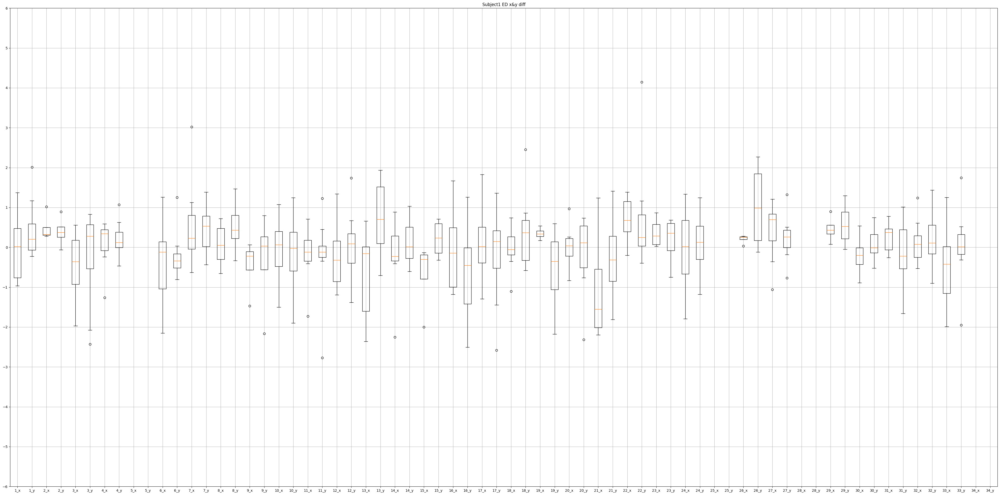

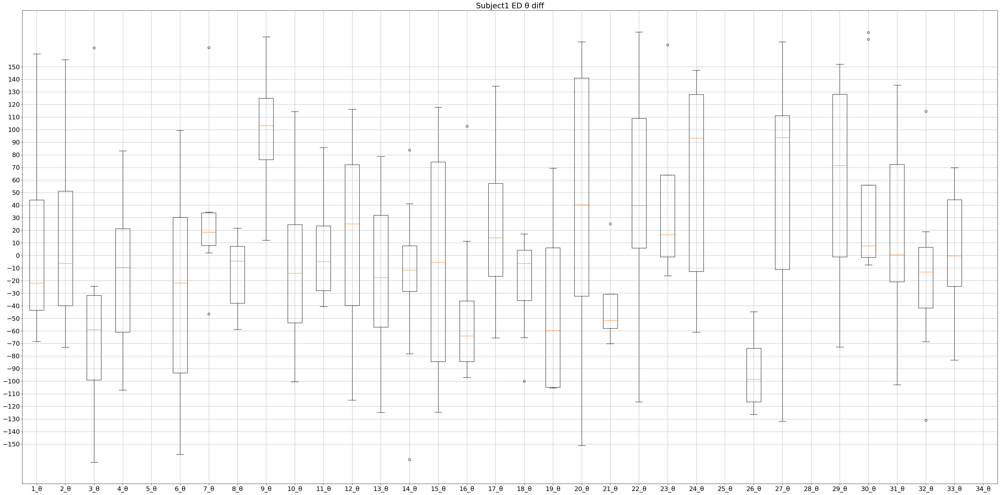

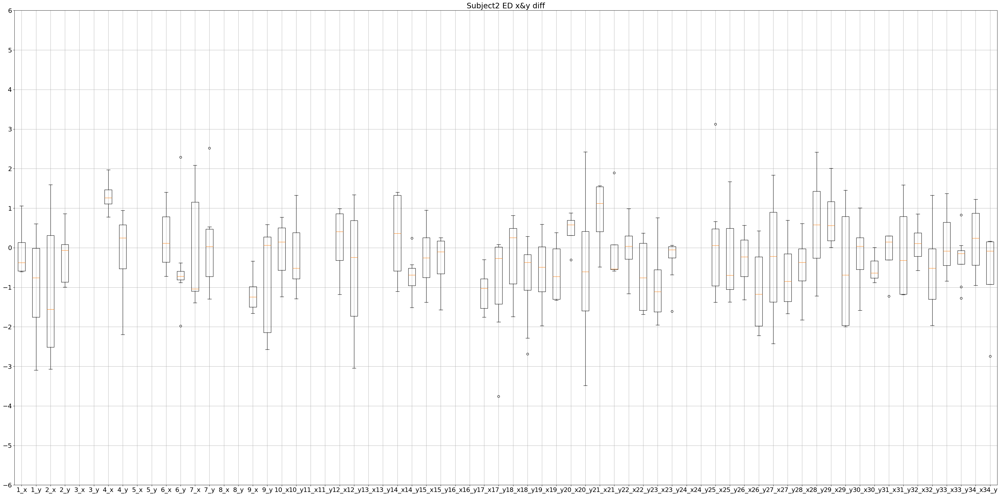

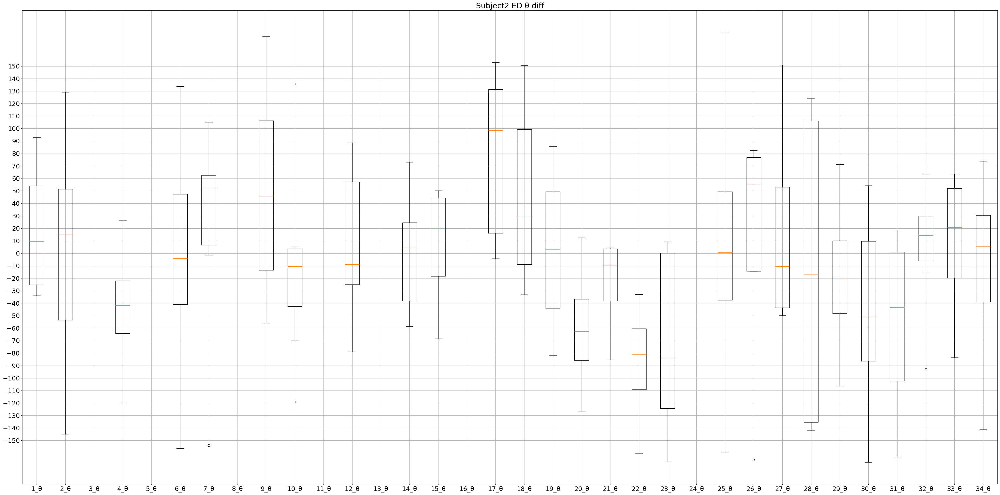

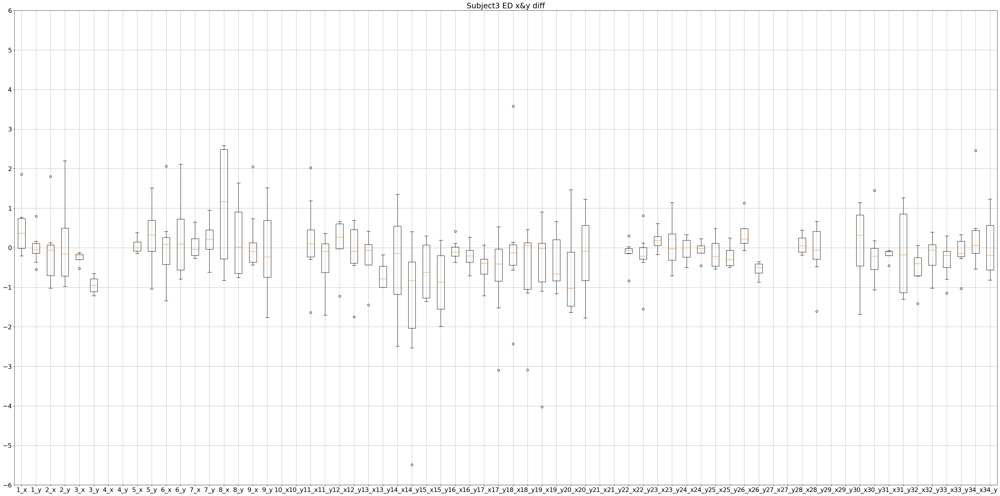

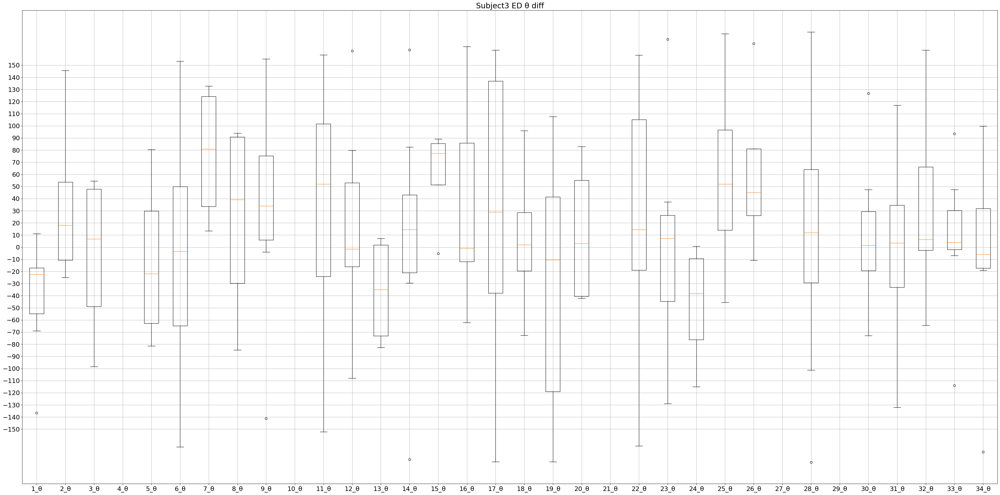

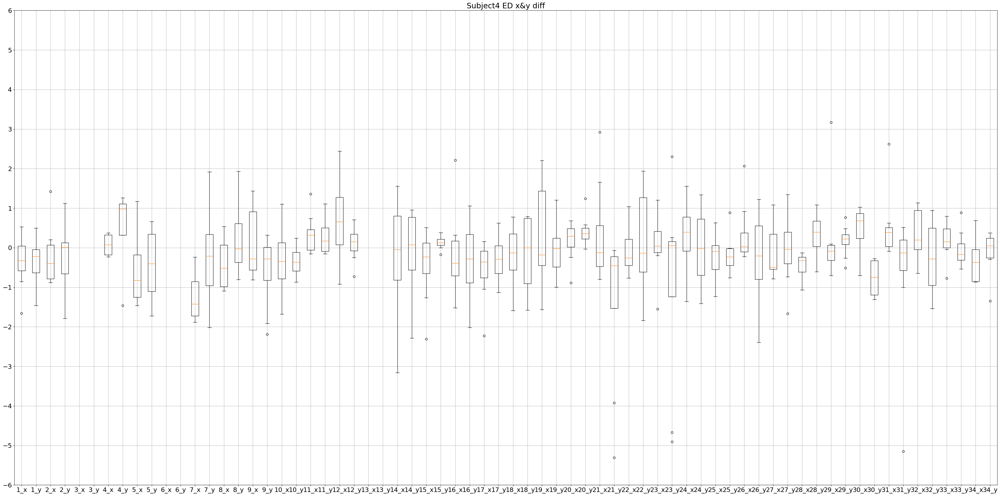

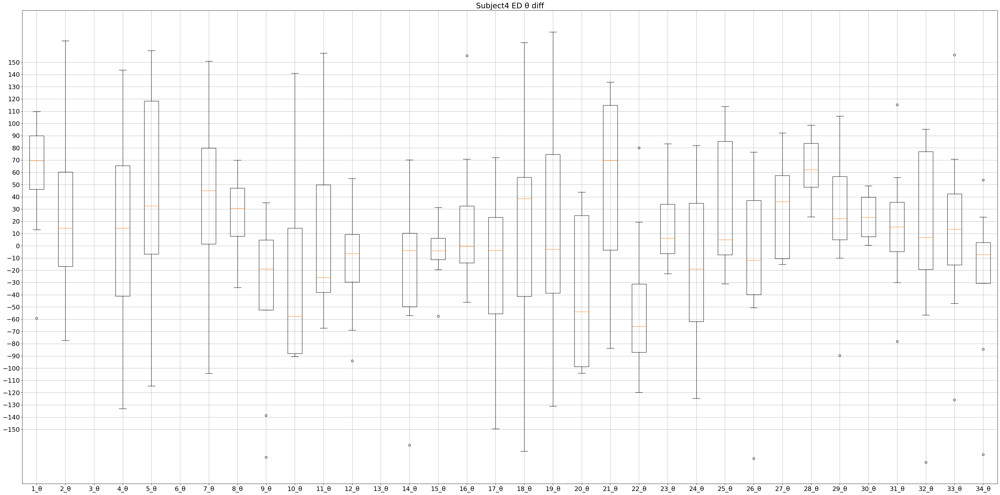

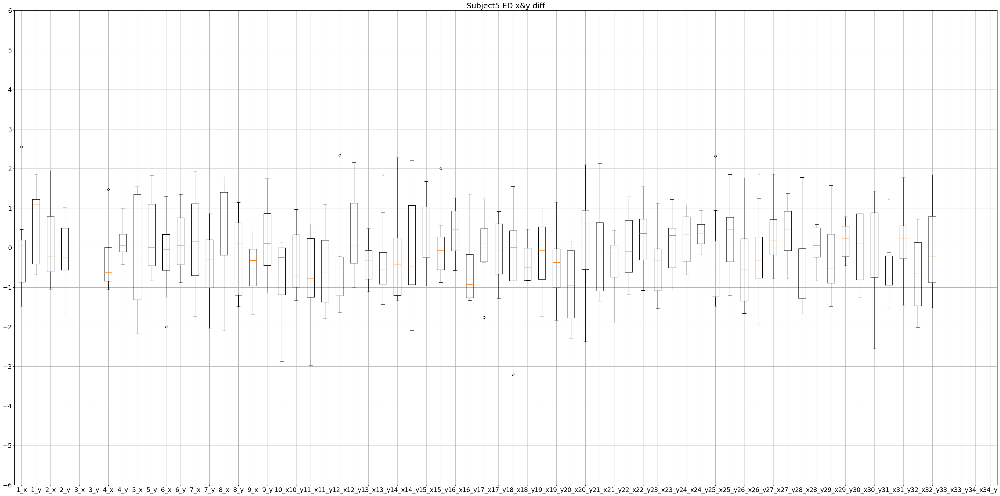

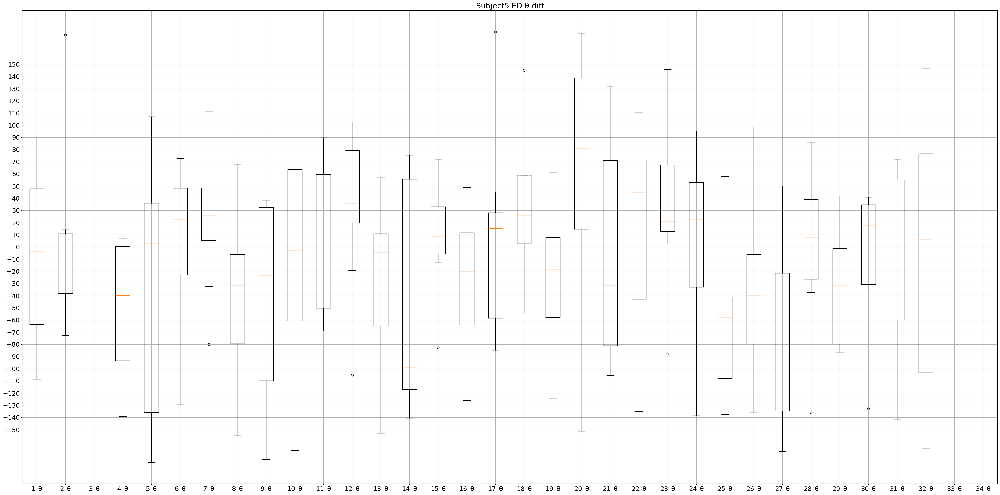

In [22]:
for subject in subjects:
    fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
    ax.boxplot(ED_xy_list[subject])
    ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
    plt.title('Subject'+str(subject)+' ED x&y diff')
    plt.rcParams['font.size'] = 18
    plt.grid()
    plt.yticks(range(-6, 7, 1))
    plt.show()

    fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
    bp = ax.boxplot(ED_theta_list[subject])
    ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
    plt.title('Subject'+str(subject)+' ED θ diff')
    plt.rcParams['font.size'] = 18
    plt.grid()
    plt.yticks(range(-150, 151, 10))
    plt.show()

### 各subjectでの全ジェスチャーの平均値

In [23]:
x_ED_gesture_mean = {}
y_ED_gesture_mean = {}
theta_ED_gesture_mean = {}
x_EP_gesture_mean = {}
y_EP_gesture_mean = {}
theta_EP_gesture_mean = {}
x_FD_gesture_mean = {}
y_FD_gesture_mean = {}
theta_FD_gesture_mean = {}
x_FP_gesture_mean = {}
y_FP_gesture_mean = {}
theta_FP_gesture_mean = {}
for subject in subjects:
    x_ED_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_ED_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_ED_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    x_EP_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_EP_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_EP_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    x_FD_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_FD_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_FD_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    x_FP_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_FP_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_FP_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    for i in range(n_gestures):
        for l in range(len(x_ED_gesture[subject][i+1])):
            x_ED_gesture_mean[subject]['value'].append(x_ED_gesture[subject][i+1][l])
            y_ED_gesture_mean[subject]['value'].append(y_ED_gesture[subject][i+1][l])
            theta_ED_gesture_mean[subject]['value'].append(theta_ED_gesture[subject][i+1][l])
        for l in range(len(x_EP_gesture[subject][i+1])):
            x_EP_gesture_mean[subject]['value'].append(x_EP_gesture[subject][i+1][l])
            y_EP_gesture_mean[subject]['value'].append(y_EP_gesture[subject][i+1][l])
            theta_EP_gesture_mean[subject]['value'].append(theta_EP_gesture[subject][i+1][l])
        for l in range(len(x_FD_gesture[subject][i+1])):
            x_FD_gesture_mean[subject]['value'].append(x_FD_gesture[subject][i+1][l])
            y_FD_gesture_mean[subject]['value'].append(y_FD_gesture[subject][i+1][l])
            theta_FD_gesture_mean[subject]['value'].append(theta_FD_gesture[subject][i+1][l])
        for l in range(len(x_FP_gesture[subject][i+1])):
            x_FP_gesture_mean[subject]['value'].append(x_FP_gesture[subject][i+1][l])
            y_FP_gesture_mean[subject]['value'].append(y_FP_gesture[subject][i+1][l])
            theta_FP_gesture_mean[subject]['value'].append(theta_FP_gesture[subject][i+1][l])
    x_ED_gesture_mean[subject]['mean'] = np.mean(x_ED_gesture_mean[subject]['value'])
    x_ED_gesture_mean[subject]['std'] = np.std(x_ED_gesture_mean[subject]['value'])
    y_ED_gesture_mean[subject]['mean'] = np.mean(y_ED_gesture_mean[subject]['value'])
    y_ED_gesture_mean[subject]['std'] = np.std(y_ED_gesture_mean[subject]['value'])
    theta_ED_gesture_mean[subject]['mean'] = np.mean(theta_ED_gesture_mean[subject]['value'])
    theta_ED_gesture_mean[subject]['std'] = np.std(theta_ED_gesture_mean[subject]['value'])
    x_EP_gesture_mean[subject]['mean'] = np.mean(x_EP_gesture_mean[subject]['value'])
    x_EP_gesture_mean[subject]['std'] = np.std(x_EP_gesture_mean[subject]['value'])
    y_EP_gesture_mean[subject]['mean'] = np.mean(y_EP_gesture_mean[subject]['value'])
    y_EP_gesture_mean[subject]['std'] = np.std(y_EP_gesture_mean[subject]['value'])
    theta_EP_gesture_mean[subject]['mean'] = np.mean(theta_EP_gesture_mean[subject]['value'])
    theta_EP_gesture_mean[subject]['std'] = np.std(theta_EP_gesture_mean[subject]['value'])
    x_FD_gesture_mean[subject]['mean'] = np.mean(x_FD_gesture_mean[subject]['value'])
    x_FD_gesture_mean[subject]['std'] = np.std(x_FD_gesture_mean[subject]['value'])
    y_FD_gesture_mean[subject]['mean'] = np.mean(y_FD_gesture_mean[subject]['value'])
    y_FD_gesture_mean[subject]['std'] = np.std(y_FD_gesture_mean[subject]['value'])
    theta_FD_gesture_mean[subject]['mean'] = np.mean(theta_FD_gesture_mean[subject]['value'])
    theta_FD_gesture_mean[subject]['std'] = np.std(theta_FD_gesture_mean[subject]['value'])
    x_FP_gesture_mean[subject]['mean'] = np.mean(x_FP_gesture_mean[subject]['value'])
    x_FP_gesture_mean[subject]['std'] = np.std(x_FP_gesture_mean[subject]['value'])
    y_FP_gesture_mean[subject]['mean'] = np.mean(y_FP_gesture_mean[subject]['value'])
    y_FP_gesture_mean[subject]['std'] = np.std(y_FP_gesture_mean[subject]['value'])
    theta_FP_gesture_mean[subject]['mean'] = np.mean(theta_FP_gesture_mean[subject]['value'])
    theta_FP_gesture_mean[subject]['std'] = np.std(theta_FP_gesture_mean[subject]['value'])

In [24]:
# 表の作成
rows = []
for subject in subjects:
    rows.append([subject,
                 x_ED_gesture_mean[subject]['mean'], x_ED_gesture_mean[subject]['std'],
                 y_ED_gesture_mean[subject]['mean'], y_ED_gesture_mean[subject]['std'],
                 theta_ED_gesture_mean[subject]['mean'], theta_ED_gesture_mean[subject]['std']])
ED_df = pd.DataFrame(rows, columns=['Subject',
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
rows = []
for subject in subjects:
    rows.append([subject,
                 x_EP_gesture_mean[subject]['mean'], x_EP_gesture_mean[subject]['std'],
                 y_EP_gesture_mean[subject]['mean'], y_EP_gesture_mean[subject]['std'],
                 theta_EP_gesture_mean[subject]['mean'], theta_EP_gesture_mean[subject]['std']])
EP_df = pd.DataFrame(rows, columns=['Subject',
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
rows = []
for subject in subjects:
    rows.append([subject,
                 x_FD_gesture_mean[subject]['mean'], x_FD_gesture_mean[subject]['std'],
                 y_FD_gesture_mean[subject]['mean'], y_FD_gesture_mean[subject]['std'],
                 theta_FD_gesture_mean[subject]['mean'], theta_FD_gesture_mean[subject]['std']])
FD_df = pd.DataFrame(rows, columns=['Subject',
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
rows = []
for subject in subjects:
    rows.append([subject,
                 x_FP_gesture_mean[subject]['mean'], x_FP_gesture_mean[subject]['std'],
                 y_FP_gesture_mean[subject]['mean'], y_FP_gesture_mean[subject]['std'],
                 theta_FP_gesture_mean[subject]['mean'], theta_FP_gesture_mean[subject]['std']])
FP_df = pd.DataFrame(rows, columns=['Subject',
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])

In [25]:
ED_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,-0.034779,0.834194,0.114358,0.931798,5.178556,80.299882
1,2,-0.148048,1.075116,-0.451549,1.108148,-2.496359,78.997482
2,3,-0.047239,0.865896,-0.245231,0.894516,11.999769,83.486218
3,4,-0.050916,0.907714,-0.188301,1.058502,8.675827,73.137925
4,5,-0.200622,1.075394,-0.009862,0.971720,-9.487322,78.708257


In [26]:
EP_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,-0.011328,0.843550,0.000790,0.986206,-8.768481,83.332413
1,2,-0.191148,0.974430,-0.060415,1.038561,-16.280774,85.083341
2,3,-0.001658,0.884211,-0.037913,1.013455,-26.514475,73.944230
3,4,-0.339328,0.830338,-0.209154,0.958918,20.643354,84.083208
4,5,-0.146129,0.908874,-0.168677,0.914679,-3.049750,80.253832


In [27]:
FD_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.023726,0.832464,-0.207873,0.957857,2.750748,67.008346
1,2,0.174865,1.196730,-0.039253,0.930403,-21.984989,83.308329
2,3,-0.173224,1.063564,0.053448,1.234025,2.711185,74.420286
3,4,-0.126740,0.919686,-0.070341,0.990947,-2.839479,79.288859
4,5,0.338034,0.948060,0.019725,1.077380,-12.345423,74.246539


In [28]:
FP_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.040741,0.786437,0.256843,0.924909,-0.387750,72.689394
1,2,-0.184215,0.916713,-0.042546,0.812130,14.036575,72.395504
2,3,-0.066268,0.825970,0.129047,1.079236,-3.985188,75.426494
3,4,-0.011920,0.822771,-0.119533,1.169263,4.697457,85.870978
4,5,-0.001188,0.742924,-0.008059,1.067507,-3.866653,82.052595


### 各被験者の全ジェスチャー・全電極位置の平均値

In [29]:
x_gesture_mean = {}
y_gesture_mean = {}
theta_gesture_mean = {}
for subject in subjects:
    x_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    for i in range(n_gestures):
        for l in range(len(x_ED_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(x_ED_gesture[subject][i+1][l])
            y_gesture_mean[subject]['value'].append(y_ED_gesture[subject][i+1][l])
            theta_gesture_mean[subject]['value'].append(theta_ED_gesture[subject][i+1][l])
        for l in range(len(x_EP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(x_EP_gesture[subject][i+1][l])
            y_gesture_mean[subject]['value'].append(y_EP_gesture[subject][i+1][l])
            theta_gesture_mean[subject]['value'].append(theta_EP_gesture[subject][i+1][l])
        for l in range(len(x_FD_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(x_FD_gesture[subject][i+1][l])
            y_gesture_mean[subject]['value'].append(y_FD_gesture[subject][i+1][l])
            theta_gesture_mean[subject]['value'].append(theta_FD_gesture[subject][i+1][l])
        for l in range(len(x_FP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(x_FP_gesture[subject][i+1][l])
            y_gesture_mean[subject]['value'].append(y_FP_gesture[subject][i+1][l])
            theta_gesture_mean[subject]['value'].append(theta_FP_gesture[subject][i+1][l])
    x_gesture_mean[subject]['mean'] = np.mean(x_gesture_mean[subject]['value'])
    x_gesture_mean[subject]['std'] = np.std(x_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['mean'] = np.mean(y_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['std'] = np.std(y_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['mean'] = np.mean(theta_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['std'] = np.std(theta_gesture_mean[subject]['value'])

In [30]:
# 表の作成
rows = []
for subject in subjects:
    rows.append([subject,
                 x_gesture_mean[subject]['mean'], x_gesture_mean[subject]['std'],
                 y_gesture_mean[subject]['mean'], y_gesture_mean[subject]['std'],
                 theta_gesture_mean[subject]['mean'], theta_gesture_mean[subject]['std']])
mean_std_df = pd.DataFrame(rows, columns=['Subject',
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
mean_std_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.006807,0.823671,0.040378,0.965593,-0.084121,75.735469
1,2,-0.092702,1.047923,-0.127358,0.981768,-6.335227,81.306895
2,3,-0.071014,0.914268,-0.020374,1.071919,-4.368479,78.100206
3,4,-0.136391,0.876986,-0.153529,1.051307,8.801274,81.343211
4,5,-0.001424,0.952376,-0.043252,1.011583,-7.220901,78.902512


### 差分の絶対値

In [31]:
x_gesture_mean = {}
y_gesture_mean = {}
theta_gesture_mean = {}
for subject in subjects:
    x_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    for i in range(n_gestures):
        for l in range(len(x_ED_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_ED_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_ED_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_ED_gesture[subject][i+1][l]))
        for l in range(len(x_EP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_EP_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_EP_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_EP_gesture[subject][i+1][l]))
        for l in range(len(x_FD_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_FD_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_FD_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_FD_gesture[subject][i+1][l]))
        for l in range(len(x_FP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_FP_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_FP_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_FP_gesture[subject][i+1][l]))
    x_gesture_mean[subject]['mean'] = np.mean(x_gesture_mean[subject]['value'])
    x_gesture_mean[subject]['std'] = np.std(x_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['mean'] = np.mean(y_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['std'] = np.std(y_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['mean'] = np.mean(theta_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['std'] = np.std(theta_gesture_mean[subject]['value'])

In [32]:
# 表の作成
rows = []
for subject in subjects:
    rows.append([subject,
                 x_gesture_mean[subject]['mean'], x_gesture_mean[subject]['std'],
                 y_gesture_mean[subject]['mean'], y_gesture_mean[subject]['std'],
                 theta_gesture_mean[subject]['mean'], theta_gesture_mean[subject]['std']])
mean_std_df = pd.DataFrame(rows, columns=['Subject',
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
mean_std_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.605300,0.558652,0.707990,0.657838,57.289666,49.535467
1,2,0.802546,0.680187,0.737465,0.660481,63.984884,50.565611
2,3,0.650886,0.645970,0.770075,0.745930,59.228425,51.095200
3,4,0.643936,0.610781,0.750977,0.751565,62.774581,52.474112
4,5,0.709118,0.635747,0.752008,0.677980,62.593794,48.577409


### ジェスチャーごとの差分

In [33]:
n_gestures_list = []
for distance in distances:
    n_gestures_list.append(int(distance['gesture']))
gestures = set(n_gestures_list)

x_gesture_mean = {}
y_gesture_mean = {}
theta_gesture_mean = {}
for gesture in gestures:
    x_gesture_mean[gesture] = {'value':[], 'mean':0, 'std':0}
    y_gesture_mean[gesture] = {'value':[], 'mean':0, 'std':0}
    theta_gesture_mean[gesture] = {'value':[], 'mean':0, 'std':0}
    for subject in subjects:
        for l in range(len(x_ED_gesture[subject][gesture])):
            x_gesture_mean[gesture]['value'].append(np.abs(x_ED_gesture[subject][gesture][l]))
            y_gesture_mean[gesture]['value'].append(np.abs(y_ED_gesture[subject][gesture][l]))
            theta_gesture_mean[gesture]['value'].append(np.abs(theta_ED_gesture[subject][gesture][l]))
        for l in range(len(x_EP_gesture[subject][gesture])):
            x_gesture_mean[gesture]['value'].append(np.abs(x_EP_gesture[subject][gesture][l]))
            y_gesture_mean[gesture]['value'].append(np.abs(y_EP_gesture[subject][gesture][l]))
            theta_gesture_mean[gesture]['value'].append(np.abs(theta_EP_gesture[subject][gesture][l]))
        for l in range(len(x_FD_gesture[subject][gesture])):
            x_gesture_mean[gesture]['value'].append(np.abs(x_FD_gesture[subject][gesture][l]))
            y_gesture_mean[gesture]['value'].append(np.abs(y_FD_gesture[subject][gesture][l]))
            theta_gesture_mean[gesture]['value'].append(np.abs(theta_FD_gesture[subject][gesture][l]))
        for l in range(len(x_FP_gesture[subject][gesture])):
            x_gesture_mean[gesture]['value'].append(np.abs(x_FP_gesture[subject][gesture][l]))
            y_gesture_mean[gesture]['value'].append(np.abs(y_FP_gesture[subject][gesture][l]))
            theta_gesture_mean[gesture]['value'].append(np.abs(theta_FP_gesture[subject][gesture][l]))
    x_gesture_mean[gesture]['mean'] = np.mean(x_gesture_mean[gesture]['value'])
    x_gesture_mean[gesture]['std'] = np.std(x_gesture_mean[gesture]['value'])
    y_gesture_mean[gesture]['mean'] = np.mean(y_gesture_mean[gesture]['value'])
    y_gesture_mean[gesture]['std'] = np.std(y_gesture_mean[gesture]['value'])
    theta_gesture_mean[gesture]['mean'] = np.mean(theta_gesture_mean[gesture]['value'])
    theta_gesture_mean[gesture]['std'] = np.std(theta_gesture_mean[gesture]['value'])

In [34]:
# 表の作成
rows = []
for gesture in gestures:
    rows.append([gesture, 
                 x_gesture_mean[gesture]['mean'], x_gesture_mean[gesture]['std'],
                 y_gesture_mean[gesture]['mean'], y_gesture_mean[gesture]['std'],
                 theta_gesture_mean[gesture]['mean'], theta_gesture_mean[gesture]['std']])
mean_std_df = pd.DataFrame(rows, columns=['Gesture', 
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
mean_std_df

,Gesture,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.571058,0.494599,0.669913,0.693563,61.885002,48.987004
1,2,0.830505,0.810882,0.683974,0.578764,54.531642,46.109386
2,3,0.702875,0.632818,0.743500,0.776219,61.125339,52.012782
3,4,0.712290,0.644257,0.670436,0.519054,66.201684,53.793653
4,5,0.877076,0.790935,0.787681,0.608937,69.726186,54.411449
5,6,0.647768,0.652601,0.752046,0.602394,58.181076,51.032687
6,7,0.702227,0.637016,0.765598,0.792147,60.331228,45.521677
7,8,0.810246,0.774956,0.771140,0.761427,63.252129,46.296715
8,9,0.633024,0.551107,0.849058,0.832935,62.090079,51.106769
9,10,0.690409,0.611800,0.707176,0.741689,52.545490,44.440849


### trial間の差分

In [35]:
distances_between_trials = []
for list_1 in vpolars:
    for list_2 in vpolars:
        if list_1['subject'] == list_2['subject'] and list_1['session'] == list_2['session']  and list_1['gesture'] == list_2['gesture'] and list_1['trial'] == 1 and list_2['trial'] == 2 and list_1['electrode_place'] == list_2['electrode_place']:
            print(f'file_name: {list_1["file_name"]}, gesture: {list_1["gesture"]}, trial: {list_1["trial"]}, subject: {list_1["subject"]}, session: {list_1["session"]}')
            print(f'file_name: {list_2["file_name"]}, gesture: {list_2["gesture"]}, trial: {list_2["trial"]}, subject: {list_2["subject"]}, session: {list_2["session"]}')
            x_distance = {}
            y_distance = {}
            theta_distance = {}
            result_distance = []
            if list_1['n_virtual_bipolars'] > 0 and list_2['n_virtual_bipolars'] > 0:
                for i in range(len(list_1['center_direction'])):
                    x_distance[i] = []
                    y_distance[i] = []
                    theta_distance[i] = []
                    for j in range(len(list_2['center_direction'])):
                        x_distance[i].append(list_2['center_direction'][j][0] - list_1['center_direction'][i][0])
                        y_distance[i].append(list_2['center_direction'][j][1] - list_1['center_direction'][i][1])
                        theta_distance[i].append(list_2['center_direction'][j][2] - list_1['center_direction'][i][2])
                    print(f'j={j},x_distance[{i}]: {x_distance[i]}, y_distance[{i}]: {y_distance[i]}, theta_distance[{i}]: {theta_distance[i]}')
                    xy_distance = np.sqrt(np.array(x_distance[i])**2 + np.array(y_distance[i])**2)
                    session2_id = np.argmin(xy_distance) #最小値のインデックス
                    result_distance.append({
                        'session1_cluster': list_1['labels'][i],
                        'session2_cluster': list_2['labels'][session2_id],
                        'x_distance': x_distance[i][session2_id],
                        'y_distance': y_distance[i][session2_id],
                        'theta_distance': theta_distance[i][session2_id]
                    })
                    print(f"subject={list_1['subject']}, gesture={list_1['gesture']}, trial={list_1['trial']}, electrode_place={list_1['electrode_place']},session1_id={i}, session2_id={session2_id}: session1_cluster={list_1['labels'][i]}, session2_cluster={list_2['labels'][session2_id]},x_distance={x_distance[i][session2_id]}, y_distance={y_distance[i][session2_id]}, theta_distance={theta_distance[i][session2_id]}")
            else:
                result_distance.append(None)
            distances_between_trials.append({'subject': list_1['subject'], 'gesture': list_1['gesture'], 'session': list_1['session'], 'electrode_place': list_1['electrode_place'], 'result_distance': result_distance})

file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 1
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 1, session: 1
j=3,x_distance[0]: [-0.25144673590772015, -3.922445160173776, -3.689052618647874, -0.21659564795002417], y_distance[0]: [-0.45558893051260974, 0.8364075817004872, -2.8209244177083868, 1.1990275544466105], theta_distance[0]: [-16.802862283430947, -4.966302139284494, -50.05532986540982, -118.73052337266591]
subject=1, gesture=1, trial=1, electrode_place=ED,session1_id=0, session2_id=0: session1_cluster=0, session2_cluster=0,x_distance=-0.25144673590772015, y_distance=-0.45558893051260974, theta_distance=-16.802862283430947
j=3,x_distance[1]: [1.355825400550959, -2.315173023715097, -2.081780482189195, 1.3906764885086549], y_distance[1]: [1.7172441367403044, 3.0092406489534014, -0.6480913504554728, 3.3718606216995246], theta_distance[1]: [-29.637067550433798

In [36]:
n_sessions_list = []
for distance in distances_between_trials:
    n_sessions_list.append(distance['subject'])
subjects = set(n_sessions_list)

x_ED_gesture = {}
y_ED_gesture = {}
theta_ED_gesture = {}
x_EP_gesture = {}
y_EP_gesture = {}
theta_EP_gesture = {}
x_FD_gesture = {}
y_FD_gesture = {}
theta_FD_gesture = {}
x_FP_gesture = {}
y_FP_gesture = {}
theta_FP_gesture = {}
n_gestures = 34
for subject in subjects:
    x_ED_gesture[subject] = {}
    y_ED_gesture[subject] = {}
    theta_ED_gesture[subject] = {}
    x_EP_gesture[subject] = {}
    y_EP_gesture[subject] = {}
    theta_EP_gesture[subject] = {}
    x_FD_gesture[subject] = {}
    y_FD_gesture[subject] = {}
    theta_FD_gesture[subject] = {}
    x_FP_gesture[subject] = {}
    y_FP_gesture[subject] = {}
    theta_FP_gesture[subject] = {}
    for i in range(n_gestures):
        x_ED_gesture[subject][i+1] = []
        y_ED_gesture[subject][i+1] = []
        theta_ED_gesture[subject][i+1] = []
        x_EP_gesture[subject][i+1] = []
        y_EP_gesture[subject][i+1] = []
        theta_EP_gesture[subject][i+1] = []
        x_FD_gesture[subject][i+1] = []
        y_FD_gesture[subject][i+1] = []
        theta_FD_gesture[subject][i+1] = []
        x_FP_gesture[subject][i+1] = []
        y_FP_gesture[subject][i+1] = []
        theta_FP_gesture[subject][i+1] = []

In [37]:
for diff_list in distances_between_trials:
    print(diff_list)
    if diff_list['result_distance'] != [None]:
        subject = diff_list['subject']
        gesture = int(diff_list['gesture'])
        electrode_place = diff_list['electrode_place']
        if electrode_place == 'ED':
            for diff in diff_list['result_distance']:
                x_ED_gesture[subject][gesture].append(diff['x_distance'])
                y_ED_gesture[subject][gesture].append(diff['y_distance'])
                theta_ED_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'EP':
            for diff in diff_list['result_distance']:
                x_EP_gesture[subject][gesture].append(diff['x_distance'])
                y_EP_gesture[subject][gesture].append(diff['y_distance'])
                theta_EP_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'FD':
            for diff in diff_list['result_distance']:
                x_FD_gesture[subject][gesture].append(diff['x_distance'])
                y_FD_gesture[subject][gesture].append(diff['y_distance'])
                theta_FD_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'FP':
            for diff in diff_list['result_distance']:
                x_FP_gesture[subject][gesture].append(diff['x_distance'])
                y_FP_gesture[subject][gesture].append(diff['y_distance'])
                theta_FP_gesture[subject][gesture].append(diff['theta_distance'])

{'subject': 1, 'gesture': '1', 'session': 1, 'electrode_place': 'ED', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 0, 'x_distance': -0.25144673590772015, 'y_distance': -0.45558893051260974, 'theta_distance': -16.802862283430947}, {'session1_cluster': 1, 'session2_cluster': 2, 'x_distance': -2.081780482189195, 'y_distance': -0.6480913504554728, 'theta_distance': -62.88953513241267}, {'session1_cluster': 2, 'session2_cluster': 2, 'x_distance': 1.6120951419416039, 'y_distance': -0.7769010819585456, 'theta_distance': 65.67486789494787}, {'session1_cluster': 3, 'session2_cluster': 3, 'x_distance': -0.05710379555486966, 'y_distance': -0.5575123149680197, 'theta_distance': -59.61624441377758}]}
{'subject': 1, 'gesture': '1', 'session': 1, 'electrode_place': 'EP', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 3, 'x_distance': -0.3277181338426365, 'y_distance': 0.4571264110993676, 'theta_distance': -105.94099588832589}, {'session1_cluster': 1, 'session2_clus

In [38]:
x_gesture_mean = {}
y_gesture_mean = {}
theta_gesture_mean = {}
for subject in subjects:
    x_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    for i in range(n_gestures):
        for l in range(len(x_ED_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_ED_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_ED_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_ED_gesture[subject][i+1][l]))
        for l in range(len(x_EP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_EP_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_EP_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_EP_gesture[subject][i+1][l]))
        for l in range(len(x_FD_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_FD_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_FD_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_FD_gesture[subject][i+1][l]))
        for l in range(len(x_FP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_FP_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_FP_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_FP_gesture[subject][i+1][l]))
    x_gesture_mean[subject]['mean'] = np.mean(x_gesture_mean[subject]['value'])
    x_gesture_mean[subject]['std'] = np.std(x_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['mean'] = np.mean(y_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['std'] = np.std(y_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['mean'] = np.mean(theta_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['std'] = np.std(theta_gesture_mean[subject]['value'])

In [39]:
# 表の作成
rows = []
for subject in subjects:
    rows.append([subject,
                 x_gesture_mean[subject]['mean'], x_gesture_mean[subject]['std'],
                 y_gesture_mean[subject]['mean'], y_gesture_mean[subject]['std'],
                 theta_gesture_mean[subject]['mean'], theta_gesture_mean[subject]['std']])
mean_std_df = pd.DataFrame(rows, columns=['Subject',
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
mean_std_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.482009,0.570118,0.499871,0.567845,51.764118,51.048494
1,2,0.448198,0.582096,0.419099,0.545139,50.853617,51.000670
2,3,0.456701,0.550051,0.515446,0.556413,48.379855,48.530795
3,4,0.437664,0.587031,0.523325,0.614788,52.892448,54.201720
4,5,0.395646,0.467838,0.496586,0.566665,51.447725,49.846706


### 異なるsessionの異なるtrialを比較

In [40]:
distances_across_session_trials = []
for list_1 in vpolars:
    for list_2 in vpolars:
        if list_1['subject'] == list_2['subject'] and list_1['session'] == 1 and list_2['session'] == 2  and list_1['gesture'] == list_2['gesture'] and list_1['trial'] != list_2['trial'] and list_1['electrode_place'] == list_2['electrode_place']:
            print(f'file_name: {list_1["file_name"]}, gesture: {list_1["gesture"]}, trial: {list_1["trial"]}, subject: {list_1["subject"]}, session: {list_1["session"]}')
            print(f'file_name: {list_2["file_name"]}, gesture: {list_2["gesture"]}, trial: {list_2["trial"]}, subject: {list_2["subject"]}, session: {list_2["session"]}')
            x_distance = {}
            y_distance = {}
            theta_distance = {}
            result_distance = []
            if list_1['n_virtual_bipolars'] > 0 and list_2['n_virtual_bipolars'] > 0:
                for i in range(len(list_1['center_direction'])):
                    x_distance[i] = []
                    y_distance[i] = []
                    theta_distance[i] = []
                    for j in range(len(list_2['center_direction'])):
                        x_distance[i].append(list_2['center_direction'][j][0] - list_1['center_direction'][i][0])
                        y_distance[i].append(list_2['center_direction'][j][1] - list_1['center_direction'][i][1])
                        theta_distance[i].append(list_2['center_direction'][j][2] - list_1['center_direction'][i][2])
                    print(f'j={j},x_distance[{i}]: {x_distance[i]}, y_distance[{i}]: {y_distance[i]}, theta_distance[{i}]: {theta_distance[i]}')
                    xy_distance = np.sqrt(np.array(x_distance[i])**2 + np.array(y_distance[i])**2)
                    session2_id = np.argmin(xy_distance) #最小値のインデックス
                    result_distance.append({
                        'session1_cluster': list_1['labels'][i],
                        'session2_cluster': list_2['labels'][session2_id],
                        'x_distance': x_distance[i][session2_id],
                        'y_distance': y_distance[i][session2_id],
                        'theta_distance': theta_distance[i][session2_id]
                    })
                    print(f"subject={list_1['subject']}, gesture={list_1['gesture']}, trial={list_1['trial']}, electrode_place={list_1['electrode_place']},session1_id={i}, session2_id={session2_id}: session1_cluster={list_1['labels'][i]}, session2_cluster={list_2['labels'][session2_id]},x_distance={x_distance[i][session2_id]}, y_distance={y_distance[i][session2_id]}, theta_distance={theta_distance[i][session2_id]}")
            else:
                result_distance.append(None)
            distances_across_session_trials.append({'subject': list_1['subject'], 'gesture': list_1['gesture'], 'session': list_1['session'], 'electrode_place': list_1['electrode_place'], 'result_distance': result_distance})

file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 1
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 1, session: 2
j=3,x_distance[0]: [-3.962182199760327, 0.2009446091487339, -1.0468626266427048, -2.5469596784722657], y_distance[0]: [-2.8589932663286732, 1.3322839687731989, -0.17827248328200884, 2.004466403635222], theta_distance[0]: [-67.10657802239874, 41.46623447377662, -6.9783398189937955, -59.92017911822519]
subject=1, gesture=1, trial=1, electrode_place=ED,session1_id=0, session2_id=2: session1_cluster=0, session2_cluster=2,x_distance=-1.0468626266427048, y_distance=-0.17827248328200884, theta_distance=-6.9783398189937955
j=3,x_distance[1]: [-2.3549100633016478, 1.808216745607413, 0.5604095098159743, -0.9396875420135866], y_distance[1]: [-0.6861601990757591, 3.505117036026113, 1.9945605839709053, 4.177299470888136], theta_distance[1]: [-79.94078328940158, 28.63

In [41]:
n_sessions_list = []
for distance in distances_across_session_trials:
    n_sessions_list.append(distance['subject'])
subjects = set(n_sessions_list)

x_ED_gesture = {}
y_ED_gesture = {}
theta_ED_gesture = {}
x_EP_gesture = {}
y_EP_gesture = {}
theta_EP_gesture = {}
x_FD_gesture = {}
y_FD_gesture = {}
theta_FD_gesture = {}
x_FP_gesture = {}
y_FP_gesture = {}
theta_FP_gesture = {}
n_gestures = 34
for subject in subjects:
    x_ED_gesture[subject] = {}
    y_ED_gesture[subject] = {}
    theta_ED_gesture[subject] = {}
    x_EP_gesture[subject] = {}
    y_EP_gesture[subject] = {}
    theta_EP_gesture[subject] = {}
    x_FD_gesture[subject] = {}
    y_FD_gesture[subject] = {}
    theta_FD_gesture[subject] = {}
    x_FP_gesture[subject] = {}
    y_FP_gesture[subject] = {}
    theta_FP_gesture[subject] = {}
    for i in range(n_gestures):
        x_ED_gesture[subject][i+1] = []
        y_ED_gesture[subject][i+1] = []
        theta_ED_gesture[subject][i+1] = []
        x_EP_gesture[subject][i+1] = []
        y_EP_gesture[subject][i+1] = []
        theta_EP_gesture[subject][i+1] = []
        x_FD_gesture[subject][i+1] = []
        y_FD_gesture[subject][i+1] = []
        theta_FD_gesture[subject][i+1] = []
        x_FP_gesture[subject][i+1] = []
        y_FP_gesture[subject][i+1] = []
        theta_FP_gesture[subject][i+1] = []

In [42]:
for diff_list in distances_across_session_trials:
    print(diff_list)
    if diff_list['result_distance'] != [None]:
        subject = diff_list['subject']
        gesture = int(diff_list['gesture'])
        electrode_place = diff_list['electrode_place']
        if electrode_place == 'ED':
            for diff in diff_list['result_distance']:
                x_ED_gesture[subject][gesture].append(diff['x_distance'])
                y_ED_gesture[subject][gesture].append(diff['y_distance'])
                theta_ED_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'EP':
            for diff in diff_list['result_distance']:
                x_EP_gesture[subject][gesture].append(diff['x_distance'])
                y_EP_gesture[subject][gesture].append(diff['y_distance'])
                theta_EP_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'FD':
            for diff in diff_list['result_distance']:
                x_FD_gesture[subject][gesture].append(diff['x_distance'])
                y_FD_gesture[subject][gesture].append(diff['y_distance'])
                theta_FD_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'FP':
            for diff in diff_list['result_distance']:
                x_FP_gesture[subject][gesture].append(diff['x_distance'])
                y_FP_gesture[subject][gesture].append(diff['y_distance'])
                theta_FP_gesture[subject][gesture].append(diff['theta_distance'])

{'subject': 1, 'gesture': '1', 'session': 1, 'electrode_place': 'ED', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 2, 'x_distance': -1.0468626266427048, 'y_distance': -0.17827248328200884, 'theta_distance': -6.9783398189937955}, {'session1_cluster': 1, 'session2_cluster': 2, 'x_distance': 0.5604095098159743, 'y_distance': 1.9945605839709053, 'theta_distance': -19.812545085996646}, {'session1_cluster': 2, 'session2_cluster': 0, 'x_distance': 1.338965560829151, 'y_distance': -0.8149699305788318, 'theta_distance': 48.623619737958954}, {'session1_cluster': 3, 'session2_cluster': 1, 'x_distance': 0.3604364615438884, 'y_distance': -0.42425590064143126, 'theta_distance': 100.58051343266496}]}
{'subject': 1, 'gesture': '1', 'session': 1, 'electrode_place': 'EP', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 0, 'x_distance': -0.35371484695406075, 'y_distance': 0.7669079247916333, 'theta_distance': 10.935189216134788}, {'session1_cluster': 1, 'session2_cluste

In [43]:
x_gesture_mean = {}
y_gesture_mean = {}
theta_gesture_mean = {}
for subject in subjects:
    x_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    for i in range(n_gestures):
        for l in range(len(x_ED_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_ED_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_ED_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_ED_gesture[subject][i+1][l]))
        for l in range(len(x_EP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_EP_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_EP_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_EP_gesture[subject][i+1][l]))
        for l in range(len(x_FD_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_FD_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_FD_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_FD_gesture[subject][i+1][l]))
        for l in range(len(x_FP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_FP_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_FP_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_FP_gesture[subject][i+1][l]))
    x_gesture_mean[subject]['mean'] = np.mean(x_gesture_mean[subject]['value'])
    x_gesture_mean[subject]['std'] = np.std(x_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['mean'] = np.mean(y_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['std'] = np.std(y_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['mean'] = np.mean(theta_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['std'] = np.std(theta_gesture_mean[subject]['value'])

In [44]:
# 表の作成
rows = []
for subject in subjects:
    rows.append([subject,
                 x_gesture_mean[subject]['mean'], x_gesture_mean[subject]['std'],
                 y_gesture_mean[subject]['mean'], y_gesture_mean[subject]['std'],
                 theta_gesture_mean[subject]['mean'], theta_gesture_mean[subject]['std']])
mean_std_df = pd.DataFrame(rows, columns=['Subject',
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
mean_std_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.636052,0.576623,0.721059,0.643283,55.738015,48.585012
1,2,0.789724,0.653917,0.743296,0.692666,60.581017,48.881487
2,3,0.679569,0.713022,0.809322,0.777853,60.624802,50.828647
3,4,0.643233,0.648980,0.750643,0.749717,63.047657,53.551347
4,5,0.705521,0.628280,0.725443,0.649350,60.415679,47.974216


# θも考慮して標準化した値の差分が最も近いモノ同士を比較

In [46]:
# Δx, Δy, Δθ標準化のための平均値と標準偏差を計算
x_list = []
y_list = []
theta_list = []
for vpolar_list in vpolars:
    for vpolar in vpolar_list['center_direction']:
        x_list.append(vpolar[0])
        y_list.append(vpolar[1])
        theta_list.append(vpolar[2])
        # print(f"x: {vpolar[0]}, y: {vpolar[1]}, θ: {vpolar[2]}")
x_mean = np.mean(x_list)
y_mean = np.mean(y_list)
theta_mean = np.mean(theta_list)
x_std = np.std(x_list)
y_std = np.std(y_list)
theta_std = np.std(theta_list)

In [47]:
distances = []
for list_session1 in vpolars:
    for list_session2 in vpolars:
        if list_session1['subject'] == list_session2['subject'] and list_session1['session'] == 1 and list_session2['session'] == 2 and list_session1['gesture'] == list_session2['gesture'] and list_session1['trial'] == list_session2['trial'] and list_session1['electrode_place'] == list_session2['electrode_place']:
            print(f'file_name: {list_session1["file_name"]}, gesture: {list_session1["gesture"]}, trial: {list_session1["trial"]}, subject: {list_session1["subject"]}, session: {list_session1["session"]}')
            print(f'file_name: {list_session2["file_name"]}, gesture: {list_session2["gesture"]}, trial: {list_session2["trial"]}, subject: {list_session2["subject"]}, session: {list_session2["session"]}')
            x_distance = {}
            y_distance = {}
            theta_distance = {}
            result_distance = []
            if list_session1['n_virtual_bipolars'] > 0 and list_session2['n_virtual_bipolars'] > 0:
                for i in range(len(list_session1['center_direction'])):
                    x_distance[i] = []
                    y_distance[i] = []
                    theta_distance[i] = []
                    for j in range(len(list_session2['center_direction'])):
                        x_distance[i].append(list_session2['center_direction'][j][0] - list_session1['center_direction'][i][0])
                        y_distance[i].append(list_session2['center_direction'][j][1] - list_session1['center_direction'][i][1])
                        theta_distance[i].append(list_session2['center_direction'][j][2] - list_session1['center_direction'][i][2])
                    # print(f'j={j},x_distance[{i}]: {x_distance[i]}, y_distance[{i}]: {y_distance[i]}, theta_distance[{i}]: {theta_distance[i]}')
                    # xy_distance = np.sqrt(np.array(x_distance[i])**2 + np.array(y_distance[i])**2)
                    # θの距離も考慮して正規化
                    x_norm = (np.array(x_distance[i]) - x_mean) / x_std
                    y_norm = (np.array(y_distance[i]) - y_mean) / y_std
                    theta_norm = (np.array(theta_distance[i]) - theta_mean) / theta_std
                    xy_distance = np.sqrt(x_norm**2 + y_norm**2 + theta_norm**2) # θの距離も考慮
                    session2_id = np.argmin(xy_distance) #最小値のインデックス
                    result_distance.append({
                        'session1_cluster': list_session1['labels'][i],
                        'session2_cluster': list_session2['labels'][session2_id],
                        'x_distance': x_distance[i][session2_id],
                        'y_distance': y_distance[i][session2_id],
                        'theta_distance': theta_distance[i][session2_id]
                    })
                    # print(f"subject={list_session1['subject']}, gesture={list_session1['gesture']}, trial={list_session1['trial']}, electrode_place={list_session1['electrode_place']},session1_id={i}, session2_id={session2_id}: session1_cluster={list_session1['labels'][i]}, session2_cluster={list_session2['labels'][session2_id]},x_distance={x_distance[i][session2_id]}, y_distance={y_distance[i][session2_id]}, theta_distance={theta_distance[i][session2_id]}")
            else:
                result_distance.append(None)
            distances.append({'subject': list_session1['subject'], 'gesture': list_session1['gesture'], 'trial': list_session1['trial'], 'electrode_place': list_session1['electrode_place'], 'result_distance': result_distance})
            

file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 1
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 2
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 1
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 2
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 1
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 2
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 1
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 2
file_name: pr_dataset/subject01_session1/maintenance_pre

In [48]:
n_sessions_list = []
for distance in distances:
    n_sessions_list.append(distance['subject'])
subjects = set(n_sessions_list)

x_ED_gesture = {}
y_ED_gesture = {}
theta_ED_gesture = {}
x_EP_gesture = {}
y_EP_gesture = {}
theta_EP_gesture = {}
x_FD_gesture = {}
y_FD_gesture = {}
theta_FD_gesture = {}
x_FP_gesture = {}
y_FP_gesture = {}
theta_FP_gesture = {}
n_gestures = 34
for subject in subjects:
    x_ED_gesture[subject] = {}
    y_ED_gesture[subject] = {}
    theta_ED_gesture[subject] = {}
    x_EP_gesture[subject] = {}
    y_EP_gesture[subject] = {}
    theta_EP_gesture[subject] = {}
    x_FD_gesture[subject] = {}
    y_FD_gesture[subject] = {}
    theta_FD_gesture[subject] = {}
    x_FP_gesture[subject] = {}
    y_FP_gesture[subject] = {}
    theta_FP_gesture[subject] = {}
    for i in range(n_gestures):
        x_ED_gesture[subject][i+1] = []
        y_ED_gesture[subject][i+1] = []
        theta_ED_gesture[subject][i+1] = []
        x_EP_gesture[subject][i+1] = []
        y_EP_gesture[subject][i+1] = []
        theta_EP_gesture[subject][i+1] = []
        x_FD_gesture[subject][i+1] = []
        y_FD_gesture[subject][i+1] = []
        theta_FD_gesture[subject][i+1] = []
        x_FP_gesture[subject][i+1] = []
        y_FP_gesture[subject][i+1] = []
        theta_FP_gesture[subject][i+1] = []

for diff_list in distances:
    print(diff_list)
    if diff_list['result_distance'] != [None]:
        subject = diff_list['subject']
        gesture = int(diff_list['gesture'])
        electrode_place = diff_list['electrode_place']
        if electrode_place == 'ED':
            for diff in diff_list['result_distance']:
                x_ED_gesture[subject][gesture].append(diff['x_distance'])
                y_ED_gesture[subject][gesture].append(diff['y_distance'])
                theta_ED_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'EP':
            for diff in diff_list['result_distance']:
                x_EP_gesture[subject][gesture].append(diff['x_distance'])
                y_EP_gesture[subject][gesture].append(diff['y_distance'])
                theta_EP_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'FD':
            for diff in diff_list['result_distance']:
                x_FD_gesture[subject][gesture].append(diff['x_distance'])
                y_FD_gesture[subject][gesture].append(diff['y_distance'])
                theta_FD_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'FP':
            for diff in diff_list['result_distance']:
                x_FP_gesture[subject][gesture].append(diff['x_distance'])
                y_FP_gesture[subject][gesture].append(diff['y_distance'])
                theta_FP_gesture[subject][gesture].append(diff['theta_distance'])

x_gesture_mean = {}
y_gesture_mean = {}
theta_gesture_mean = {}
for subject in subjects:
    x_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    for i in range(n_gestures):
        for l in range(len(x_ED_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_ED_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_ED_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_ED_gesture[subject][i+1][l]))
        for l in range(len(x_EP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_EP_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_EP_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_EP_gesture[subject][i+1][l]))
        for l in range(len(x_FD_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_FD_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_FD_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_FD_gesture[subject][i+1][l]))
        for l in range(len(x_FP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_FP_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_FP_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_FP_gesture[subject][i+1][l]))
    x_gesture_mean[subject]['mean'] = np.mean(x_gesture_mean[subject]['value'])
    x_gesture_mean[subject]['std'] = np.std(x_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['mean'] = np.mean(y_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['std'] = np.std(y_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['mean'] = np.mean(theta_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['std'] = np.std(theta_gesture_mean[subject]['value'])

# 表の作成
rows = []
for subject in subjects:
    rows.append([subject, 
                 x_gesture_mean[subject]['mean'], x_gesture_mean[subject]['std'],
                 y_gesture_mean[subject]['mean'], y_gesture_mean[subject]['std'],
                 theta_gesture_mean[subject]['mean'], theta_gesture_mean[subject]['std']])
mean_std_df = pd.DataFrame(rows, columns=['Subject', 
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
mean_std_df

{'subject': 1, 'gesture': '1', 'trial': 1, 'electrode_place': 'ED', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 2, 'x_distance': -0.9623615668533629, 'y_distance': -0.16464011776581167, 'theta_distance': -27.000479310994105}, {'session1_cluster': 1, 'session2_cluster': 2, 'x_distance': 0.6449105696053161, 'y_distance': 2.0081929494871025, 'theta_distance': -39.83468457799695}, {'session1_cluster': 2, 'session2_cluster': 1, 'x_distance': 5.457193683865519, 'y_distance': 3.5777336864456766, 'theta_distance': -11.793181321550875}, {'session1_cluster': 3, 'session2_cluster': 1, 'x_distance': 0.3155377756711957, 'y_distance': -0.22282951871879497, 'theta_distance': -68.40910012302022}]}
{'subject': 1, 'gesture': '1', 'trial': 1, 'electrode_place': 'EP', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 3, 'x_distance': 2.2496223039626777, 'y_distance': 2.0891351141257752, 'theta_distance': -95.07656803814483}, {'session1_cluster': 1, 'session2_cluster': 0, 

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,1.740047,1.692873,1.777002,1.658190,44.796248,38.784504
1,2,2.023740,1.567741,1.739694,1.607369,45.718701,36.428482
2,3,1.795538,1.605337,1.783716,1.539914,42.986725,37.434382
3,4,1.891751,1.634497,1.858358,1.558088,47.289709,38.407117
4,5,1.808058,1.718048,1.906603,1.614123,44.983584,38.563412


## 全subjectsでの分析

In [45]:
x_ED_gesture = {}
y_ED_gesture = {}
theta_ED_gesture = {}
x_EP_gesture = {}
y_EP_gesture = {}
theta_EP_gesture = {}
x_FD_gesture = {}
y_FD_gesture = {}
theta_FD_gesture = {}
x_FP_gesture = {}
y_FP_gesture = {}
theta_FP_gesture = {}
n_gestures = 34
for i in range(n_gestures):
    x_ED_gesture[i+1] = []
    y_ED_gesture[i+1] = []
    theta_ED_gesture[i+1] = []
    x_EP_gesture[i+1] = []
    y_EP_gesture[i+1] = []
    theta_EP_gesture[i+1] = []
    x_FD_gesture[i+1] = []
    y_FD_gesture[i+1] = []
    theta_FD_gesture[i+1] = []
    x_FP_gesture[i+1] = []
    y_FP_gesture[i+1] = []
    theta_FP_gesture[i+1] = []

In [ ]:
for diff_list in distances:
    print(diff_list)
    if diff_list['result_distance'] != [None]:
        gesture = int(diff_list['gesture'])
        electrode_place = diff_list['electrode_place']
        if electrode_place == 'ED':
            for diff in diff_list['result_distance']:
                x_ED_gesture[gesture].append(diff['x_distance'])
                y_ED_gesture[gesture].append(diff['y_distance'])
                theta_ED_gesture[gesture].append(diff['theta_distance'])
        elif electrode_place == 'EP':
            for diff in diff_list['result_distance']:
                x_EP_gesture[gesture].append(diff['x_distance'])
                y_EP_gesture[gesture].append(diff['y_distance'])
                theta_EP_gesture[gesture].append(diff['theta_distance'])
        elif electrode_place == 'FD':
            for diff in diff_list['result_distance']:
                x_FD_gesture[gesture].append(diff['x_distance'])
                y_FD_gesture[gesture].append(diff['y_distance'])
                theta_FD_gesture[gesture].append(diff['theta_distance'])
        elif electrode_place == 'FP':
            for diff in diff_list['result_distance']:
                x_FP_gesture[gesture].append(diff['x_distance'])
                y_FP_gesture[gesture].append(diff['y_distance'])
                theta_FP_gesture[gesture].append(diff['theta_distance'])

{'subject': 1, 'gesture': '1', 'trial': 1, 'electrode_place': 'ED', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 20, 'x_distance': 0.6355043368060231, 'y_distance': 0.2968244295037339, 'theta_distance': 126.80880311567324}, {'session1_cluster': 1, 'session2_cluster': 20, 'x_distance': 0.8046718794426484, 'y_distance': 0.20238527097442738, 'theta_distance': 6.995579169369314}, {'session1_cluster': 2, 'session2_cluster': 20, 'x_distance': 0.34048013321548076, 'y_distance': 0.3659353932278293, 'theta_distance': -18.365583335385004}, {'session1_cluster': 30, 'session2_cluster': 10, 'x_distance': -0.02485568984674824, 'y_distance': -0.05747863767190342, 'theta_distance': 9.093665741959128}]}
{'subject': 1, 'gesture': '1', 'trial': 1, 'electrode_place': 'EP', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 20, 'x_distance': 0.6355043368060231, 'y_distance': 0.2968244295037339, 'theta_distance': 126.80880311567324}, {'session1_cluster': 1, 'session2_cluster'

In [ ]:
ED_xy_list = []
EP_xy_list = []
FD_xy_list = []
FP_xy_list = []
for i in range(n_gestures):
    ED_xy_list.append(x_ED_gesture[i+1])
    ED_xy_list.append(y_ED_gesture[i+1])
    # ED_list.append(theta_ED_gesture[i+1])
for i in range(n_gestures):
    EP_xy_list.append(x_EP_gesture[i+1])
    EP_xy_list.append(y_EP_gesture[i+1])
    # EP_list.append(theta_EP_gesture[i+1])
for i in range(n_gestures):
    FD_xy_list.append(x_FD_gesture[i+1])
    FD_xy_list.append(y_FD_gesture[i+1])
    # FD_list.append(theta_FD_gesture[i+1])
for i in range(n_gestures):
    FP_xy_list.append(x_FP_gesture[i+1])
    FP_xy_list.append(y_FP_gesture[i+1])
    # FP_list.append(theta_FP_gesture[i+1])

ED_theta_list = []
EP_theta_list = []
FD_theta_list = []
FP_theta_list = []
for i in range(n_gestures):
    ED_theta_list.append(theta_ED_gesture[i+1])
for i in range(n_gestures):
    EP_theta_list.append(theta_EP_gesture[i+1])
for i in range(n_gestures):
    FD_theta_list.append(theta_FD_gesture[i+1])
for i in range(n_gestures):
    FP_theta_list.append(theta_FP_gesture[i+1])


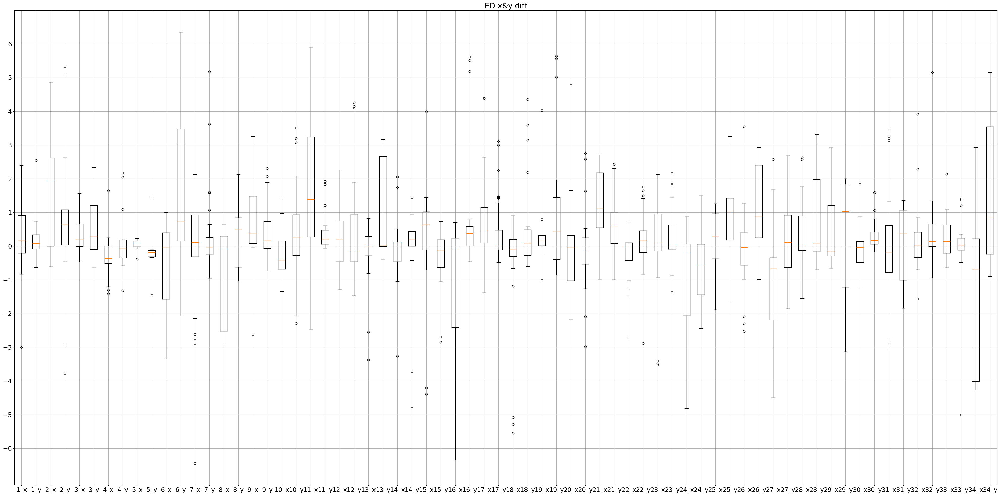

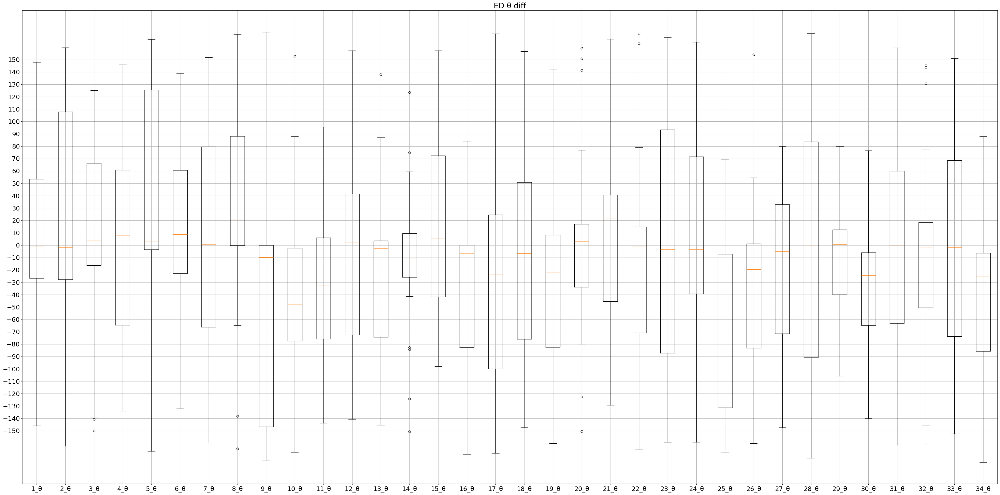

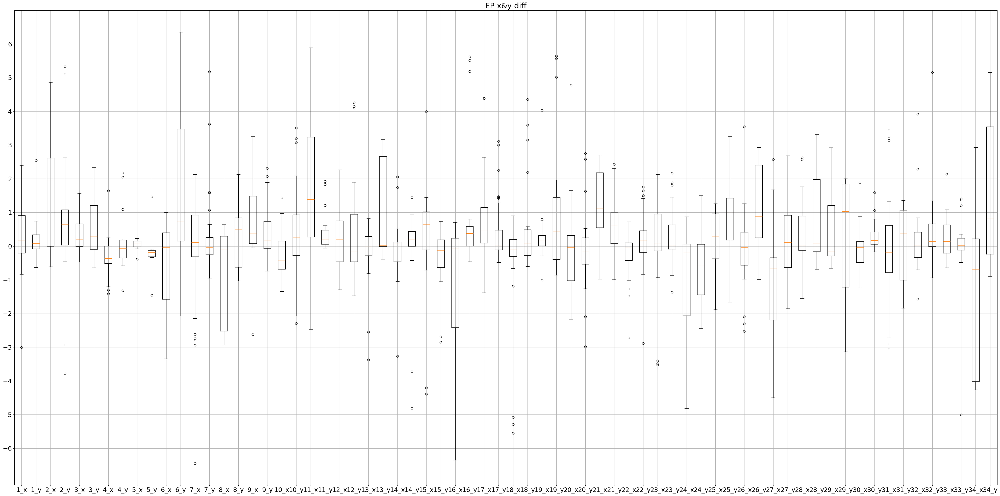

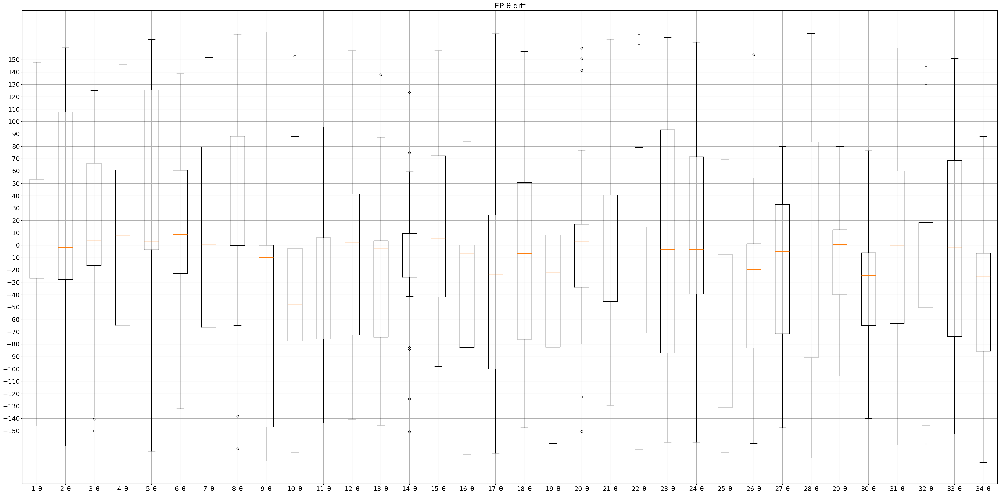

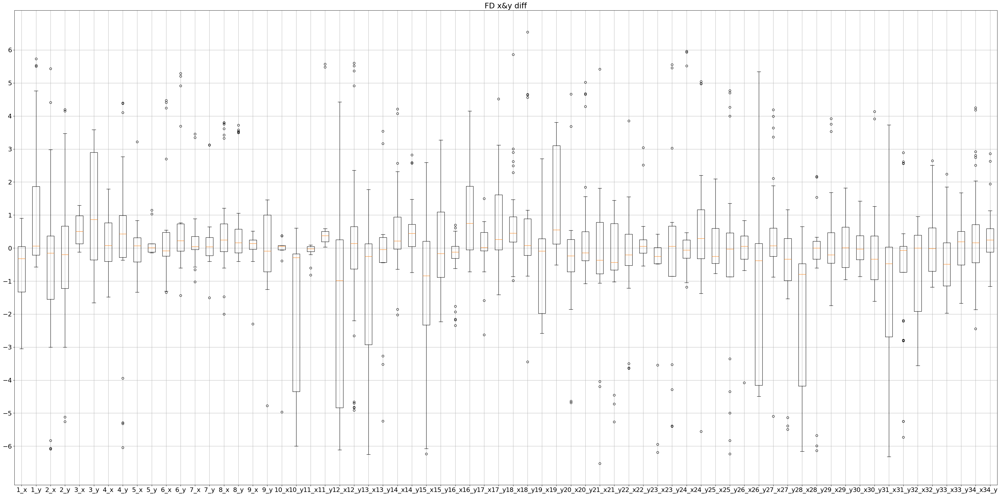

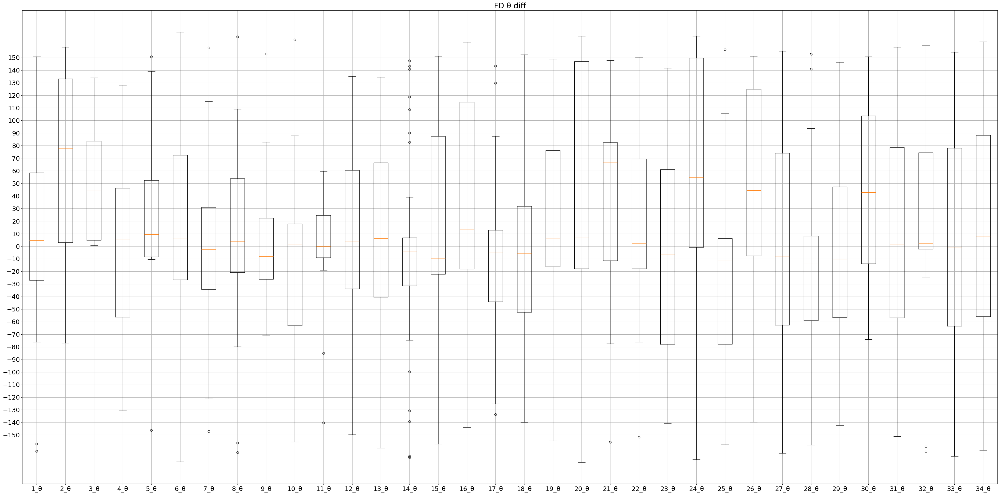

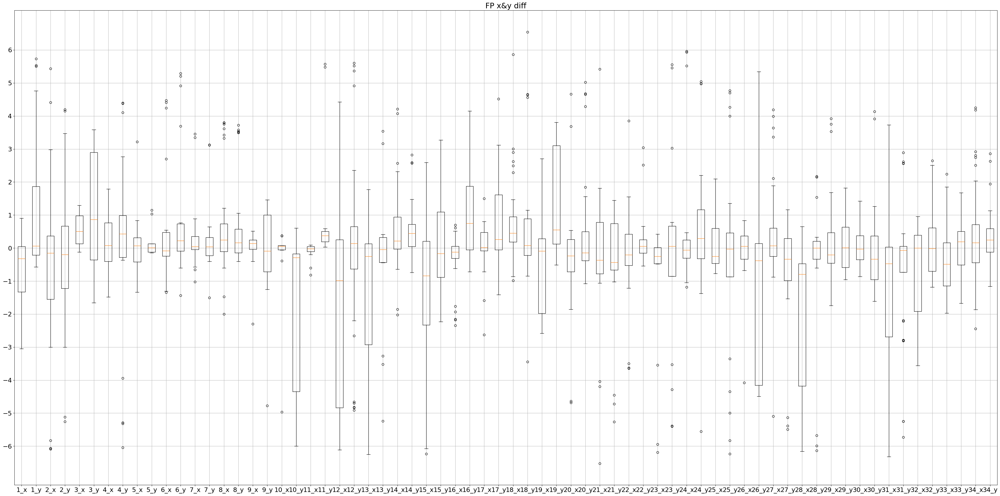

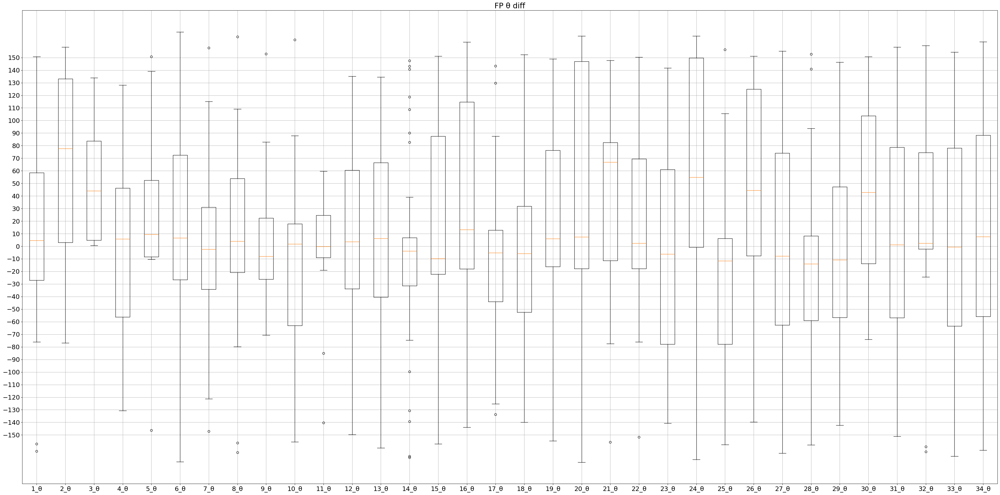

In [ ]:
fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
ax.boxplot(ED_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('ED x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(ED_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('ED θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(EP_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('EP x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(EP_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('EP θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FD_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('FD x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FD_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('FD θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FP_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('FP x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FP_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('FP θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

## SVCで高確率と判断されたバイポーラ間の差分

In [ ]:
diffs = []
for list_session1 in vpolars:
    for list_session2 in vpolars:
        if list_session1['subject'] == list_session2['subject'] and list_session1['session'] == 1 and list_session2['session'] == 2 and list_session1['gesture'] == list_session2['gesture'] and list_session1['trial'] == list_session2['trial'] and list_session1['electrode_place'] == list_session2['electrode_place']:
            print(f'file_name: {list_session1["file_name"]}, gesture: {list_session1["gesture"]}, trial: {list_session1["trial"]}, subject: {list_session1["subject"]}, session: {list_session1["session"]}, electrode_place: {list_session1["electrode_place"]}')
            print(f'file_name: {list_session2["file_name"]}, gesture: {list_session2["gesture"]}, trial: {list_session2["trial"]}, subject: {list_session2["subject"]}, session: {list_session2["session"]}, electrode_place: {list_session2["electrode_place"]}')
            if list_session1['n_virtual_bipolars'] > 0 and list_session2['n_virtual_bipolars'] > 0:
                record_session1 = wfdb.rdrecord(list_session1["file_name"])
                record_session2 = wfdb.rdrecord(list_session2["file_name"])

                if list_session1['electrode_place'] == 'ED':
                    emg_data_session1 = record_session1.p_signal[:,:64] #Extensor Distal
                    emg_data_session2 = record_session2.p_signal[:,:64] #Extensor Distal
                elif list_session1['electrode_place'] == 'EP':
                    emg_data_session1 = record_session1.p_signal[:,64:128] #Extensor Proximal
                    emg_data_session2 = record_session2.p_signal[:,64:128] #Extensor Proximal
                elif list_session1['electrode_place'] == 'FD':
                    emg_data_session1 = record_session1.p_signal[:,128:192] #Flexor Distal
                    emg_data_session2 = record_session2.p_signal[:,128:192] #Flexor Distal
                elif list_session1['electrode_place'] == 'FP':
                    emg_data_session1 = record_session1.p_signal[:,192:256] #Flexor Proximal
                    emg_data_session2 = record_session2.p_signal[:,192:256] #Flexor Proximal

                virtual_bipolars_session1 = list_session1['virtual_bipolars']
                virtual_bipolars_session2 = list_session2['virtual_bipolars']
                labels_session1 = list_session1['labels']
                labels_session2 = list_session2['labels']
                center_direction_session1 = list_session1['center_direction']
                center_direction_session2 = list_session2['center_direction']

                if list_session1['n_virtual_bipolars'] == 1:
                    virtual_bipolars_session1.append([0,0,0,0])
                    labels_session1.append(999)
                    center_direction_session1.append([0,0,0])

                virtual_emg_session1 = get_virtual_emg(emg_data_session1, virtual_bipolars_session1)
                X_session1, y_session1 = get_features(virtual_emg_session1, labels_session1)

                virtual_emg_session2 = get_virtual_emg(emg_data_session2, virtual_bipolars_session2)
                X_session2, y_session2 = get_features(virtual_emg_session2, labels_session2)

                result, y_train, y_test = SVC_classifier(X_session1, y_session1, X_session2, y_session2)
                diff = diff_analyzer(result, y_train, y_test, center_direction_session1, center_direction_session2)
            else:
                diff = [None]
            diffs.append({'file_name':[list_session1["file_name"], list_session2["file_name"]],'subject':list_session1['subject'], 'gesture':list_session1['gesture'], 'trial': list_session1['trial'], 'electrode_place':list_session1['electrode_place'], 'diff':diff})


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 1, session: 2, electrode_place: ED
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 1, session: 2, electrode_place: EP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 1, session: 2, electrode_place: FD
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 1, session: 2, electrode_place: FP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample6, gesture: 3, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample6, gesture: 3, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample6, gesture: 3, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample6, gesture: 3, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample6, gesture: 3, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample6, gesture: 3, trial: 2, subject: 1, session: 2, electrode_place: FD
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample6, gesture: 3, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample6, gesture: 3, trial: 2, subject: 1, session: 2, electrode_place: FP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample7, gesture: 4, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample7, gesture: 4, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample7, gesture: 4, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample7, gesture: 4, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample7, gesture: 4, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample7, gesture: 4, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample7, gesture: 4, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample7, gesture: 4, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample9, gesture: 5, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample9, gesture: 5, trial: 1, subject: 1, session: 2, electrode_place: ED
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample9, gesture: 5, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample9, gesture: 5, trial: 1, subject: 1, session: 2, electrode_place: EP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample9, gesture: 5, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample9, gesture: 5, trial: 1, subject: 1, session: 2, electrode_place: FD
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample9, gesture: 5, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subje

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample10, gesture: 5, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample10, gesture: 5, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample11, gesture: 6, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample11, gesture: 6, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample11, gesture: 6, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample11, gesture: 6, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample11, gesture: 6, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample11, gesture: 6, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample11, gesture: 6, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample11, gesture: 6, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample17, gesture: 9, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample17, gesture: 9, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample17, gesture: 9, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample17, gesture: 9, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample17, gesture: 9, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample17, gesture: 9, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample17, gesture: 9, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample17, gesture: 9, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 1, session: 2, electrode_place: ED
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 1, session: 2, electrode_place: EP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 1, session: 2, electrode_place: FD
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 1, session: 2, electrode_place: FP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 1, session: 2, electrode_place: FD
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 1, session: 2, electrode_place: FP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample22, gesture: 11, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample22, gesture: 11, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample22, gesture: 11, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample22, gesture: 11, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample22, gesture: 11, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample22, gesture: 11, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample22, gesture: 11, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample22, gesture: 11, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample23, gesture: 12, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample23, gesture: 12, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample23, gesture: 12, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample23, gesture: 12, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample23, gesture: 12, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample23, gesture: 12, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample23, gesture: 12, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample23, gesture: 12, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample26, gesture: 13, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample26, gesture: 13, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample26, gesture: 13, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample26, gesture: 13, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample26, gesture: 13, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample26, gesture: 13, trial: 2, subject: 1, session: 2, electrode_place: FD
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample26, gesture: 13, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample26, gesture: 13, trial: 2, subject: 1, session: 2, electrode_place: FP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample27, gesture: 14, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample27, gesture: 14, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample27, gesture: 14, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample27, gesture: 14, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample27, gesture: 14, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample27, gesture: 14, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample27, gesture: 14, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample27, gesture: 14, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 1, session: 2, electrode_place: ED
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 1, session: 2, electrode_place: EP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample30, gesture: 15, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample30, gesture: 15, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample30, gesture: 15, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample30, gesture: 15, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample30, gesture: 15, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample30, gesture: 15, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample30, gesture: 15, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample30, gesture: 15, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample31, gesture: 16, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample31, gesture: 16, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample31, gesture: 16, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample31, gesture: 16, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample31, gesture: 16, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample31, gesture: 16, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample31, gesture: 16, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample31, gesture: 16, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample32, gesture: 16, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample32, gesture: 16, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample32, gesture: 16, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample32, gesture: 16, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample32, gesture: 16, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample32, gesture: 16, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample32, gesture: 16, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample32, gesture: 16, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample33, gesture: 17, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample33, gesture: 17, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample33, gesture: 17, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample33, gesture: 17, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample33, gesture: 17, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample33, gesture: 17, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample33, gesture: 17, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample33, gesture: 17, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample34, gesture: 17, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample34, gesture: 17, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample34, gesture: 17, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample34, gesture: 17, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample34, gesture: 17, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample34, gesture: 17, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample34, gesture: 17, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample34, gesture: 17, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample35, gesture: 18, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample35, gesture: 18, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample35, gesture: 18, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample35, gesture: 18, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample35, gesture: 18, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample35, gesture: 18, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample35, gesture: 18, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample35, gesture: 18, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample36, gesture: 18, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample36, gesture: 18, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample36, gesture: 18, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample36, gesture: 18, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample36, gesture: 18, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample36, gesture: 18, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample36, gesture: 18, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample36, gesture: 18, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample37, gesture: 19, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample37, gesture: 19, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample37, gesture: 19, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample37, gesture: 19, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample37, gesture: 19, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample37, gesture: 19, trial: 1, subject: 1, session: 2, electrode_place: FD
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample37, gesture: 19, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample37, gesture: 19, trial: 1, subject: 1, session: 2, electrode_place: FP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample38, gesture: 19, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample38, gesture: 19, trial: 2, subject: 1, session: 2, electrode_place: ED
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample38, gesture: 19, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample38, gesture: 19, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample38, gesture: 19, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample39, gesture: 20, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample39, gesture: 20, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample39, gesture: 20, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample39, gesture: 20, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample39, gesture: 20, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample39, gesture: 20, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample39, gesture: 20, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample39, gesture: 20, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample40, gesture: 20, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample40, gesture: 20, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample40, gesture: 20, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample40, gesture: 20, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample40, gesture: 20, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample40, gesture: 20, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample40, gesture: 20, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample40, gesture: 20, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample41, gesture: 21, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample41, gesture: 21, trial: 1, subject: 1, session: 2, electrode_place: ED
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample41, gesture: 21, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample41, gesture: 21, trial: 1, subject: 1, session: 2, electrode_place: EP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample41, gesture: 21, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample41, gesture: 21, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample41, gesture: 21, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample41, gesture: 21, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample42, gesture: 21, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample42, gesture: 21, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample42, gesture: 21, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample42, gesture: 21, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample42, gesture: 21, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample42, gesture: 21, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample42, gesture: 21, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample42, gesture: 21, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample43, gesture: 22, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample43, gesture: 22, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample43, gesture: 22, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample43, gesture: 22, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample43, gesture: 22, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample43, gesture: 22, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample43, gesture: 22, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample43, gesture: 22, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample44, gesture: 22, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample44, gesture: 22, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample44, gesture: 22, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample44, gesture: 22, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample44, gesture: 22, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample44, gesture: 22, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample44, gesture: 22, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample44, gesture: 22, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample45, gesture: 23, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample45, gesture: 23, trial: 1, subject: 1, session: 2, electrode_place: ED
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample45, gesture: 23, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample45, gesture: 23, trial: 1, subject: 1, session: 2, electrode_place: EP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample45, gesture: 23, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample45, gesture: 23, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample45, gesture: 23, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample45, gesture: 23, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample46, gesture: 23, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample46, gesture: 23, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample46, gesture: 23, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample46, gesture: 23, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample46, gesture: 23, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample46, gesture: 23, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample46, gesture: 23, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample46, gesture: 23, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample47, gesture: 24, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample47, gesture: 24, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample47, gesture: 24, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample47, gesture: 24, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample47, gesture: 24, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample47, gesture: 24, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample47, gesture: 24, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample47, gesture: 24, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample48, gesture: 24, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample48, gesture: 24, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample48, gesture: 24, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample48, gesture: 24, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample48, gesture: 24, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample48, gesture: 24, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample48, gesture: 24, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample48, gesture: 24, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample51, gesture: 26, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample49, gesture: 26, trial: 1, subject: 1, session: 2, electrode_place: ED
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample51, gesture: 26, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample49, gesture: 26, trial: 1, subject: 1, session: 2, electrode_place: EP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample51, gesture: 26, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample49, gesture: 26, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample51, gesture: 26, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample49, gesture: 26, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample52, gesture: 26, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample50, gesture: 26, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample52, gesture: 26, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample50, gesture: 26, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample52, gesture: 26, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample50, gesture: 26, trial: 2, subject: 1, session: 2, electrode_place: FD
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample52, gesture: 26, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample50, gesture: 26, trial: 2, subject: 1, session: 2, electrode_place: FP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample53, gesture: 27, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample51, gesture: 27, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample53, gesture: 27, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample51, gesture: 27, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample53, gesture: 27, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample51, gesture: 27, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample53, gesture: 27, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample51, gesture: 27, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample54, gesture: 27, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample52, gesture: 27, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample54, gesture: 27, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample52, gesture: 27, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample54, gesture: 27, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample52, gesture: 27, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample54, gesture: 27, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample52, gesture: 27, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample55, gesture: 28, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample53, gesture: 28, trial: 1, subject: 1, session: 2, electrode_place: ED
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample55, gesture: 28, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample53, gesture: 28, trial: 1, subject: 1, session: 2, electrode_place: EP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample55, gesture: 28, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample53, gesture: 28, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample55, gesture: 28, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample53, gesture: 28, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample56, gesture: 28, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample54, gesture: 28, trial: 2, subject: 1, session: 2, electrode_place: ED
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample56, gesture: 28, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample54, gesture: 28, trial: 2, subject: 1, session: 2, electrode_place: EP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample56, gesture: 28, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample54, gesture: 28, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample56, gesture: 28, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample54, gesture: 28, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample57, gesture: 29, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample55, gesture: 29, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample57, gesture: 29, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample55, gesture: 29, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample57, gesture: 29, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample55, gesture: 29, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample57, gesture: 29, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample55, gesture: 29, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample58, gesture: 29, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample56, gesture: 29, trial: 2, subject: 1, session: 2, electrode_place: ED
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample58, gesture: 29, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample56, gesture: 29, trial: 2, subject: 1, session: 2, electrode_place: EP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample58, gesture: 29, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample56, gesture: 29, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample58, gesture: 29, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample56, gesture: 29, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample59, gesture: 30, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample57, gesture: 30, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample59, gesture: 30, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample57, gesture: 30, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample59, gesture: 30, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample57, gesture: 30, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample59, gesture: 30, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample57, gesture: 30, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample60, gesture: 30, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample58, gesture: 30, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample60, gesture: 30, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample58, gesture: 30, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample60, gesture: 30, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample58, gesture: 30, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample60, gesture: 30, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample58, gesture: 30, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample61, gesture: 31, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample59, gesture: 31, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample61, gesture: 31, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample59, gesture: 31, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample61, gesture: 31, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample59, gesture: 31, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample61, gesture: 31, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample59, gesture: 31, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample62, gesture: 31, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample60, gesture: 31, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample62, gesture: 31, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample60, gesture: 31, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample62, gesture: 31, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample60, gesture: 31, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample62, gesture: 31, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample60, gesture: 31, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample63, gesture: 32, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample61, gesture: 32, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample63, gesture: 32, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample61, gesture: 32, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample63, gesture: 32, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample61, gesture: 32, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample63, gesture: 32, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample61, gesture: 32, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample64, gesture: 32, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample62, gesture: 32, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample64, gesture: 32, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample62, gesture: 32, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample64, gesture: 32, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample62, gesture: 32, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample64, gesture: 32, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample62, gesture: 32, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample65, gesture: 33, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample63, gesture: 33, trial: 1, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample65, gesture: 33, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample63, gesture: 33, trial: 1, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample65, gesture: 33, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample63, gesture: 33, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample65, gesture: 33, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample63, gesture: 33, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample66, gesture: 33, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample64, gesture: 33, trial: 2, subject: 1, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample66, gesture: 33, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample64, gesture: 33, trial: 2, subject: 1, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample66, gesture: 33, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample64, gesture: 33, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample66, gesture: 33, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample64, gesture: 33, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample67, gesture: 34, trial: 1, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample65, gesture: 34, trial: 1, subject: 1, session: 2, electrode_place: ED
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample67, gesture: 34, trial: 1, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample65, gesture: 34, trial: 1, subject: 1, session: 2, electrode_place: EP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample67, gesture: 34, trial: 1, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample65, gesture: 34, trial: 1, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample67, gesture: 34, trial: 1, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample65, gesture: 34, trial: 1, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample68, gesture: 34, trial: 2, subject: 1, session: 1, electrode_place: ED
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample66, gesture: 34, trial: 2, subject: 1, session: 2, electrode_place: ED
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample68, gesture: 34, trial: 2, subject: 1, session: 1, electrode_place: EP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample66, gesture: 34, trial: 2, subject: 1, session: 2, electrode_place: EP
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample68, gesture: 34, trial: 2, subject: 1, session: 1, electrode_place: FD
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample66, gesture: 34, trial: 2, subject: 1, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample68, gesture: 34, trial: 2, subject: 1, session: 1, electrode_place: FP
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample66, gesture: 34, trial: 2, subject: 1, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 2, session: 2, electrode_place: FD
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subje

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample7, gesture: 4, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample7, gesture: 4, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample7, gesture: 4, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample7, gesture: 4, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample7, gesture: 4, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample7, gesture: 4, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample8, gesture: 4, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample9, gesture: 5, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample9, gesture: 5, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample9, gesture: 5, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample9, gesture: 5, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample9, gesture: 5, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample9, gesture: 5, trial: 1, subject: 2, session: 2, electrode_place: FD
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample9, gesture: 5, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subje

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample11, gesture: 6, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample11, gesture: 6, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample11, gesture: 6, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample11, gesture: 6, trial: 1, subject: 2, session: 2, electrode_place: FD
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample11, gesture: 6, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample11, gesture: 6, trial: 1, subject: 2, session: 2, electrode_place: FP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample12, gesture: 6, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 2, session: 2, electrode_place: FD
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample13, gesture: 7, trial: 1, subject: 2, session: 2, electrode_place: FP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample14, gesture: 7, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample15, gesture: 8, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 2, session: 2, electrode_place: FD
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample16, gesture: 8, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_datase

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample17, gesture: 9, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample17, gesture: 9, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample17, gesture: 9, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample17, gesture: 9, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample17, gesture: 9, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample17, gesture: 9, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 2, session: 2, electrode_place: FD
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample18, gesture: 9, trial: 2, subject: 2, session: 2, electrode_place: FP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 2, session: 2, electrode_place: FD
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample19, gesture: 10, trial: 1, subject: 2, session: 2, electrode_place: FP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample20, gesture: 10, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 2, session: 2, electrode_place: FD
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample21, gesture: 11, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample23, gesture: 12, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample23, gesture: 12, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample23, gesture: 12, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample23, gesture: 12, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample23, gesture: 12, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample23, gesture: 12, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample24, gesture: 12, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 2, session: 2, electrode_place: FD
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample25, gesture: 13, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample27, gesture: 14, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample27, gesture: 14, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample27, gesture: 14, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample27, gesture: 14, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample27, gesture: 14, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample27, gesture: 14, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample28, gesture: 14, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample29, gesture: 15, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample30, gesture: 16, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample31, gesture: 16, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample30, gesture: 16, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample31, gesture: 16, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample30, gesture: 16, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample31, gesture: 16, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample30, gesture: 16, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample31, gesture: 16, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample31, gesture: 16, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample32, gesture: 16, trial: 2, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample31, gesture: 16, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample32, gesture: 16, trial: 2, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample31, gesture: 16, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample32, gesture: 16, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample31, gesture: 16, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample32, gesture: 16, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample32, gesture: 17, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample33, gesture: 17, trial: 1, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample32, gesture: 17, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample33, gesture: 17, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample32, gesture: 17, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample33, gesture: 17, trial: 1, subject: 2, session: 2, electrode_place: FD
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample32, gesture: 17, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample33, gesture: 17, trial: 1, subject: 2, session: 2, electrode_place: FP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample33, gesture: 17, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample34, gesture: 17, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample33, gesture: 17, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample34, gesture: 17, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample33, gesture: 17, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample34, gesture: 17, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample33, gesture: 17, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample34, gesture: 17, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample34, gesture: 18, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample35, gesture: 18, trial: 1, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample34, gesture: 18, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample35, gesture: 18, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample34, gesture: 18, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample35, gesture: 18, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample34, gesture: 18, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample35, gesture: 18, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample35, gesture: 18, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample36, gesture: 18, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample35, gesture: 18, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample36, gesture: 18, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample35, gesture: 18, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample36, gesture: 18, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample35, gesture: 18, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample36, gesture: 18, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample36, gesture: 19, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample37, gesture: 19, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample36, gesture: 19, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample37, gesture: 19, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample36, gesture: 19, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample37, gesture: 19, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample36, gesture: 19, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample37, gesture: 19, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample37, gesture: 19, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample38, gesture: 19, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample37, gesture: 19, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample38, gesture: 19, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample37, gesture: 19, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample38, gesture: 19, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample37, gesture: 19, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample38, gesture: 19, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample38, gesture: 20, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample39, gesture: 20, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample38, gesture: 20, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample39, gesture: 20, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample38, gesture: 20, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample39, gesture: 20, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample38, gesture: 20, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample39, gesture: 20, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample39, gesture: 20, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample40, gesture: 20, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample39, gesture: 20, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample40, gesture: 20, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample39, gesture: 20, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample40, gesture: 20, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample39, gesture: 20, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample40, gesture: 20, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample40, gesture: 21, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample41, gesture: 21, trial: 1, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample40, gesture: 21, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample41, gesture: 21, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample40, gesture: 21, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample41, gesture: 21, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample40, gesture: 21, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample41, gesture: 21, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample41, gesture: 21, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample42, gesture: 21, trial: 2, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample41, gesture: 21, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample42, gesture: 21, trial: 2, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample41, gesture: 21, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample42, gesture: 21, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample41, gesture: 21, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample42, gesture: 21, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample42, gesture: 22, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample43, gesture: 22, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample42, gesture: 22, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample43, gesture: 22, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample42, gesture: 22, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample43, gesture: 22, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample42, gesture: 22, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample43, gesture: 22, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample43, gesture: 22, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample44, gesture: 22, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample43, gesture: 22, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample44, gesture: 22, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample43, gesture: 22, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample44, gesture: 22, trial: 2, subject: 2, session: 2, electrode_place: FD
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample43, gesture: 22, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample44, gesture: 22, trial: 2, subject: 2, session: 2, electrode_place: FP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample44, gesture: 23, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample45, gesture: 23, trial: 1, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample44, gesture: 23, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample45, gesture: 23, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample44, gesture: 23, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample45, gesture: 23, trial: 1, subject: 2, session: 2, electrode_place: FD
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample44, gesture: 23, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample45, gesture: 23, trial: 1, subject: 2, session: 2, electrode_place: FP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample45, gesture: 23, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample46, gesture: 23, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample45, gesture: 23, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample46, gesture: 23, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample45, gesture: 23, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample46, gesture: 23, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample45, gesture: 23, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample46, gesture: 23, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample46, gesture: 24, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample47, gesture: 24, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample46, gesture: 24, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample47, gesture: 24, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample46, gesture: 24, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample47, gesture: 24, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample46, gesture: 24, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample47, gesture: 24, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample47, gesture: 24, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample48, gesture: 24, trial: 2, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample47, gesture: 24, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample48, gesture: 24, trial: 2, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample47, gesture: 24, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample48, gesture: 24, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample47, gesture: 24, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample48, gesture: 24, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample48, gesture: 25, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample49, gesture: 25, trial: 1, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample48, gesture: 25, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample49, gesture: 25, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample48, gesture: 25, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample49, gesture: 25, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample48, gesture: 25, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample49, gesture: 25, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample49, gesture: 25, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample50, gesture: 25, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample49, gesture: 25, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample50, gesture: 25, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample49, gesture: 25, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample50, gesture: 25, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample49, gesture: 25, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample50, gesture: 25, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample50, gesture: 26, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample51, gesture: 26, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample50, gesture: 26, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample51, gesture: 26, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample50, gesture: 26, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample51, gesture: 26, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample50, gesture: 26, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample51, gesture: 26, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample51, gesture: 26, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample52, gesture: 26, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample51, gesture: 26, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample52, gesture: 26, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample51, gesture: 26, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample52, gesture: 26, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample51, gesture: 26, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample52, gesture: 26, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample52, gesture: 27, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample53, gesture: 27, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample52, gesture: 27, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample53, gesture: 27, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample52, gesture: 27, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample53, gesture: 27, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample52, gesture: 27, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample53, gesture: 27, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample53, gesture: 27, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample54, gesture: 27, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample53, gesture: 27, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample54, gesture: 27, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample53, gesture: 27, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample54, gesture: 27, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample53, gesture: 27, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample54, gesture: 27, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample54, gesture: 28, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample55, gesture: 28, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample54, gesture: 28, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample55, gesture: 28, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample54, gesture: 28, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample55, gesture: 28, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample54, gesture: 28, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample55, gesture: 28, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample55, gesture: 28, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample56, gesture: 28, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample55, gesture: 28, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample56, gesture: 28, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample55, gesture: 28, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample56, gesture: 28, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample55, gesture: 28, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample56, gesture: 28, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample56, gesture: 29, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample57, gesture: 29, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample56, gesture: 29, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample57, gesture: 29, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample56, gesture: 29, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample57, gesture: 29, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample56, gesture: 29, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample57, gesture: 29, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample57, gesture: 29, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample58, gesture: 29, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample57, gesture: 29, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample58, gesture: 29, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample57, gesture: 29, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample58, gesture: 29, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample57, gesture: 29, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample58, gesture: 29, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample58, gesture: 30, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample59, gesture: 30, trial: 1, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample58, gesture: 30, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample59, gesture: 30, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample58, gesture: 30, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample59, gesture: 30, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample58, gesture: 30, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample59, gesture: 30, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample59, gesture: 30, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample60, gesture: 30, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample59, gesture: 30, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample60, gesture: 30, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample59, gesture: 30, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample60, gesture: 30, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample59, gesture: 30, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample60, gesture: 30, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample60, gesture: 31, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample61, gesture: 31, trial: 1, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample60, gesture: 31, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample61, gesture: 31, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample60, gesture: 31, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample61, gesture: 31, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample60, gesture: 31, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample61, gesture: 31, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample61, gesture: 31, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample62, gesture: 31, trial: 2, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample61, gesture: 31, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample62, gesture: 31, trial: 2, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample61, gesture: 31, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample62, gesture: 31, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample61, gesture: 31, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample62, gesture: 31, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample62, gesture: 32, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample63, gesture: 32, trial: 1, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample62, gesture: 32, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample63, gesture: 32, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample62, gesture: 32, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample63, gesture: 32, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample62, gesture: 32, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample63, gesture: 32, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample63, gesture: 32, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample64, gesture: 32, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample63, gesture: 32, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample64, gesture: 32, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample63, gesture: 32, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample64, gesture: 32, trial: 2, subject: 2, session: 2, electrode_place: FD
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample63, gesture: 32, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample64, gesture: 32, trial: 2, subject: 2, session: 2, electrode_place: FP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample64, gesture: 33, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample65, gesture: 33, trial: 1, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample64, gesture: 33, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample65, gesture: 33, trial: 1, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample64, gesture: 33, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample65, gesture: 33, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample64, gesture: 33, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample65, gesture: 33, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample65, gesture: 33, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample66, gesture: 33, trial: 2, subject: 2, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample65, gesture: 33, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample66, gesture: 33, trial: 2, subject: 2, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample65, gesture: 33, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample66, gesture: 33, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample65, gesture: 33, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample66, gesture: 33, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample66, gesture: 34, trial: 1, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample67, gesture: 34, trial: 1, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample66, gesture: 34, trial: 1, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample67, gesture: 34, trial: 1, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample66, gesture: 34, trial: 1, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample67, gesture: 34, trial: 1, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample66, gesture: 34, trial: 1, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample67, gesture: 34, trial: 1, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample67, gesture: 34, trial: 2, subject: 2, session: 1, electrode_place: ED
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample68, gesture: 34, trial: 2, subject: 2, session: 2, electrode_place: ED
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample67, gesture: 34, trial: 2, subject: 2, session: 1, electrode_place: EP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample68, gesture: 34, trial: 2, subject: 2, session: 2, electrode_place: EP
file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample67, gesture: 34, trial: 2, subject: 2, session: 1, electrode_place: FD
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample68, gesture: 34, trial: 2, subject: 2, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject02_session1/maintenance_preprocess_sample67, gesture: 34, trial: 2, subject: 2, session: 1, electrode_place: FP
file_name: pr_dataset/subject02_session2/maintenance_preprocess_sample68, gesture: 34, trial: 2, subject: 2, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 3, session: 2, electrode_place: FP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample3, gesture: 2, trial: 1, subject: 3, session: 2, electrode_place: FP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample4, gesture: 2, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample5, gesture: 3, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subje

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample6, gesture: 3, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample6, gesture: 3, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample6, gesture: 3, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample6, gesture: 3, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample6, gesture: 3, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample6, gesture: 3, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample7, gesture: 5, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample7, gesture: 5, trial: 1, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample7, gesture: 5, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample7, gesture: 5, trial: 1, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample7, gesture: 5, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample7, gesture: 5, trial: 1, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample7, gesture: 5, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subje

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample8, gesture: 5, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample8, gesture: 5, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample8, gesture: 5, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample8, gesture: 5, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample8, gesture: 5, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample8, gesture: 5, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample9, gesture: 6, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample9, gesture: 6, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample9, gesture: 6, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample9, gesture: 6, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample9, gesture: 6, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample9, gesture: 6, trial: 1, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample9, gesture: 6, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample9, gesture: 6, trial: 1, subject: 3, session: 2, electrode_place: FP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample10, gesture: 6, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample10, gesture: 6, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample10, gesture: 6, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample10, gesture: 6, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample10, gesture: 6, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample10, gesture: 6, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample10, gesture: 6, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample10, gesture: 6, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample11, gesture: 7, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample11, gesture: 7, trial: 1, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample11, gesture: 7, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample11, gesture: 7, trial: 1, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample11, gesture: 7, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample11, gesture: 7, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample11, gesture: 7, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample11, gesture: 7, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample12, gesture: 7, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample12, gesture: 7, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample12, gesture: 7, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample12, gesture: 7, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample12, gesture: 7, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample12, gesture: 7, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample12, gesture: 7, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample12, gesture: 7, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample13, gesture: 8, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample13, gesture: 8, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample13, gesture: 8, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample13, gesture: 8, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample13, gesture: 8, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample13, gesture: 8, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample13, gesture: 8, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample13, gesture: 8, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample14, gesture: 8, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample14, gesture: 8, trial: 2, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample14, gesture: 8, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample14, gesture: 8, trial: 2, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample14, gesture: 8, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample14, gesture: 8, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample14, gesture: 8, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample14, gesture: 8, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample15, gesture: 9, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample15, gesture: 9, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample15, gesture: 9, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample15, gesture: 9, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample15, gesture: 9, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample15, gesture: 9, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample15, gesture: 9, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample15, gesture: 9, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample16, gesture: 9, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample16, gesture: 9, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample16, gesture: 9, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample16, gesture: 9, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample16, gesture: 9, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample16, gesture: 9, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample16, gesture: 9, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample16, gesture: 9, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample17, gesture: 10, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample17, gesture: 10, trial: 1, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample17, gesture: 10, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample17, gesture: 10, trial: 1, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample17, gesture: 10, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample17, gesture: 10, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample17, gesture: 10, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample17, gesture: 10, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample18, gesture: 10, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample18, gesture: 10, trial: 2, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample18, gesture: 10, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample18, gesture: 10, trial: 2, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample18, gesture: 10, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample18, gesture: 10, trial: 2, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample18, gesture: 10, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample19, gesture: 11, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample19, gesture: 11, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample19, gesture: 11, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample19, gesture: 11, trial: 1, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample19, gesture: 11, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample19, gesture: 11, trial: 1, subject: 3, session: 2, electrode_place: FP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample20, gesture: 11, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample20, gesture: 11, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample20, gesture: 11, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample20, gesture: 11, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample20, gesture: 11, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample20, gesture: 11, trial: 2, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample20, gesture: 11, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample20, gesture: 11, trial: 2, subject: 3, session: 2, electrode_place: FP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample21, gesture: 12, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample21, gesture: 12, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample21, gesture: 12, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample21, gesture: 12, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample21, gesture: 12, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample21, gesture: 12, trial: 1, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample21, gesture: 12, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample21, gesture: 12, trial: 1, subject: 3, session: 2, electrode_place: FP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample22, gesture: 12, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample22, gesture: 12, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample22, gesture: 12, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample22, gesture: 12, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample22, gesture: 12, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample22, gesture: 12, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample22, gesture: 12, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample22, gesture: 12, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample23, gesture: 13, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample23, gesture: 13, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample23, gesture: 13, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample23, gesture: 13, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample23, gesture: 13, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample23, gesture: 13, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample23, gesture: 13, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample23, gesture: 13, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample24, gesture: 13, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample24, gesture: 13, trial: 2, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample24, gesture: 13, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample24, gesture: 13, trial: 2, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample24, gesture: 13, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample24, gesture: 13, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample24, gesture: 13, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample24, gesture: 13, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample25, gesture: 14, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample25, gesture: 14, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample25, gesture: 14, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample25, gesture: 14, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample25, gesture: 14, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample25, gesture: 14, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample25, gesture: 14, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample25, gesture: 14, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample26, gesture: 14, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample26, gesture: 14, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample26, gesture: 14, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample26, gesture: 14, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample26, gesture: 14, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample26, gesture: 14, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample26, gesture: 14, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample26, gesture: 14, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample27, gesture: 15, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample27, gesture: 15, trial: 1, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample27, gesture: 15, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample27, gesture: 15, trial: 1, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample27, gesture: 15, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample27, gesture: 15, trial: 1, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample27, gesture: 15, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample28, gesture: 15, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample28, gesture: 15, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample28, gesture: 15, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample28, gesture: 15, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample28, gesture: 15, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample28, gesture: 15, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample29, gesture: 16, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample29, gesture: 16, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample29, gesture: 16, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample29, gesture: 16, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample29, gesture: 16, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample29, gesture: 16, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample29, gesture: 16, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample29, gesture: 16, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample30, gesture: 16, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample30, gesture: 16, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample30, gesture: 16, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample30, gesture: 16, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample30, gesture: 16, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample30, gesture: 16, trial: 2, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample30, gesture: 16, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample30, gesture: 16, trial: 2, subject: 3, session: 2, electrode_place: FP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample31, gesture: 17, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample31, gesture: 17, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample31, gesture: 17, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample31, gesture: 17, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample31, gesture: 17, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample31, gesture: 17, trial: 1, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample31, gesture: 17, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample31, gesture: 17, trial: 1, subject: 3, session: 2, electrode_place: FP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample32, gesture: 17, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample32, gesture: 17, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample32, gesture: 17, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample32, gesture: 17, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample32, gesture: 17, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample32, gesture: 17, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample32, gesture: 17, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample32, gesture: 17, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample33, gesture: 18, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample33, gesture: 18, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample33, gesture: 18, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample33, gesture: 18, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample33, gesture: 18, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample33, gesture: 18, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample33, gesture: 18, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample33, gesture: 18, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample34, gesture: 18, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample34, gesture: 18, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample34, gesture: 18, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample34, gesture: 18, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample34, gesture: 18, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample34, gesture: 18, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample34, gesture: 18, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample34, gesture: 18, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample35, gesture: 19, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample35, gesture: 19, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample35, gesture: 19, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample35, gesture: 19, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample35, gesture: 19, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample35, gesture: 19, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample35, gesture: 19, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample35, gesture: 19, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample36, gesture: 19, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample36, gesture: 19, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample36, gesture: 19, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample36, gesture: 19, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample36, gesture: 19, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample36, gesture: 19, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample36, gesture: 19, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample36, gesture: 19, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample37, gesture: 20, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample37, gesture: 20, trial: 1, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample37, gesture: 20, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample37, gesture: 20, trial: 1, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample37, gesture: 20, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample37, gesture: 20, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample37, gesture: 20, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample37, gesture: 20, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample38, gesture: 20, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample38, gesture: 20, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample38, gesture: 20, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample38, gesture: 20, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample38, gesture: 20, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample38, gesture: 20, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample38, gesture: 20, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample38, gesture: 20, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample39, gesture: 21, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample39, gesture: 21, trial: 1, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample39, gesture: 21, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample39, gesture: 21, trial: 1, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample39, gesture: 21, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample39, gesture: 21, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample39, gesture: 21, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample39, gesture: 21, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample40, gesture: 21, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample40, gesture: 21, trial: 2, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample40, gesture: 21, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample40, gesture: 21, trial: 2, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample40, gesture: 21, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample40, gesture: 21, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample40, gesture: 21, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample40, gesture: 21, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample41, gesture: 22, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample41, gesture: 22, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample41, gesture: 22, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample41, gesture: 22, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample41, gesture: 22, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample41, gesture: 22, trial: 1, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample41, gesture: 22, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample41, gesture: 22, trial: 1, subject: 3, session: 2, electrode_place: FP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample42, gesture: 22, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample42, gesture: 22, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample42, gesture: 22, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample42, gesture: 22, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample42, gesture: 22, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample42, gesture: 22, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample42, gesture: 22, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample42, gesture: 22, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample43, gesture: 23, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample43, gesture: 23, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample43, gesture: 23, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample43, gesture: 23, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample43, gesture: 23, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample43, gesture: 23, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample43, gesture: 23, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample43, gesture: 23, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample44, gesture: 23, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample44, gesture: 23, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample44, gesture: 23, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample44, gesture: 23, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample44, gesture: 23, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample44, gesture: 23, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample44, gesture: 23, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample44, gesture: 23, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample45, gesture: 24, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample45, gesture: 24, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample45, gesture: 24, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample45, gesture: 24, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample45, gesture: 24, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample45, gesture: 24, trial: 1, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample45, gesture: 24, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample45, gesture: 24, trial: 1, subject: 3, session: 2, electrode_place: FP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample46, gesture: 24, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample46, gesture: 24, trial: 2, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample46, gesture: 24, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample47, gesture: 25, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample47, gesture: 25, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample47, gesture: 25, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample47, gesture: 25, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample47, gesture: 25, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample47, gesture: 25, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample48, gesture: 25, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample48, gesture: 25, trial: 2, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample48, gesture: 25, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample48, gesture: 25, trial: 2, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample48, gesture: 25, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample48, gesture: 25, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample48, gesture: 25, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample48, gesture: 25, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample49, gesture: 26, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample49, gesture: 26, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample49, gesture: 26, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample49, gesture: 26, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample49, gesture: 26, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample49, gesture: 26, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample49, gesture: 26, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample49, gesture: 26, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample50, gesture: 26, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample50, gesture: 26, trial: 2, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample50, gesture: 26, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample50, gesture: 26, trial: 2, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample50, gesture: 26, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample50, gesture: 26, trial: 2, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample50, gesture: 26, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample51, gesture: 27, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample51, gesture: 27, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample52, gesture: 27, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample52, gesture: 27, trial: 2, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample52, gesture: 27, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample52, gesture: 27, trial: 2, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample52, gesture: 27, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample52, gesture: 27, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample52, gesture: 27, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample52, gesture: 27, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample53, gesture: 28, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample53, gesture: 28, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample53, gesture: 28, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample53, gesture: 28, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample53, gesture: 28, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample53, gesture: 28, trial: 1, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample53, gesture: 28, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample53, gesture: 28, trial: 1, subject: 3, session: 2, electrode_place: FP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample54, gesture: 28, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample54, gesture: 28, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample54, gesture: 28, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample54, gesture: 28, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample54, gesture: 28, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample54, gesture: 28, trial: 2, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample54, gesture: 28, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample54, gesture: 28, trial: 2, subject: 3, session: 2, electrode_place: FP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample55, gesture: 29, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample55, gesture: 29, trial: 1, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample55, gesture: 29, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample55, gesture: 29, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample55, gesture: 29, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample56, gesture: 29, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample56, gesture: 29, trial: 2, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample56, gesture: 29, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample56, gesture: 29, trial: 2, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample56, gesture: 29, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample56, gesture: 29, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample56, gesture: 29, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample56, gesture: 29, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample57, gesture: 30, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample57, gesture: 30, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample57, gesture: 30, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample57, gesture: 30, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample57, gesture: 30, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample57, gesture: 30, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample57, gesture: 30, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample57, gesture: 30, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample58, gesture: 30, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample58, gesture: 30, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample58, gesture: 30, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample58, gesture: 30, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample58, gesture: 30, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample58, gesture: 30, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample58, gesture: 30, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample58, gesture: 30, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample59, gesture: 31, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample59, gesture: 31, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample59, gesture: 31, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample59, gesture: 31, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample59, gesture: 31, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample59, gesture: 31, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample59, gesture: 31, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample59, gesture: 31, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample60, gesture: 31, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample60, gesture: 31, trial: 2, subject: 3, session: 2, electrode_place: ED
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample60, gesture: 31, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample60, gesture: 31, trial: 2, subject: 3, session: 2, electrode_place: EP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample60, gesture: 31, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample60, gesture: 31, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample60, gesture: 31, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample60, gesture: 31, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample61, gesture: 32, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample61, gesture: 32, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample61, gesture: 32, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample61, gesture: 32, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample61, gesture: 32, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample61, gesture: 32, trial: 1, subject: 3, session: 2, electrode_place: FD
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample61, gesture: 32, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample61, gesture: 32, trial: 1, subject: 3, session: 2, electrode_place: FP
file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample62, gesture: 32, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample62, gesture: 32, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample62, gesture: 32, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample62, gesture: 32, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample62, gesture: 32, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample62, gesture: 32, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample62, gesture: 32, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample62, gesture: 32, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample63, gesture: 33, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample63, gesture: 33, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample63, gesture: 33, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample63, gesture: 33, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample63, gesture: 33, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample63, gesture: 33, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample63, gesture: 33, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample63, gesture: 33, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample64, gesture: 33, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample64, gesture: 33, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample64, gesture: 33, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample64, gesture: 33, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample64, gesture: 33, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample64, gesture: 33, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample64, gesture: 33, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample64, gesture: 33, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample65, gesture: 34, trial: 1, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample65, gesture: 34, trial: 1, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample65, gesture: 34, trial: 1, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample65, gesture: 34, trial: 1, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample65, gesture: 34, trial: 1, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample65, gesture: 34, trial: 1, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample65, gesture: 34, trial: 1, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample65, gesture: 34, trial: 1, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample66, gesture: 34, trial: 2, subject: 3, session: 1, electrode_place: ED
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample66, gesture: 34, trial: 2, subject: 3, session: 2, electrode_place: ED


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample66, gesture: 34, trial: 2, subject: 3, session: 1, electrode_place: EP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample66, gesture: 34, trial: 2, subject: 3, session: 2, electrode_place: EP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample66, gesture: 34, trial: 2, subject: 3, session: 1, electrode_place: FD
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample66, gesture: 34, trial: 2, subject: 3, session: 2, electrode_place: FD


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


file_name: pr_dataset/subject03_session1/maintenance_preprocess_sample66, gesture: 34, trial: 2, subject: 3, session: 1, electrode_place: FP
file_name: pr_dataset/subject03_session2/maintenance_preprocess_sample66, gesture: 34, trial: 2, subject: 3, session: 2, electrode_place: FP


c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [ ]:
x_ED_gesture = {}
y_ED_gesture = {}
theta_ED_gesture = {}
x_EP_gesture = {}
y_EP_gesture = {}
theta_EP_gesture = {}
x_FD_gesture = {}
y_FD_gesture = {}
theta_FD_gesture = {}
x_FP_gesture = {}
y_FP_gesture = {}
theta_FP_gesture = {}
n_gestures = 34
for i in range(n_gestures):
    x_ED_gesture[i+1] = []
    y_ED_gesture[i+1] = []
    theta_ED_gesture[i+1] = []
    x_EP_gesture[i+1] = []
    y_EP_gesture[i+1] = []
    theta_EP_gesture[i+1] = []
    x_FD_gesture[i+1] = []
    y_FD_gesture[i+1] = []
    theta_FD_gesture[i+1] = []
    x_FP_gesture[i+1] = []
    y_FP_gesture[i+1] = []
    theta_FP_gesture[i+1] = []

In [ ]:
for diff_list in diffs:
    print(diff_list)
    if diff_list['diff'] != [None]:
        gesture = int(diff_list['gesture'])
        electrode_place = diff_list['electrode_place']
        if electrode_place == 'ED':
            for diff in diff_list['diff']:
                x_ED_gesture[gesture].append(diff['x_diff'])
                y_ED_gesture[gesture].append(diff['y_diff'])
                theta_ED_gesture[gesture].append(diff['theta_diff'])
        elif electrode_place == 'EP':
            for diff in diff_list['diff']:
                x_EP_gesture[gesture].append(diff['x_diff'])
                y_EP_gesture[gesture].append(diff['y_diff'])
                theta_EP_gesture[gesture].append(diff['theta_diff'])
        elif electrode_place == 'FD':
            for diff in diff_list['diff']:
                x_FD_gesture[gesture].append(diff['x_diff'])
                y_FD_gesture[gesture].append(diff['y_diff'])
                theta_FD_gesture[gesture].append(diff['theta_diff'])
        elif electrode_place == 'FP':
            for diff in diff_list['diff']:
                x_FP_gesture[gesture].append(diff['x_diff'])
                y_FP_gesture[gesture].append(diff['y_diff'])
                theta_FP_gesture[gesture].append(diff['theta_diff'])

{'file_name': ['pr_dataset/subject01_session1/maintenance_preprocess_sample1', 'pr_dataset/subject01_session2/maintenance_preprocess_sample1'], 'subject': 1, 'gesture': '1', 'trial': 1, 'electrode_place': 'ED', 'diff': [{'train': 0, 'test': 30, 'x_diff': 3.8259491881339103, 'y_diff': 3.593425777750928, 'theta_diff': 132.32900987559782}, {'train': 30, 'test': 10, 'x_diff': -0.02485568984674824, 'y_diff': -0.05747863767190342, 'theta_diff': 9.093665741959128}]}
{'file_name': ['pr_dataset/subject01_session1/maintenance_preprocess_sample1', 'pr_dataset/subject01_session2/maintenance_preprocess_sample1'], 'subject': 1, 'gesture': '1', 'trial': 1, 'electrode_place': 'EP', 'diff': [{'train': 0, 'test': 21, 'x_diff': 1.7616270566401457, 'y_diff': 0.4469915498896686, 'theta_diff': -8.493755675951192}, {'train': 2, 'test': 30, 'x_diff': 3.530924984543368, 'y_diff': 3.6625367414750234, 'theta_diff': -12.84537657546042}, {'train': 30, 'test': 12, 'x_diff': -0.2999712066670277, 'y_diff': 0.35633135

In [ ]:
ED_xy_list = []
EP_xy_list = []
FD_xy_list = []
FP_xy_list = []
for i in range(n_gestures):
    ED_xy_list.append(x_ED_gesture[i+1])
    ED_xy_list.append(y_ED_gesture[i+1])
    # ED_list.append(theta_ED_gesture[i+1])
for i in range(n_gestures):
    EP_xy_list.append(x_EP_gesture[i+1])
    EP_xy_list.append(y_EP_gesture[i+1])
    # EP_list.append(theta_EP_gesture[i+1])
for i in range(n_gestures):
    FD_xy_list.append(x_FD_gesture[i+1])
    FD_xy_list.append(y_FD_gesture[i+1])
    # FD_list.append(theta_FD_gesture[i+1])
for i in range(n_gestures):
    FP_xy_list.append(x_FP_gesture[i+1])
    FP_xy_list.append(y_FP_gesture[i+1])
    # FP_list.append(theta_FP_gesture[i+1])

ED_theta_list = []
EP_theta_list = []
FD_theta_list = []
FP_theta_list = []
for i in range(n_gestures):
    ED_theta_list.append(theta_ED_gesture[i+1])
for i in range(n_gestures):
    EP_theta_list.append(theta_EP_gesture[i+1])
for i in range(n_gestures):
    FD_theta_list.append(theta_FD_gesture[i+1])
for i in range(n_gestures):
    FP_theta_list.append(theta_FP_gesture[i+1])


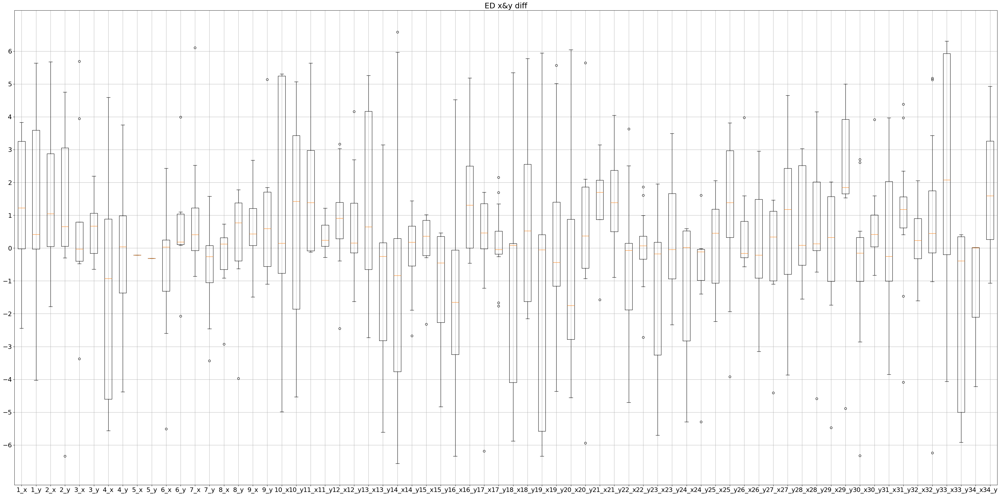

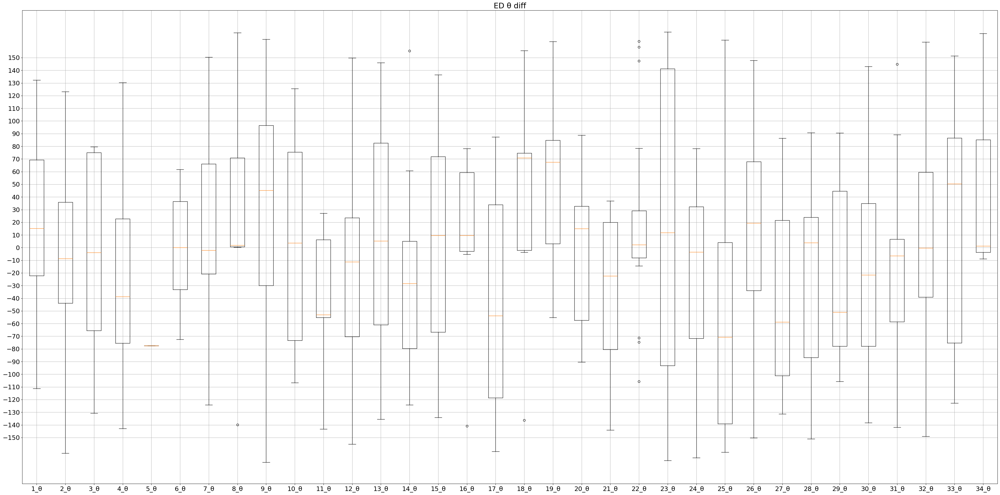

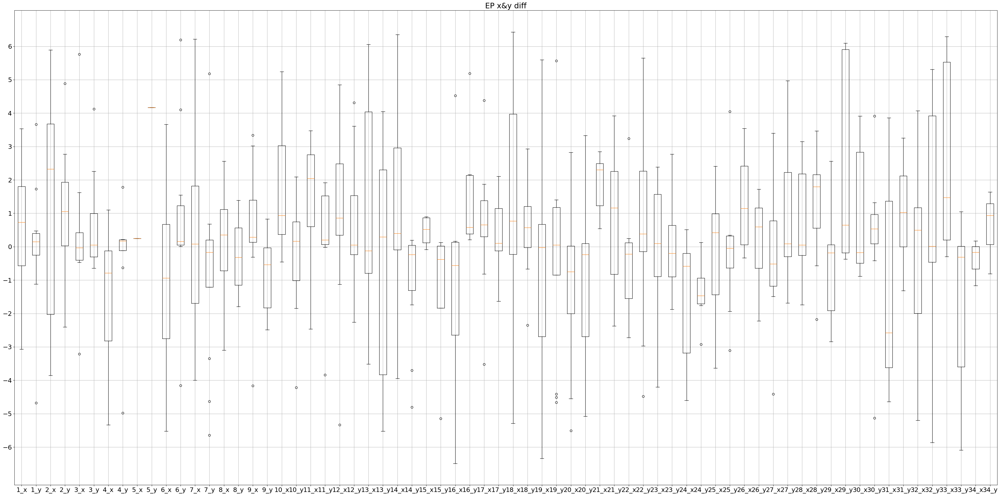

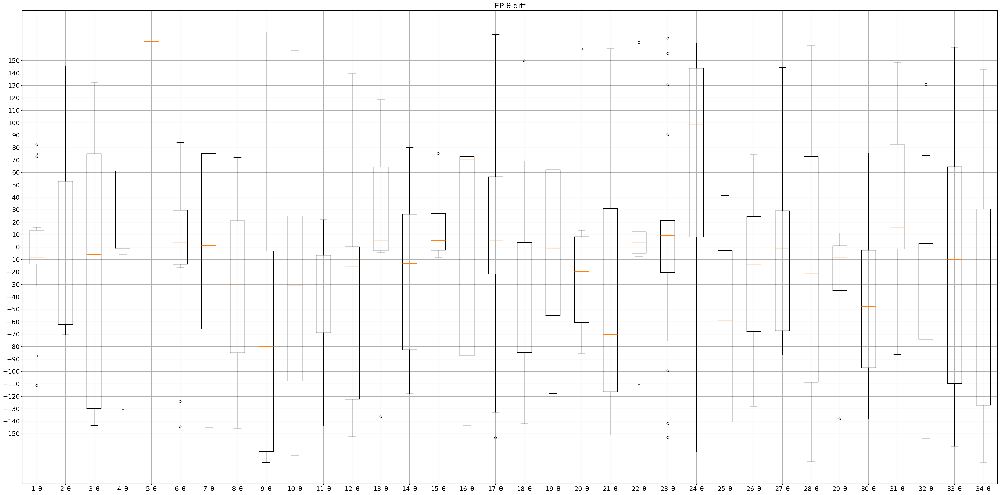

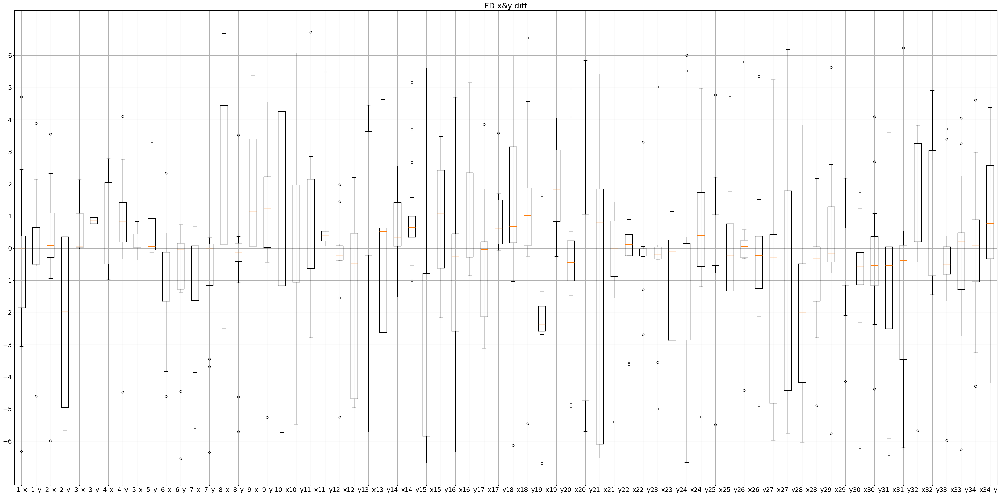

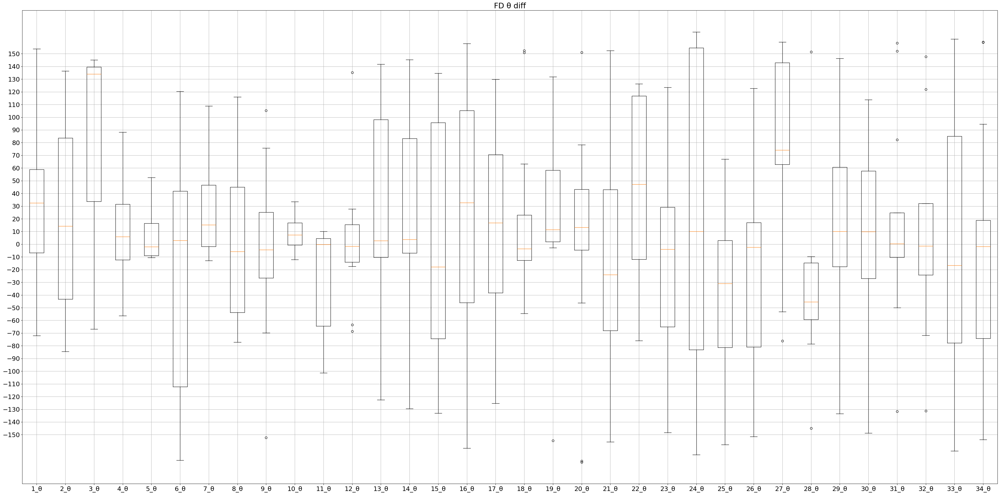

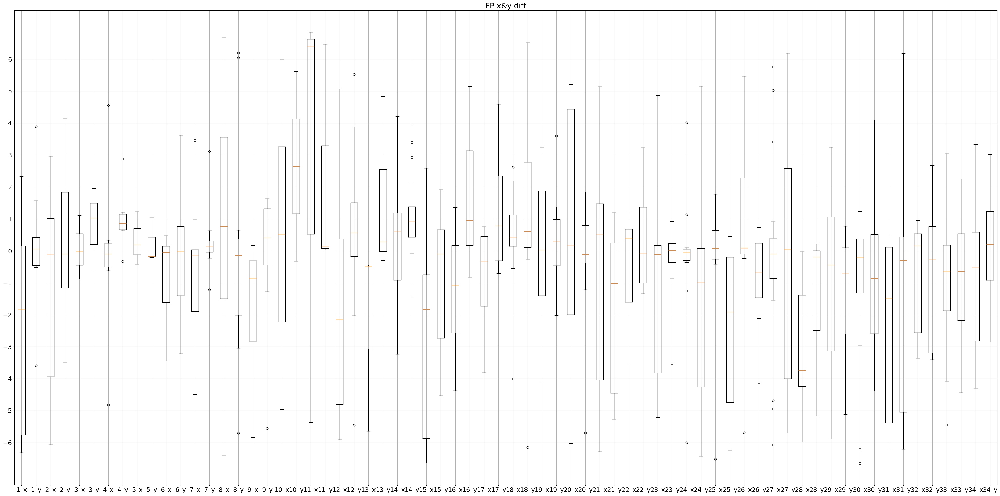

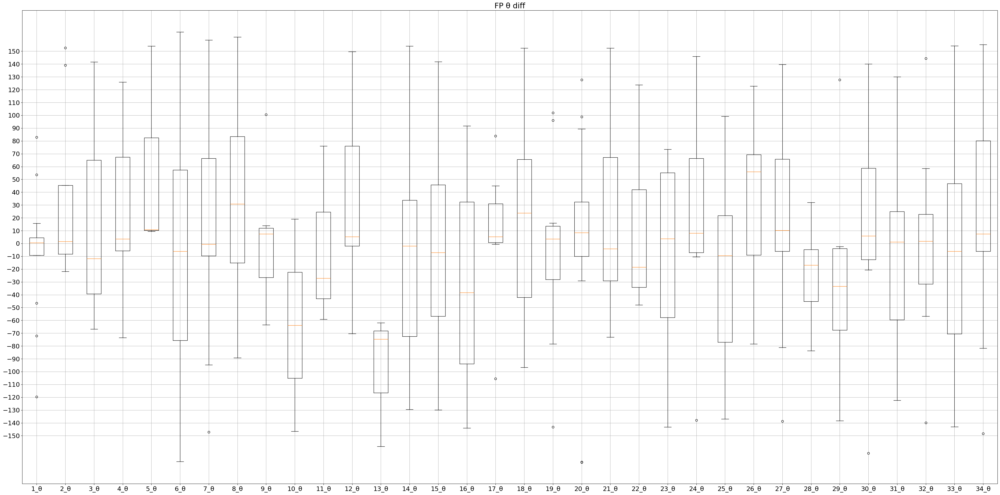

In [ ]:
fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
ax.boxplot(ED_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('ED x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(ED_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('ED θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(EP_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('EP x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(EP_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('EP θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FD_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('FD x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FD_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('FD θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FP_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('FP x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FP_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('FP θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

# テスト

In [ ]:
x_ED_gesture = {}
y_ED_gesture = {}
theta_ED_gesture = {}
x_EP_gesture = {}
y_EP_gesture = {}
theta_EP_gesture = {}
x_FD_gesture = {}
y_FD_gesture = {}
theta_FD_gesture = {}
x_FP_gesture = {}
y_FP_gesture = {}
theta_FP_gesture = {}
n_gestures = 34
for i in range(n_gestures):
    x_ED_gesture[i+1] = []
    y_ED_gesture[i+1] = []
    theta_ED_gesture[i+1] = []
    x_EP_gesture[i+1] = []
    y_EP_gesture[i+1] = []
    theta_EP_gesture[i+1] = []
    x_FD_gesture[i+1] = []
    y_FD_gesture[i+1] = []
    theta_FD_gesture[i+1] = []
    x_FP_gesture[i+1] = []
    y_FP_gesture[i+1] = []
    theta_FP_gesture[i+1] = []

In [ ]:
for diff_list in distances:
    print(diff_list)
    if diff_list['result_distance'] != [None]:
        gesture = diff_list['gesture']
        electrode_place = diff_list['electrode_place']
        if electrode_place == 'ED':
            for diff in diff_list['result_distance']:
                x_ED_gesture[gesture].append(diff['x_distance'])
                y_ED_gesture[gesture].append(diff['y_distance'])
                theta_ED_gesture[gesture].append(diff['theta_distance'])
        elif electrode_place == 'EP':
            for diff in diff_list['result_distance']:
                x_EP_gesture[gesture].append(diff['x_distance'])
                y_EP_gesture[gesture].append(diff['y_distance'])
                theta_EP_gesture[gesture].append(diff['theta_distance'])
        elif electrode_place == 'FD':
            for diff in diff_list['result_distance']:
                x_FD_gesture[gesture].append(diff['x_distance'])
                y_FD_gesture[gesture].append(diff['y_distance'])
                theta_FD_gesture[gesture].append(diff['theta_distance'])
        elif electrode_place == 'FP':
            for diff in diff_list['result_distance']:
                x_FP_gesture[gesture].append(diff['x_distance'])
                y_FP_gesture[gesture].append(diff['y_distance'])
                theta_FP_gesture[gesture].append(diff['theta_distance'])

{'subject': 1, 'gesture': 1, 'trial': 1, 'electrode_place': 'ED', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 20, 'x_distance': 0.6355043368060231, 'y_distance': 0.2968244295037339, 'theta_distance': 126.80880311567324}, {'session1_cluster': 1, 'session2_cluster': 20, 'x_distance': 0.8046718794426484, 'y_distance': 0.20238527097442738, 'theta_distance': 6.995579169369314}, {'session1_cluster': 2, 'session2_cluster': 20, 'x_distance': 0.34048013321548076, 'y_distance': 0.3659353932278293, 'theta_distance': -18.365583335385004}, {'session1_cluster': 30, 'session2_cluster': 10, 'x_distance': -0.02485568984674824, 'y_distance': -0.05747863767190342, 'theta_distance': 9.093665741959128}]}
{'subject': 1, 'gesture': 1, 'trial': 1, 'electrode_place': 'EP', 'result_distance': [{'session1_cluster': 20, 'session2_cluster': 31, 'x_distance': 1.3986981499463313, 'y_distance': -3.0642257542032985, 'theta_distance': -72.11244356834571}, {'session1_cluster': 30, 'session2_cluster':

In [ ]:
ED_xy_list = []
EP_xy_list = []
FD_xy_list = []
FP_xy_list = []
for i in range(n_gestures):
    ED_xy_list.append(x_ED_gesture[i+1])
    ED_xy_list.append(y_ED_gesture[i+1])
    # ED_list.append(theta_ED_gesture[i+1])
for i in range(n_gestures):
    EP_xy_list.append(x_EP_gesture[i+1])
    EP_xy_list.append(y_EP_gesture[i+1])
    # EP_list.append(theta_EP_gesture[i+1])
for i in range(n_gestures):
    FD_xy_list.append(x_FD_gesture[i+1])
    FD_xy_list.append(y_FD_gesture[i+1])
    # FD_list.append(theta_FD_gesture[i+1])
for i in range(n_gestures):
    FP_xy_list.append(x_FP_gesture[i+1])
    FP_xy_list.append(y_FP_gesture[i+1])
    # FP_list.append(theta_FP_gesture[i+1])

ED_theta_list = []
EP_theta_list = []
FD_theta_list = []
FP_theta_list = []
for i in range(n_gestures):
    ED_theta_list.append(theta_ED_gesture[i+1])
for i in range(n_gestures):
    EP_theta_list.append(theta_EP_gesture[i+1])
for i in range(n_gestures):
    FD_theta_list.append(theta_FD_gesture[i+1])
for i in range(n_gestures):
    FP_theta_list.append(theta_FP_gesture[i+1])


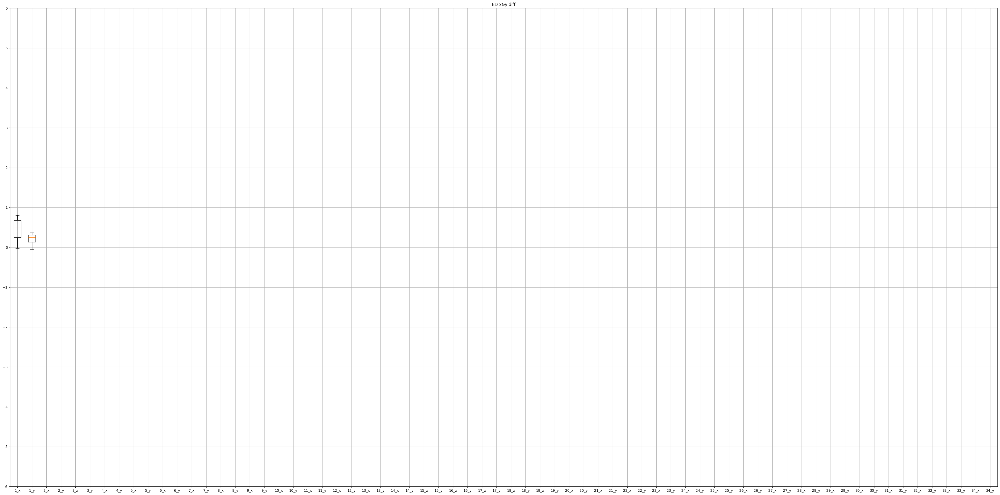

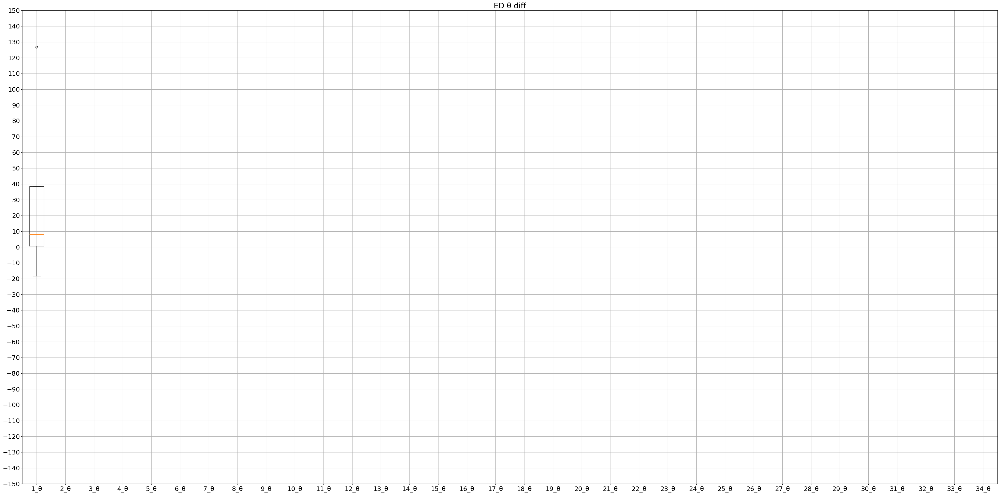

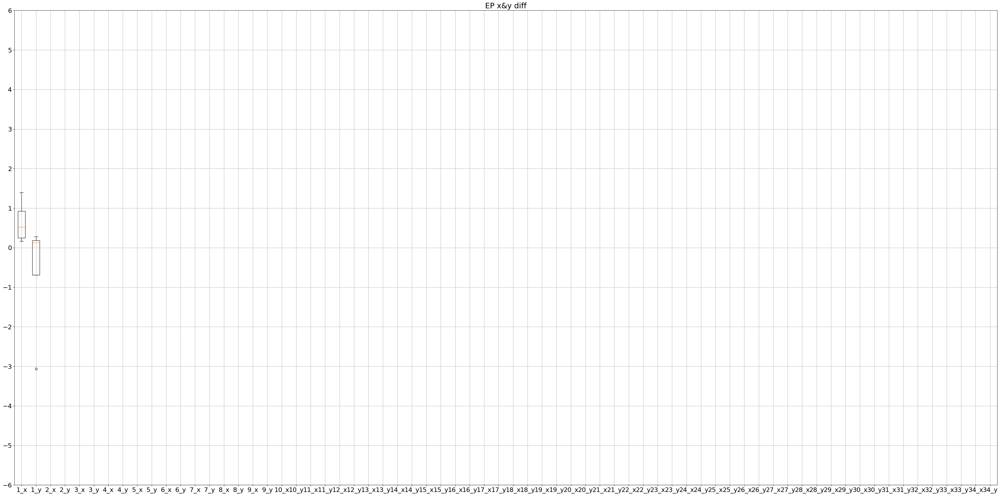

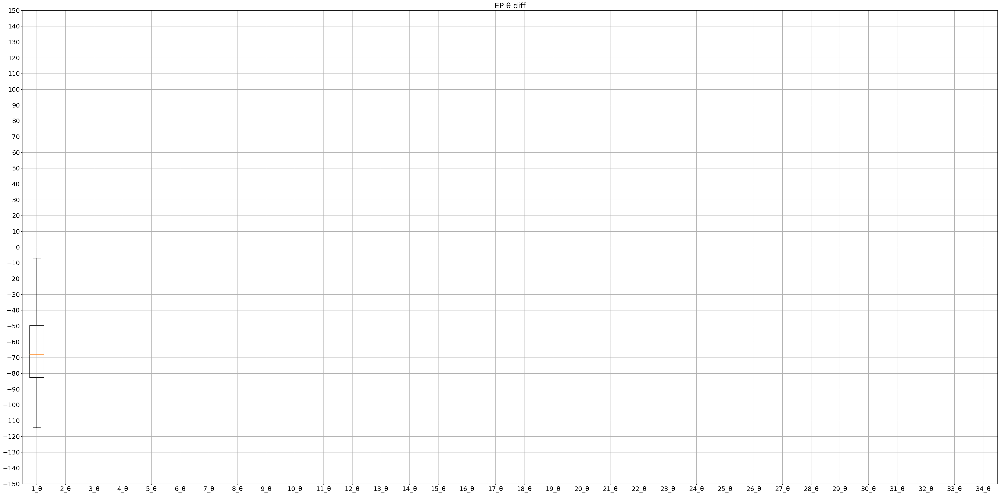

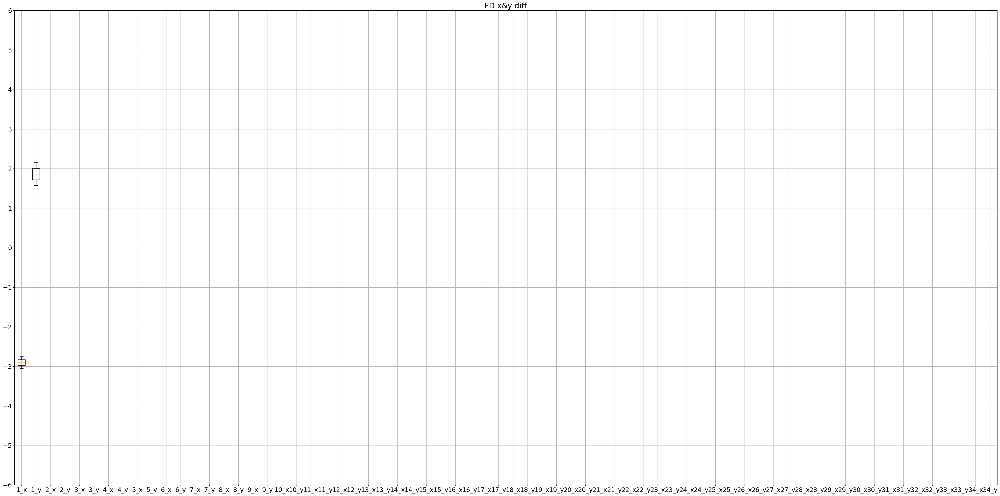

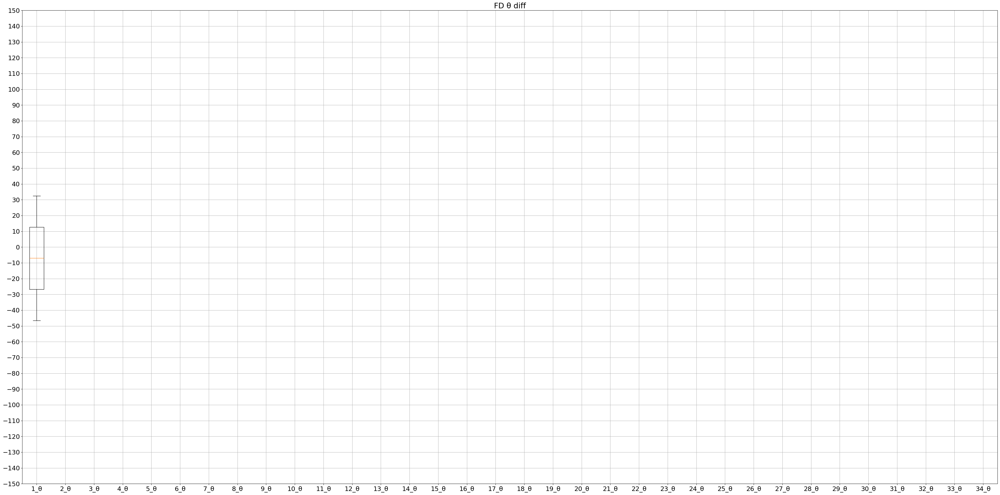

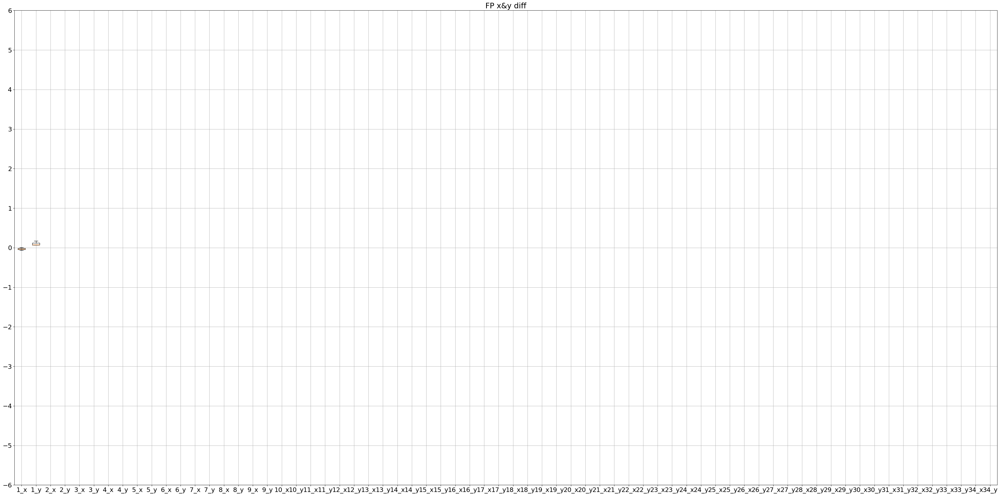

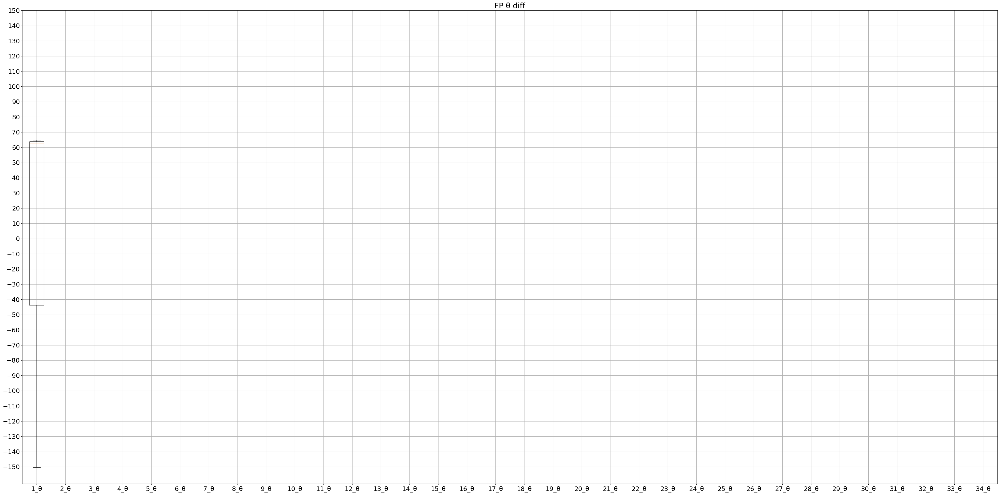

In [ ]:
fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
ax.boxplot(ED_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('ED x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(ED_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('ED θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(EP_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('EP x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(EP_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('EP θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FD_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('FD x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FD_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('FD θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FP_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('FP x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FP_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('FP θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

In [ ]:
x_EP_gesture

{1: [3.9834823697861856,
  0.7655725323054208,
  3.10617847342346,
  4.05349287187996,
  0.02115415804537779,
  4.334289507071547,
  -2.0264028596544827,
  0.4968693264360893,
  -5.847779801428611,
  -3.4256882912377815,
  5.088462625187774,
  -2.815297700907411,
  -0.6464783735621789,
  -0.1856303651496478],
 2: [-4.383692196949831,
  4.804497197418508,
  0.7248619611685081,
  -3.791830325561055,
  -0.04234048237382115,
  0.09624850053188716,
  4.345596361753619,
  -2.9286777577151706,
  -5.986402567666984,
  -0.1973619220428227],
 3: [-4.272417083576745,
  -1.4333028944917685,
  -1.710188106816556,
  -3.6334575541587704,
  -1.1952906307007805,
  0.46390829100145536,
  0.6186796978131253,
  0.0863139874856862,
  0.3164866657704213,
  0.2793831342879537,
  -3.0361482531842716,
  -2.659884482496575,
  0.40483640553411027,
  -2.5013905247837376,
  -2.717533002360726],
 4: [-3.44605547402925,
  0.004803654453026773,
  0.22843289959930946,
  0.4934622049706885,
  -3.1976287312558105,
  -3.

In [51]:
record_session1 = wfdb.rdrecord('pr_dataset/subject01_session1/maintenance_preprocess_sample1')
record_session2 = wfdb.rdrecord('pr_dataset/subject01_session2/maintenance_preprocess_sample1')

In [52]:
filtered_emg_ED_session1 = record_session1.p_signal[:,:64] #Extensor Distal
filtered_emg_EP_session1 = record_session1.p_signal[:,64:128] #Extensor Proximal
filtered_emg_FD_session1 = record_session1.p_signal[:,128:192] #Flexor Distal
filtered_emg_FP_session1 = record_session1.p_signal[:,192:256] #Flexor Proximal

filtered_emg_ED_session2 = record_session2.p_signal[:,:64] #Extensor Distal
filtered_emg_EP_session2 = record_session2.p_signal[:,64:128] #Extensor Proximal
filtered_emg_FD_session2 = record_session2.p_signal[:,128:192] #Flexor Distal
filtered_emg_FP_session2 = record_session2.p_signal[:,192:256] #Flexor Proximal

検出されたピーク数（条件を満たすもの）: 645


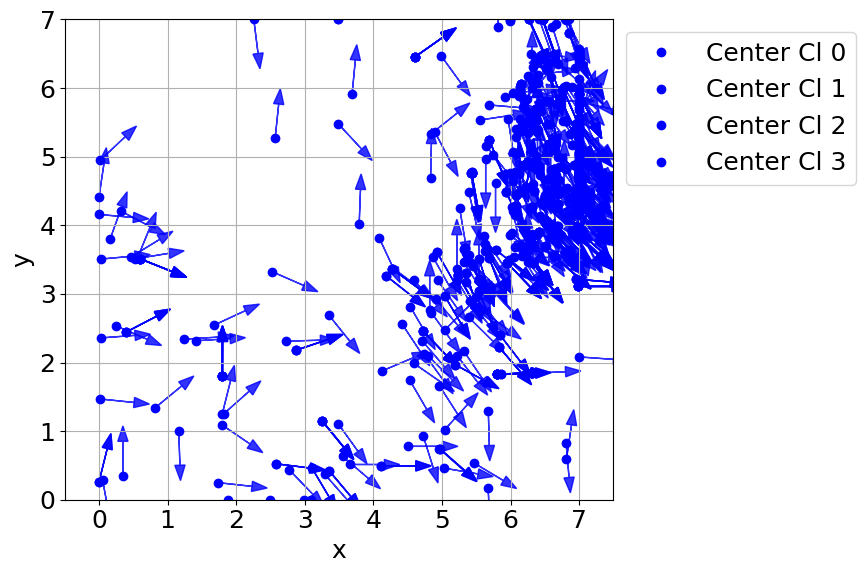

C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


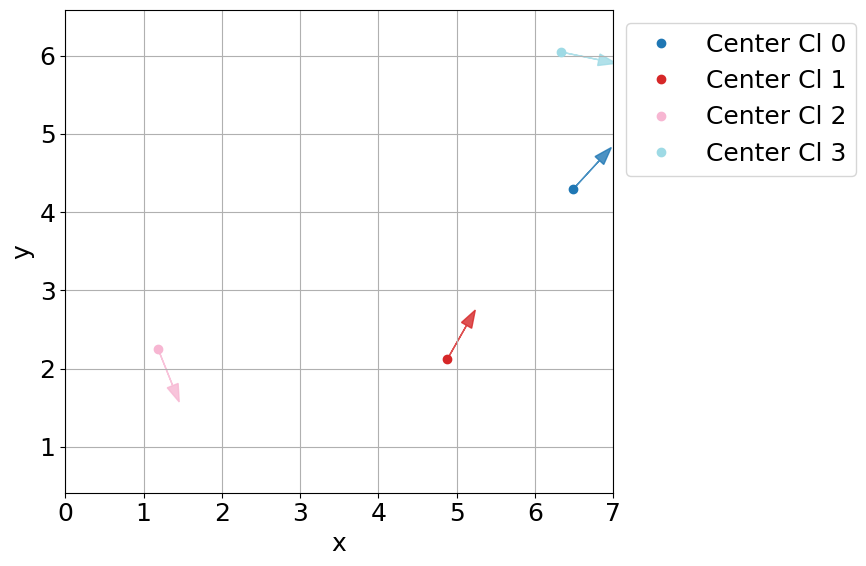

In [68]:
emg_data_session1 = filtered_emg_ED_session1
features_session1 = get_centers_directions(emg_data_session1, gaussian_2d, ptp, fs=2000, window_ms=25, threshold=0)
results_df_session1, summary_df_session1 = clustering(features_session1)
summary_df_session1
plot_fiber(results_df_session1, show_arrow=True, clustered_colar=False)
virtual_bipolars_session1, labels_session1, center_direction_session1, n_virtual_bipolars_session1 = get_virtual_bipolars(results_df_session1, show_plot=True)
virtual_emg_session1 = get_virtual_emg(emg_data_session1, virtual_bipolars_session1)
X_session1, y_session1 = get_features(virtual_emg_session1, labels_session1)

検出されたピーク数（条件を満たすもの）: 649


C:\Users\takeu\AppData\Local\Temp\ipykernel_21384\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


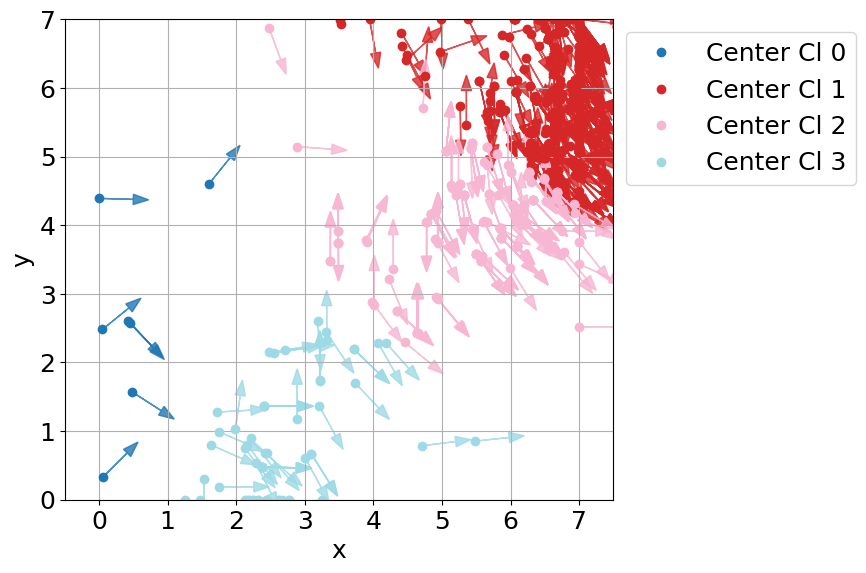

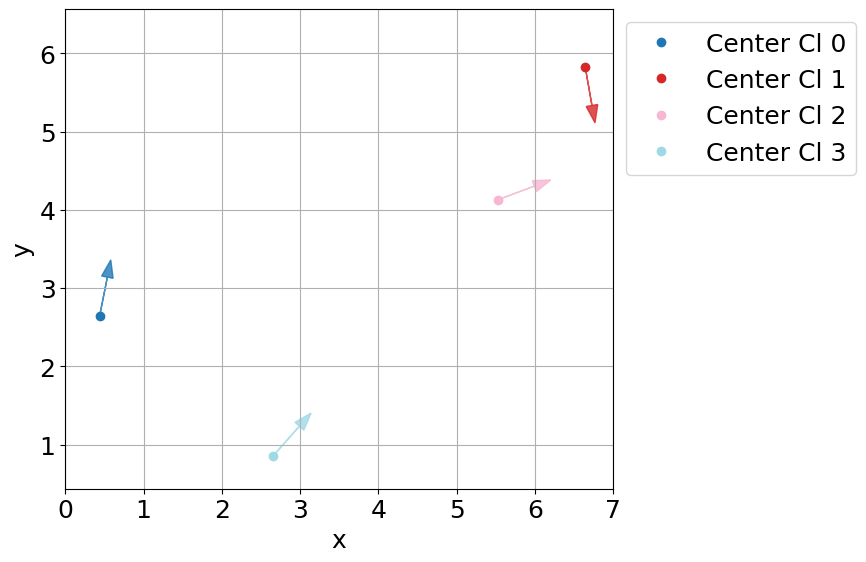

In [64]:
emg_data_session2 = filtered_emg_ED_session2
features_session2 = get_centers_directions(emg_data_session2, gaussian_2d, ptp, fs=2000, window_ms=25, threshold=0)
results_df_session2, summary_df_session2 = clustering(features_session2)
summary_df_session2
plot_fiber(results_df_session2, show_arrow=True)
virtual_bipolars_session2, labels_session2, center_direction_session2, n_virtual_bipolars_session2 = get_virtual_bipolars(results_df_session2, show_plot=True)
virtual_emg_session2 = get_virtual_emg(emg_data_session2, virtual_bipolars_session2)
X_session2, y_session2 = get_features(virtual_emg_session2, labels_session2)

In [78]:
summary_df_session1

,cluster,center_x_mean,center_x_std,center_y_mean,center_y_std,theta_deg_mean,theta_deg_std,count
0,0,2.361250,1.448391,5.684828,1.007741,-3.960422,59.844355,197
1,1,0.851250,0.865256,1.401002,1.045742,6.466178,48.143190,156
2,2,3.652848,0.744558,2.074530,0.867149,-3.777916,48.926484,369
3,3,6.553062,0.633547,1.097766,1.152133,7.543157,39.605468,190


In [79]:
summary_df_session2

,cluster,center_x_mean,center_x_std,center_y_mean,center_y_std,theta_deg_mean,theta_deg_std,count
0,0,3.770566,1.135907,3.136977,1.345237,4.343762,59.554481,189
1,1,1.058827,0.983457,6.100329,0.923219,15.233451,61.776393,90
2,2,6.672332,0.580939,0.225618,0.430205,2.707378,38.558744,164
3,3,1.733610,1.301410,1.148327,0.973036,1.119928,33.921354,166


In [80]:
results_df_session1

,center_x,center_y,theta_deg,direction_cluster
0,3.039990,2.471260,65.327822,2
1,3.039990,2.471260,65.327822,2
2,3.039990,2.471260,65.327822,2
3,3.039990,2.471260,65.327822,2
4,2.852506,2.380179,9.494208,2
...,...,...,...,...
907,6.998351,1.257641,0.269403,3
908,3.321749,1.712844,-11.684924,2
909,3.185120,1.579479,-18.192005,2
910,3.185586,1.580212,-18.081765,2


In [106]:
sub_df = results_df_session1[results_df_session1['direction_cluster'] == 2]
# sub_df
X= sub_df[['center_x','center_y']].to_numpy()
X = X - X.mean(axis=0)
pca = PCA(n_components=1)
pca.fit(X)
# print(pca.components_[0])
eigen_x = pca.components_[0][0]
eigen_y = pca.components_[0][1]
theta = np.arctan2(eigen_y, eigen_x)
print(f'PCA x: {eigen_x}, PCA y: {eigen_y}')
print(f'PCA theta: {np.degrees(theta)}')

PCA x: -0.3707902485386502, PCA y: 0.9287166368643592
PCA theta: 111.76436220859658


In [89]:
np.arctan2(1,1)

0.7853981633974483

C:\Users\takeu\AppData\Local\Temp\ipykernel_8344\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


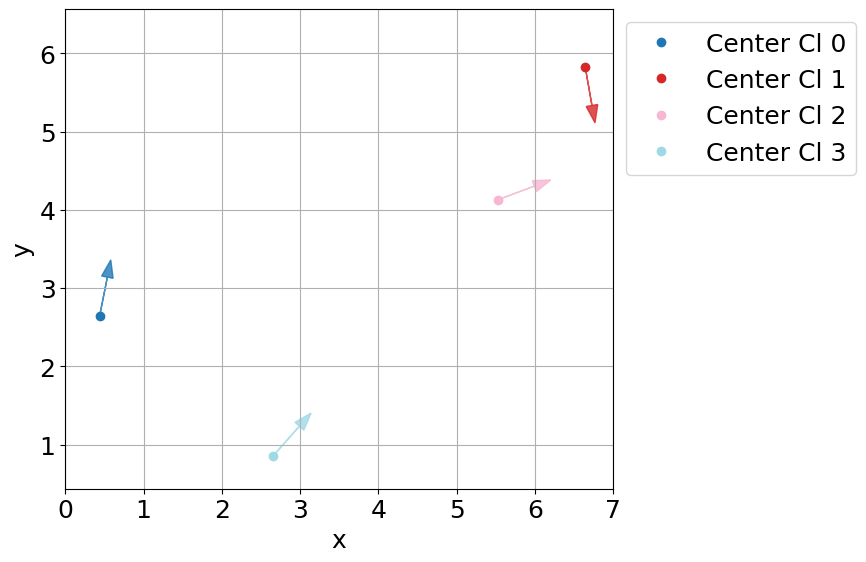

In [147]:
# def get_virtual_bipolars(results_df, ied=2, arrow_scale=0.5):
#仮想双極電極の電極間距離（cm）
results_df = results_df_session2
arrow_scale = 0.5 # 矢印の長さを調整するスケール
ied = 2
a = ied

n_clusters = results_df['direction_cluster'].nunique() #
cluster_colors = get_cluster_colors(n_clusters) #

virtual_bipolars = []
labels = []
center_direction = []
n_virtual_bipolars_checker = []
plt.figure(figsize=(9, 6)) #
for n, direction_cluster in enumerate(sorted(results_df['direction_cluster'].unique())):
  sub_df = results_df[results_df['direction_cluster'] == direction_cluster]
  # if sub_df['center_cluster'].count() >= 20 and sub_df['center_x'].std() < 1 and sub_df['center_y'].std() < 1 and sub_df['theta_deg'].std() < 20:
  X= sub_df[['center_x','center_y']].to_numpy()
  X = X - X.mean(axis=0)
  pca = PCA(n_components=1)
  pca.fit(X)
  # print(pca.components_[0])
  eigen_x = pca.components_[0][0]
  eigen_y = pca.components_[0][1]
  if eigen_x < 0:
    eigen_x = -eigen_x
    eigen_y = -eigen_y
  elif eigen_x == 0:
    eigen_y = abs(eigen_y)
  theta = np.degrees(np.arctan2(eigen_y, eigen_x))
  # print(np.degrees(theta))
  x, y = sub_df['center_x'].mean(), sub_df['center_y'].mean()

  dx, dy = np.cos(np.radians(theta)) * arrow_scale, np.sin(np.radians(theta)) * arrow_scale #
  # print(f'cluster:{direction_cluster}, x={x}, y={y}, θ={theta}')
  x1 = x - a/2*np.cos(np.radians(theta))
  y1 = y - a/2*np.sin(np.radians(theta))
  x2 = x + a/2*np.cos(np.radians(theta))
  y2 = y + a/2*np.sin(np.radians(theta))
  virtual_bipolars.append([x1, y1, x2, y2])
  labels.append(direction_cluster)
  center_direction.append([x, y, theta])
  n_virtual_bipolars_checker.append(True)
  # 色で中心クラスタを、マーカーサイズで方向クラスタを示す
  color = cluster_colors[n]
  plt.arrow(x, y, dx, dy, head_width=0.15, color=color, alpha=0.8)
  plt.plot(x, y, 'o', color=color,
            label=f"Center Cl {direction_cluster}" if f"Center Cl {direction_cluster}" not in plt.gca().get_legend_handles_labels()[1] else "")
# if len(n_virtual_bipolars_checker) == 1:
#   virtual_bipolars.append([0,0,0,0])
#   labels.append(999)
#   center_direction.append([0,0,0])
plt.xlabel("x")
plt.ylabel("y")
# plt.title("2-Stage Clustering of Muscle Fiber Direction")
plt.grid(True)
plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
plt.axis('equal')
plt.tight_layout()
plt.xlim(0, 7)
plt.ylim(0, 7)
plt.xticks(np.arange(0, 8, 1))
plt.yticks(np.arange(0, 8, 1))
plt.show()

  # return virtual_bipolars, labels, center_direction, len(n_virtual_bipolars_checker)

In [ ]:
ied = 2
results_df = results_df_session1
#仮想双極電極の電極間距離（cm）
a = ied

n_clusters = results_df['direction_cluster'].nunique()
cluster_colors = get_cluster_colors(n_clusters)

virtual_bipolars = []
labels = []
center_direction = []
for n, direction_cluster in enumerate(sorted(results_df['direction_cluster'].unique())):
  sub_df = results_df[results_df['direction_cluster'] == direction_cluster]
  if sub_df['center_cluster'].count() >= 20 and sub_df['center_x'].std() < 1 and sub_df['center_y'].std() < 1 and sub_df['theta_deg'].std() < 20:
    x, y = sub_df['center_x'].mean(), sub_df['center_y'].mean()
    theta = sub_df['theta_deg'].mean()
    dx, dy = np.cos(np.radians(theta)) * arrow_scale, np.sin(np.radians(theta)) * arrow_scale
    print(f'cluster:{direction_cluster}, x={x}, y={y}, θ={theta}')
    x1 = x - a/2*np.cos(np.radians(theta))
    y1 = y - a/2*np.sin(np.radians(theta))
    x2 = x + a/2*np.cos(np.radians(theta))
    y2 = y + a/2*np.sin(np.radians(theta))
    virtual_bipolars.append([x1, y1, x2, y2])
    labels.append(direction_cluster)
    center_direction.append([x, y, theta])
    # 色で中心クラスタを、マーカーサイズで方向クラスタを示す
    color = cluster_colors[n]
    plt.arrow(x, y, dx, dy, head_width=0.15, color=color, alpha=0.8)
    plt.plot(x, y, 'o', color=color,
              label=f"Center Cl {direction_cluster}" if f"Center Cl {direction_cluster}" not in plt.gca().get_legend_handles_labels()[1] else "")
# ラベル・軸
plt.xlabel("center_x")
plt.ylabel("center_y")
plt.title("2-Stage Clustering of Muscle Fiber Direction")
plt.grid(True)
plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
plt.axis('equal')
plt.tight_layout()
plt.xlim(0, 7)
plt.ylim(0, 7)
plt.show()

print(len(virtual_bipolars))
# return virtual_bipolars, labels, center_direction

In [ ]:
#分類器
# from sklearn.model_selection import train_test_split
# from sklearn.svm import SVC
# from sklearn.metrics import classification_report, confusion_matrix

X_train = np.array(X_session1).reshape(-1,1)
y_train = np.array(y_session1).reshape(-1,1)
X_test = np.array(X_session2).reshape(-1,1)
y_test = np.array(y_session2).reshape(-1,1)

# データ分割
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# SVMモデル学習
model = SVC(kernel='rbf', probability=True, random_state=0)
model.fit(X_train, y_train)

prob_matrix = model.predict_proba(X_test) # shape: (n_test_samples, n_train_classes)
# === 各テストラベルごとに学習クラスへの平均確率を出力 ===
class_labels = model.classes_  # 学習クラス（例: [0, 1, 2]）

result = []

for test_label in np.unique(y_test):
    idx = y_test.reshape(-1) == test_label
    mean_prob = np.mean(prob_matrix[idx], axis=0)  # 学習クラスへの平均確率
    result.append([test_label] + list(mean_prob))

# === 表形式で表示 ===
columns = ['Test Label'] + [f"P(Train={cls})" for cls in class_labels]
df_result = pd.DataFrame(result, columns=columns)

# import seaborn as sns
# import matplotlib.pyplot as plt

print(df_result)

In [ ]:
max_train_idx = []
for i in range(np.array(result).shape[0]):
j = np.argmax(np.array(result)[i,1:])
max_train_idx.append(j)
# print(max_train_idx)
for k in set(max_train_idx):
if max_train_idx.count(k) >=2:
    idx = max_train_idx == k
    l = np.argmax(np.array(result)[idx, k+1], axis=0)
    max_test_idx = [i for i, j in enumerate(idx) if j == True]
    print(f'result[{max_test_idx[l]},{k+1}], train:{np.unique(y_train)[k]}, test:{np.unique(y_test)[max_test_idx[l]]}')
    center_x_diff, center_y_diff, theta_diff = calc_diff(k, max_test_idx[l], center_direction_session1, center_direction_session2)
    print(f'x_diff={center_x_diff}, y_diff={center_y_diff}, theta_diff={theta_diff}')
else:
    print(f'result[{max_train_idx.index(k)},{k+1}], train:{np.unique(y_train)[k]}, test:{np.unique(y_test)[max_train_idx.index(k)]}')
    center_x_diff, center_y_diff, theta_diff = calc_diff(k, max_train_idx.index(k), center_direction_session1, center_direction_session2)
    print(f'x_diff={center_x_diff}, y_diff={center_y_diff}, theta_diff={theta_diff}')

In [ ]:
n_subjects = 20
n_gestures = 34
n_trials = 2

for i in range(n_subjects):
    for j in range(n_gestures):
        print('pr_dataset/subject{:02}'.format(i+1) + '_session1/maintenance_preprocess_sample'+str((j+1)*2-1))
        print('pr_dataset/subject{:02}'.format(i+1) + '_session1/maintenance_preprocess_sample'+str((j+1)*2))
        print('pr_dataset/subject{:02}'.format(i+1) + '_session2/maintenance_preprocess_sample'+str((j+1)*2-1))
        print('pr_dataset/subject{:02}'.format(i+1) + '_session2/maintenance_preprocess_sample'+str((j+1)*2))

pr_dataset/subject01_session1/maintenance_preprocess_sample1
pr_dataset/subject01_session1/maintenance_preprocess_sample2
pr_dataset/subject01_session2/maintenance_preprocess_sample1
pr_dataset/subject01_session2/maintenance_preprocess_sample2
pr_dataset/subject01_session1/maintenance_preprocess_sample3
pr_dataset/subject01_session1/maintenance_preprocess_sample4
pr_dataset/subject01_session2/maintenance_preprocess_sample3
pr_dataset/subject01_session2/maintenance_preprocess_sample4
pr_dataset/subject01_session1/maintenance_preprocess_sample5
pr_dataset/subject01_session1/maintenance_preprocess_sample6
pr_dataset/subject01_session2/maintenance_preprocess_sample5
pr_dataset/subject01_session2/maintenance_preprocess_sample6
pr_dataset/subject01_session1/maintenance_preprocess_sample7
pr_dataset/subject01_session1/maintenance_preprocess_sample8
pr_dataset/subject01_session2/maintenance_preprocess_sample7
pr_dataset/subject01_session2/maintenance_preprocess_sample8
pr_dataset/subject01_ses

In [ ]:
n_subjects = 20
n_gestures = 34
n_trials = 2

for i in range(n_subjects):
    for j in range(n_gestures):
        for k in range(n_trials):
            print('pr_dataset/subject{:02}'.format(i+1) + '_session1/maintenance_preprocess_sample'+str((j+1)*2+(k-1)))
            print('pr_dataset/subject{:02}'.format(i+1) + '_session2/maintenance_preprocess_sample'+str((j+1)*2+(k-1)))

pr_dataset/subject01_session1/maintenance_preprocess_sample1
pr_dataset/subject01_session2/maintenance_preprocess_sample1
pr_dataset/subject01_session1/maintenance_preprocess_sample2
pr_dataset/subject01_session2/maintenance_preprocess_sample2
pr_dataset/subject01_session1/maintenance_preprocess_sample3
pr_dataset/subject01_session2/maintenance_preprocess_sample3
pr_dataset/subject01_session1/maintenance_preprocess_sample4
pr_dataset/subject01_session2/maintenance_preprocess_sample4
pr_dataset/subject01_session1/maintenance_preprocess_sample5
pr_dataset/subject01_session2/maintenance_preprocess_sample5
pr_dataset/subject01_session1/maintenance_preprocess_sample6
pr_dataset/subject01_session2/maintenance_preprocess_sample6
pr_dataset/subject01_session1/maintenance_preprocess_sample7
pr_dataset/subject01_session2/maintenance_preprocess_sample7
pr_dataset/subject01_session1/maintenance_preprocess_sample8
pr_dataset/subject01_session2/maintenance_preprocess_sample8
pr_dataset/subject01_ses

In [ ]:
if n_virtual_bipolars_session1 >= 1 and n_virtual_bipolars_session2 >= 1:
    result, y_train, y_test = SVC_classifier(X_session1, y_session1, X_session2, y_session2)
    diff = diff_analyzer(result, y_train, y_test, center_direction_session1, center_direction_session2)
else:
    diff = [None]

In [ ]:
diff

[None]

In [ ]:
n_virtual_bipolars_session2

0

In [ ]:
diffs

[{'diff': [{'train': 0,
    'test': 30,
    'x_diff': 3.8259491881339103,
    'y_diff': 3.593425777750928,
    'theta_diff': 132.32900987559782},
   {'train': 30,
    'test': 10,
    'x_diff': -0.02485568984674824,
    'y_diff': -0.05747863767190342,
    'theta_diff': 9.093665741959128}],
  'file_name': ['pr_dataset/subject01_session1/maintenance_preprocess_sample1',
   'pr_dataset/subject01_session2/maintenance_preprocess_sample1'],
  'electrode_place': 'ED'},
 {'diff': [{'train': 20,
    'test': 21,
    'x_diff': 3.9834823697861856,
    'y_diff': 2.5134437058997183,
    'theta_diff': -8.075040434084851},
   {'train': 30,
    'test': 31,
    'x_diff': 0.7655725323054208,
    'y_diff': 0.15258456651748098,
    'theta_diff': -6.914685794504898},
   {'train': 32,
    'test': 11,
    'x_diff': 3.10617847342346,
    'y_diff': 1.6273900614522736,
    'theta_diff': 14.760163601038961}],
  'file_name': ['pr_dataset/subject01_session1/maintenance_preprocess_sample1',
   'pr_dataset/subject01_s